# 1. Librerías

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import math

In [42]:
from keras.models import Sequential
from keras.layers import Conv1D, MaxPooling1D, Flatten, Dense, Dropout, LSTM
from keras.callbacks import EarlyStopping
from keras.optimizers import Adam
import keras_tuner as kt

# 2. Lectura de los datos

In [3]:
# Cragar datos
df_demanda = pd.read_csv('./data/demanda_region.csv')

In [4]:
# Mercados de comercializacion en el dataframe
df_demanda['Values_code'].unique()

array(['ANTIOQUIA', 'ARAUCA', 'BAJO PUTUMAYO', 'BOGOTA - CUNDINAMARCA',
       'BOYACA', 'CALDAS', 'CALI - YUMBO - PUERTO TEJADA', 'CAQUETA',
       'CARIBE MAR', 'CARIBE SOL', 'CARTAGO', 'CASANARE', 'CAUCA',
       'CHOCO', 'GUAVIARE', 'HUILA', 'META', 'NARIÑO',
       'NORTE DE SANTANDER', 'PEREIRA', 'POPAYAN - PURACE', 'PUTUMAYO',
       'QUINDIO', 'RUITOQUE', 'SANTANDER', 'TOLIMA', 'TULUA',
       'VALLE DEL CAUCA', 'VALLE DEL SIBUNDOY', 'SIN CLASIFICAR'],
      dtype=object)

## 2.1. Funciones para modificar los datos

In [1]:
# Función para modificar el dataframe base, agregando la información de días festivos y filtrado de información hasta una fecha específica
def df_ciudad(df, df_festivos, ciudad, fecha):
    df_final = df[df['Values_code'] == ciudad]
    df_final = df_final.drop(columns=['Id', 'Values_code', 'Values_MarketType'])
    df_final['Date'] = pd.to_datetime(df_final['Date'])
    horas = [f'Values_Hour{i:02d}' for i in range(1, 25)]
    df_final['Total'] = df_final[horas].sum(axis=1)
    df_final = df_final.drop(columns=horas)
    df_final = df_final.groupby('Date').sum()
    df_final = df_final.reset_index()
    df_final = df_final.sort_values('Date')
    df_final = df_final.reset_index(drop=True)
    df_final = df_final[df_final['Date'] <= fecha]
    df_final = pd.merge(df_final, df_festivos, on='Date', how='left')
    df_final['Dia'] = df_final['Date'].apply(lambda x: x.weekday())
    return df_final

In [2]:
# Función para crear matriz donde se agrupe la información del día, como el valor de la cantidad de demnanda, día de la semana y si es festivo o no, en un rango de tiempo definido.
def crear_matriz_modelo(df, ventana_entrada=60, ventana_salida=30):
    # Crear una lista para almacenar cada fila de la matriz final
    matriz_final = []
    
    ventana_total = ventana_entrada + ventana_salida
    # Iteramos sobre el DataFrame para extraer ventanas de 60 días
    for i in range(len(df) - ventana_total - 1):
        # Extraemos una ventana de 60 días
        ventana = df.iloc[i:i+ventana_total]
        
        # Reorganizamos la ventana en una sola fila con sufijos para cada día
        fila = {}
        for j in range(ventana_entrada):
            fila[f'fe-{j+1}'] = ventana.iloc[j]['Festivo']
            fila[f'd-{j+1}'] = ventana.iloc[j]['Dia']
            fila[f't-{j+1}'] = ventana.iloc[j]['Total']
        for t in range(ventana_entrada, ventana_total):
            fila[f'fe-{t+1}'] = ventana.iloc[t]['Festivo']
            fila[f'd-{t+1}'] = ventana.iloc[t]['Dia']
            fila[f'r-{t+1-ventana_entrada}'] = ventana.iloc[t]['Total']
        
        # Añadimos la fila al conjunto de la matriz final
        matriz_final.append(fila)
    
    # Convertimos la lista de filas en un DataFrame final
    matriz_dias_df = pd.DataFrame(matriz_final)
    
    return matriz_dias_df

In [3]:
# Función para graficar los resultados de los entrenamientos de los modelos ejecutados
def plot_by_interval(real_values, predicted_values, title, color_real, color_pred, max_plots=10):
    days_interval = 30
    num_plots = min(len(real_values) // days_interval + 1, max_plots)

    fig, axes = plt.subplots(num_plots, 1, figsize=(14, 6 * num_plots))

    if num_plots == 1:
        axes = [axes]

    real_values = real_values.values

    for i in range(num_plots):
        x_values = list(range(1, days_interval + 1))
        x_values_strings = [str(x) for x in x_values]
        axes[i].plot(x_values_strings, real_values[i], color=color_real, label='Real')
        axes[i].plot(x_values_strings, predicted_values[i], color=color_pred, label='Predicción')

        # Configuración de cada subgráfico
        axes[i].set_title(f'{title} - Intervalo {i + 1}')
        axes[i].set_xlabel('Días')
        axes[i].set_ylabel('Valores')
        axes[i].legend()

    # Ajustar la disposición de los subgráficos
    plt.show()

In [4]:
from datetime import datetime, timedelta
import requests

# Función para obtener los días festivos desde Nager.Date API

def obtener_festivos(colombia, anio):
    url = f"https://date.nager.at/api/v3/publicholidays/{anio}/{colombia}"
    
    response = requests.get(url)
    if response.status_code == 200:
        festivos = response.json()
        # Extraer solo las fechas de los festivos
        return [festivo['date'] for festivo in festivos]
    else:
        print(f"Error al obtener festivos para el año {anio}, código de estado {response.status_code}")
        return []

## 2.2. Pre procesamiento de datos

In [ ]:
# Crear un rango de fechas desde 2021 hasta septiembre de 2024
fecha_inicio = datetime(2021, 1, 1)
fecha_fin = datetime(2024, 9, 30)

# Crear una lista con todas las fechas en ese rango
fechas = pd.date_range(start=fecha_inicio, end=fecha_fin)

# Obtener los días festivos para cada año de 2021 a 2024
festivos_colombia = []
for anio in range(2021, 2025):
    festivos_colombia.extend(obtener_festivos('CO', anio))

# Convertir las fechas de festivos a formato datetime
festivos_colombia = [datetime.strptime(festivo, "%Y-%m-%d").date() for festivo in festivos_colombia]

# Función para clasificar los días
def clasificar_dia(fecha):
    if fecha in festivos_colombia:
        return 1
    else:
        return 0

# Crear un DataFrame con las fechas y la clasificación
datos = pd.DataFrame({'Date': fechas})
datos['Festivo'] = datos['Date'].apply(lambda x: clasificar_dia(x.date()))

# Guardar la lista en un archivo CSV
datos.to_csv("./data/festivos.csv", index=False)

In [9]:
# Leer csv de festivos
df_festivos = pd.read_csv('./data/festivos.csv')
df_festivos['Date'] = pd.to_datetime(df_festivos['Date'])

In [14]:
df_demanda.fillna(0, inplace=True)                          # Llenar los valores vacíos con 0, asumiendo que no hubo consumo
horas = [f'Values_Hour{i:02d}' for i in range(1, 25)]       # Generar el arreglo Horas para hacer el filtro posterior en el dataset
df_demanda['Total'] = df_demanda[horas].sum(axis=1)         # Crear la columna Total, con la suma del consumo de todas las horas del día
grouped_data = df_demanda.groupby('Values_code')['Total'].sum().reset_index()       # Agrupar la demanda por mercado de comercialización (Región) dado que en el dataset original viene en dos formatos (Mercado Regulado y No Regulado) 
top_ciudades = grouped_data.sort_values(by='Total', ascending=False)['Values_code'].tolist()       # Conocer la lista en orden del consumo de las regiones para organizar la generación de los modelos

In [15]:
top_ciudades

['BOGOTA - CUNDINAMARCA',
 'CARIBE MAR',
 'ANTIOQUIA',
 'CARIBE SOL',
 'CALI - YUMBO - PUERTO TEJADA',
 'SANTANDER',
 'BOYACA',
 'VALLE DEL CAUCA',
 'META',
 'NORTE DE SANTANDER',
 'CALDAS',
 'TOLIMA',
 'HUILA',
 'CAUCA',
 'ARAUCA',
 'NARIÑO',
 'PEREIRA',
 'CASANARE',
 'QUINDIO',
 'CAQUETA',
 'CHOCO',
 'TULUA',
 'CARTAGO',
 'PUTUMAYO',
 'BAJO PUTUMAYO',
 'GUAVIARE',
 'RUITOQUE',
 'VALLE DEL SIBUNDOY',
 'POPAYAN - PURACE',
 'SIN CLASIFICAR']

In [16]:
df_demanda_ciudades = {}            # Arreglo vacío para guardar los datasets individuales por región
fecha = '2024-09-30'                # Fecha de filtrado de la información, se define dado que al momento de realizar los modelos era el último mes con información completa en la API de XM
for i in top_ciudades:
    j = top_ciudades.index(i)
    df_demanda_ciudades[i] = df_ciudad(df_demanda, df_festivos, top_ciudades[j], fecha)        # Generación del arreglo con los datasets de las regiones, el apuntador es el nombre de la región, no un número en algún orden

In [28]:
matriz_modelo = {}                  # Arreglo vació para guardar las matrices de cada región para el modelo
for i in top_ciudades:
    j = top_ciudades.index(i)
    matriz_modelo[i] = crear_matriz_modelo(df_demanda_ciudades[top_ciudades[j]], 60, 30)        # Se define un rango de 60 días en el pasado y 30 días en el futuro para la predicción

# 3. Generación de modelos

## 3.1. Funciones para generar los modelos

### 3.1.1. MLP

In [29]:
# Definir la función para construir el modelo MLP en búsqueda de hiperparámetros
def build_model_mlp(hp):
    model = Sequential(name="MLP")
    
    # Hiperparámetros para las capas ocultas, los rangos se pueden modificar, así como los pasos y la función de activación
    model.add(Dense(units=hp.Int('units_1', min_value=32, max_value=512, step=32), input_dim=240, activation='relu'))           # Primera capa dense, donde se define el rango de entrada, este valor depende de la matriz modelo
    model.add(Dense(units=hp.Int('units_2', min_value=32, max_value=512, step=32), activation='relu'))                          # Segunda capa dense
    model.add(Dense(units=hp.Int('units_3', min_value=32, max_value=512, step=32), activation='relu'))                          # Tercera capa dense
    
    # Capa de salida
    model.add(Dense(30, activation='linear'))       # Capa dense de salida, se define el valor 30 dado que se estan prediciendo 30 días únicamente, si se desea aumentar el rango este valor también debe cambiar

    # Optimización de la tasa de aprendizaje
    model.compile(loss='mae', 
                  optimizer=Adam(learning_rate=hp.Float('learning_rate', min_value=1e-5, max_value=1e-2, sampling='LOG', default=0.001)))
    
    return model

In [31]:
# Función para generar el modelo MLP, con entrada el nombre del proyecto para almacenar los intentos y la matriz modelo de cada una de las regiones
def generate_model_MLP(matriz_modelo, project_name):
    X = matriz_modelo.drop(columns=[f'r-{i+1}' for i in range(30)])     # Generación de las entradas, eliminando las columnas del resultado
    y = matriz_modelo[[f'r-{i+1}' for i in range(30)]]                  # Generación de las salidas, solo definiendo la columna del resultado

    # Obtener el primer 70% de los datos
    corte = int(0.7 * len(X))

    X_train = X.iloc[:corte]
    X_test = X.iloc[corte:]

    Y_train = y.iloc[:corte]
    Y_test = y.iloc[corte:]

    # Crear el objeto de búsqueda de hiperparámetros
    tuner = kt.Hyperband(build_model_mlp, 
                        objective='val_loss', 
                        max_epochs=20, 
                        hyperband_iterations=2, 
                        directory='my_dir',             # Nombre del directorio donde se almacenan los intentos de búsqueda de hiperparámetros
                        project_name=project_name)      # Nombre del proyecto por modelo, debe ser diferente para que no cruce información y entrene de manera correcta

    # Parada temprana para evitar sobreajuste
    early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
    
    # Ejecutar la búsqueda de hiperparámetros
    tuner.search(X_train, Y_train, 
                validation_split=0.2, 
                epochs=50, 
                batch_size=64, 
                callbacks=[early_stopping])

    # Obtener el mejor modelo
    best_model_MLP = tuner.get_best_models(num_models=1)[0]

    # Evaluar el modelo con los datos de prueba
    loss = best_model_MLP.evaluate(X_test, Y_test)
    print("Test Loss:", loss)

    best_trial = tuner.oracle.get_best_trials(num_trials=1)[0]
    best_hyperparameters_MLP = best_trial.hyperparameters.values

    testPredict = best_model_MLP.predict(X_test)

    # Graficamos los primeros 3 intervalos de prueba
    plot_by_interval(Y_test, testPredict, 'Resultados de Prueba', 'green', 'red', max_plots=3)

    return best_model_MLP, best_hyperparameters_MLP

### 3.1.2. CNN

In [30]:
# Definir la función para construir el modelo CNN en búsqueda de hiperparámetros
def build_model_CNN(hp):
    model = Sequential(name="CNN")

    # Primera capa convolucional con hiperparámetros para filtros y tamaño de kernel
    model.add(Conv1D(filters=hp.Int('filters_1', min_value=32, max_value=128, step=32),
                     kernel_size=hp.Int('kernel_size_1', min_value=3, max_value=7, step=2), 
                     activation='relu', input_shape=(240, 1)))
    model.add(MaxPooling1D(pool_size=2))  # Reducción de dimensionalidad

    # Segunda capa convolucional con filtros y tamaño de kernel optimizados
    model.add(Conv1D(filters=hp.Int('filters_2', min_value=64, max_value=256, step=64), 
                     kernel_size=hp.Int('kernel_size_2', min_value=3, max_value=7, step=2), 
                     activation='relu'))
    model.add(MaxPooling1D(pool_size=2))

    # Aplanar y agregar capas densas
    model.add(Flatten())
    model.add(Dense(units=hp.Int('units_dense', min_value=64, max_value=256, step=64), activation='relu'))
    model.add(Dense(30, activation='linear'))       # Capa dense de salida, se define el valor 30 dado que se estan prediciendo 30 días únicamente, si se desea aumentar el rango este valor también debe cambiar

    # Optimización de la tasa de aprendizaje
    model.compile(loss='mae', 
                  optimizer=Adam(learning_rate=hp.Float('learning_rate', min_value=1e-5, max_value=1e-2, sampling='LOG', default=0.001)))

    return model

In [32]:
# Función para generar el modelo CNN, con entrada el nombre del proyecto para almacenar los intentos y la matriz modelo de cada una de las regiones
def generate_model_CNN(matriz_modelo, project_name):
    X = matriz_modelo.drop(columns=[f'r-{i+1}' for i in range(30)])     # Generación de las entradas, eliminando las columnas del resultado
    y = matriz_modelo[[f'r-{i+1}' for i in range(30)]]                  # Generación de las salidas, solo definiendo la columna del resultado

    # Obtener el primer 70% de los datos
    corte = int(0.7 * len(X))

    X_train = X.iloc[:corte]
    X_test = X.iloc[corte:]

    Y_train = y.iloc[:corte]
    Y_test = y.iloc[corte:]

    # Crear el objeto de búsqueda de hiperparámetros
    tuner = kt.Hyperband(build_model_CNN, 
                        objective='val_loss', 
                        max_epochs=20, 
                        hyperband_iterations=2, 
                        directory='my_dir',             # Nombre del directorio donde se almacenan los intentos de búsqueda de hiperparámetros
                        project_name=project_name)      # Nombre del proyecto por modelo, debe ser diferente para que no cruce información y entrene de manera correcta

    # Parada temprana para evitar sobreajuste
    early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

    # Ejecutar la búsqueda de hiperparámetros
    tuner.search(X_train, Y_train, 
                validation_split=0.2, 
                epochs=50, 
                batch_size=64, 
                callbacks=[early_stopping])

    # Obtener el mejor modelo
    best_model_CNN = tuner.get_best_models(num_models=1)[0]

    # Evaluar el modelo con los datos de prueba
    loss = best_model_CNN.evaluate(X_test, Y_test)
    print("Test Loss:", loss)

    best_trial = tuner.oracle.get_best_trials(num_trials=1)[0]
    best_hyperparameters_CNN = best_trial.hyperparameters.values

    testPredict = best_model_CNN.predict(X_test)
    
    # Graficamos los primeros 3 intervalos de prueba
    plot_by_interval(Y_test, testPredict, 'Resultados de Prueba', 'green', 'red', max_plots=3)

    return best_model_CNN, best_hyperparameters_CNN

### 3.1.3 LSTM

In [ ]:
def build_model_LSTM(hp):
    # Crear y ajustar la red LSTM
    model = Sequential(name="LSTM_Advanced")
    
    # Primera capa LSTM con número de unidades como hiperparámetro
    model.add(LSTM(
        units=hp.Int('units_layer1', min_value=64, max_value=256, step=32),
        return_sequences=True, 
        input_shape=(1, 240), 
        name='LSTM_Layer1'
    ))
    model.add(Dropout(hp.Float('dropout_layer1', min_value=0.1, max_value=0.5, step=0.1), name='Dropout_Layer1'))
    
    # Segunda capa LSTM con número de unidades como hiperparámetro
    model.add(LSTM(
        units=hp.Int('units_layer2', min_value=32, max_value=128, step=32),
        return_sequences=False, 
        name='LSTM_Layer2'
    ))
    model.add(Dropout(hp.Float('dropout_layer2', min_value=0.1, max_value=0.5, step=0.1), name='Dropout_Layer2'))
    
    # Capa densa intermedia
    model.add(Dense(
        units=hp.Int('dense_units', min_value=16, max_value=64, step=16), 
        activation='relu', 
        name='Dense_Layer1'
    ))
    model.add(Dropout(hp.Float('dropout_layer3', min_value=0.1, max_value=0.5, step=0.1), name='Dropout_Layer3'))
    
    # Capa de salida
    model.add(Dense(30, activation='linear', name='Output_Layer'))
    
    # Compilación del modelo con tasa de aprendizaje como hiperparámetro
    model.compile(
        loss='mean_squared_error',
        optimizer=Adam(learning_rate=hp.Float('learning_rate', min_value=1e-4, max_value=1e-2, sampling='log')),
    )
    return model

In [ ]:
from keras_tuner import RandomSearch
def generate_model_LSTM(matriz_modelo, project_name):
    X = matriz_modelo.drop(columns=[f'r-{i+1}' for i in range(30)])     # Generación de las entradas, eliminando las columnas del resultado
    y = matriz_modelo[[f'r-{i+1}' for i in range(30)]]                  # Generación de las salidas, solo definiendo la columna del resultado

    # Obtener el primer 70% de los datos
    corte = int(0.7 * len(X))

    X_train = X.iloc[:corte]
    X_test = X.iloc[corte:]

    Y_train = y.iloc[:corte]
    Y_test = y.iloc[corte:]

    X_train = np.reshape(X_train, (X_train.shape[0], 1, X_train.shape[1]))
    X_test = np.reshape(X_test, (X_test.shape[0], 1, X_test.shape[1]))

    tuner = RandomSearch(build_model_LSTM, 
                        objective='val_loss',
                        max_trials=10,  # Número de configuraciones diferentes que se probarán
                        executions_per_trial=1,  # Número de veces que se ejecutará cada configuración
                        directory='my_dir',
                        project_name=project_name)
    
    # Parada temprana para evitar sobreajuste
    early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

    # Ejecutar la búsqueda de hiperparámetros
    tuner.search(X_train, Y_train, 
                validation_split=0.2, 
                epochs=50, 
                batch_size=64, 
                callbacks=[early_stopping])
    
    best_model_LSTM = tuner.get_best_models(num_models=1)[0]

    # Evaluar el modelo con los datos de prueba
    loss = best_model_LSTM.evaluate(X_test, Y_test)
    print("Test Loss:", loss)

    best_trial = tuner.oracle.get_best_trials(num_trials=1)[0]
    best_hyperparameters_LSTM = best_trial.hyperparameters.values

    testPredict = best_model_LSTM.predict(X_test)
    
    # Graficamos los primeros 3 intervalos de prueba
    plot_by_interval(Y_test, testPredict, 'Resultados de Prueba', 'green', 'red', max_plots=3)

    return best_model_LSTM, best_hyperparameters_LSTM

## 3.2. Generación de los modelos por región

Reloading Tuner from my_dir\MLP_tunning_0\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1933281.00000
Test Loss: 1982885.0
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


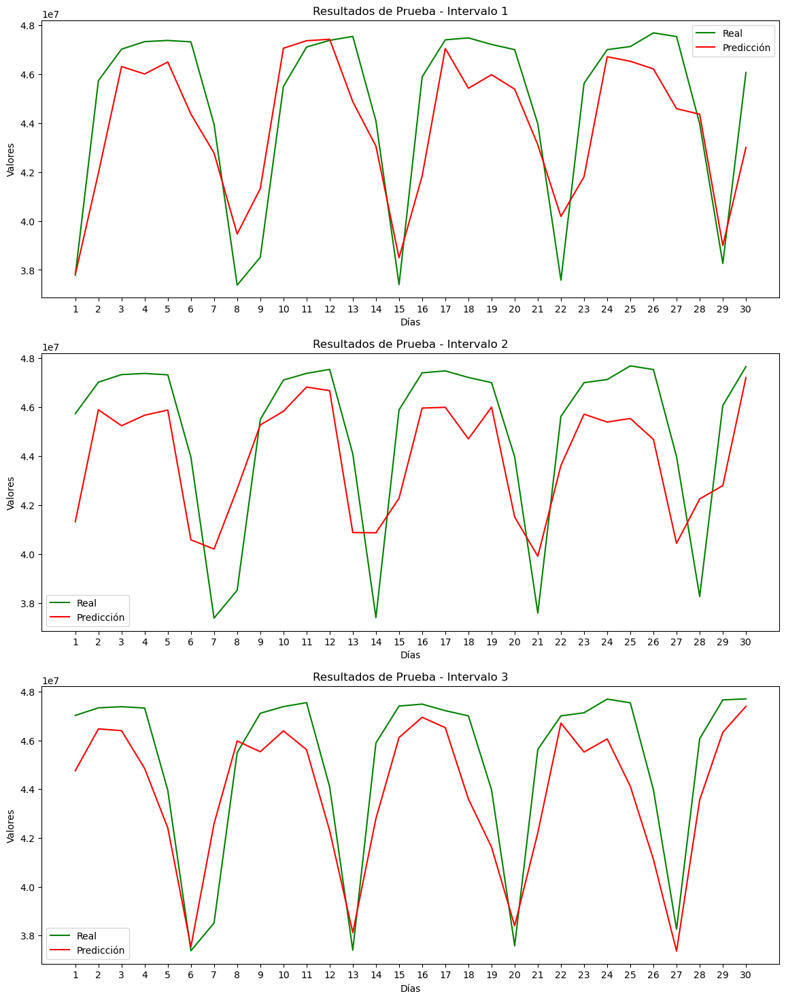

Reloading Tuner from my_dir\CNN_tunning_0\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 1831666.1250
Test Loss: 1869353.625
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step


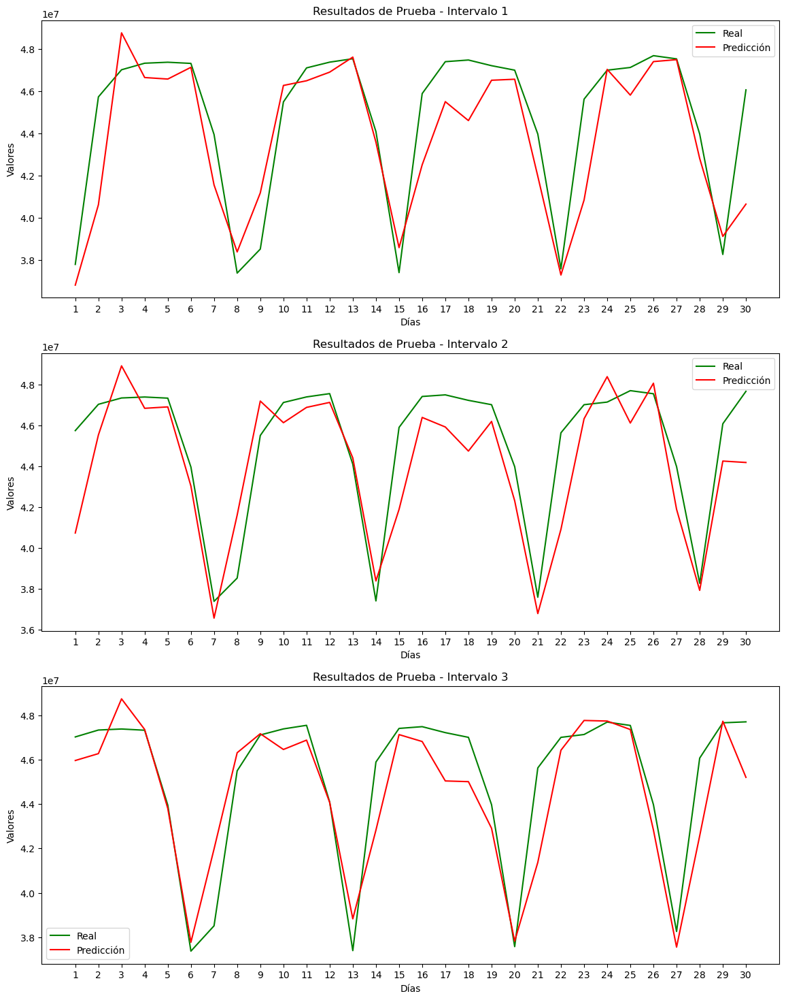

Reloading Tuner from my_dir\MLP_tunning_1\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 1574656.3750
Test Loss: 1501458.5
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step  


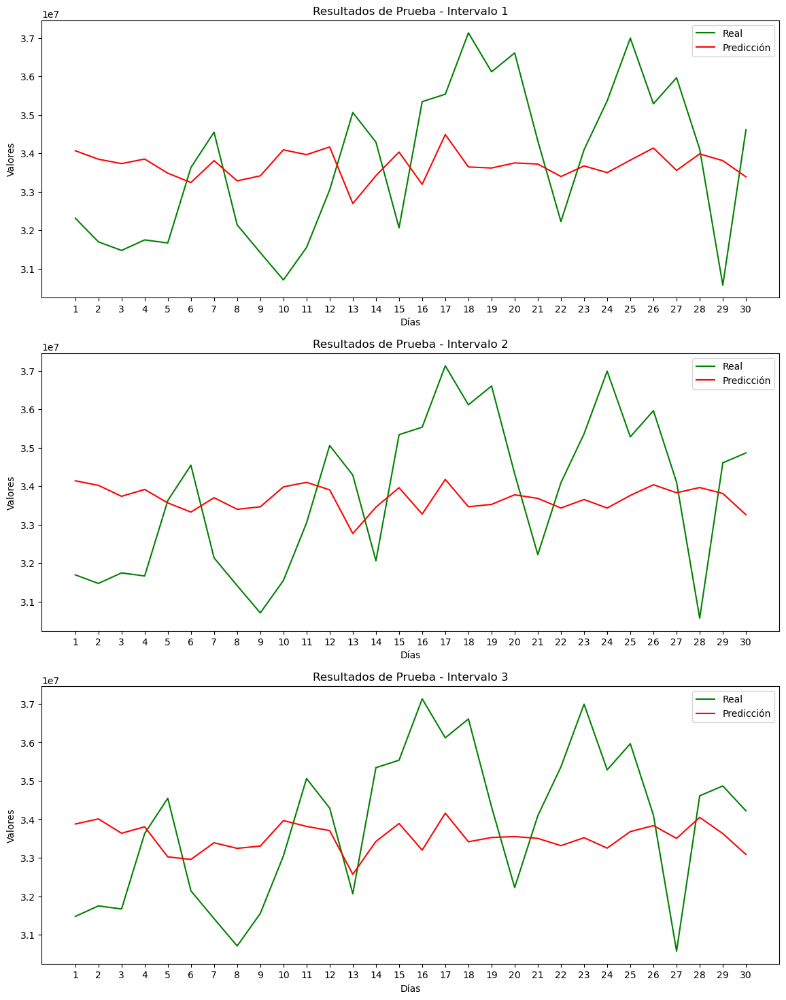

Reloading Tuner from my_dir\CNN_tunning_1\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 1504872.1250
Test Loss: 1426911.625
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step


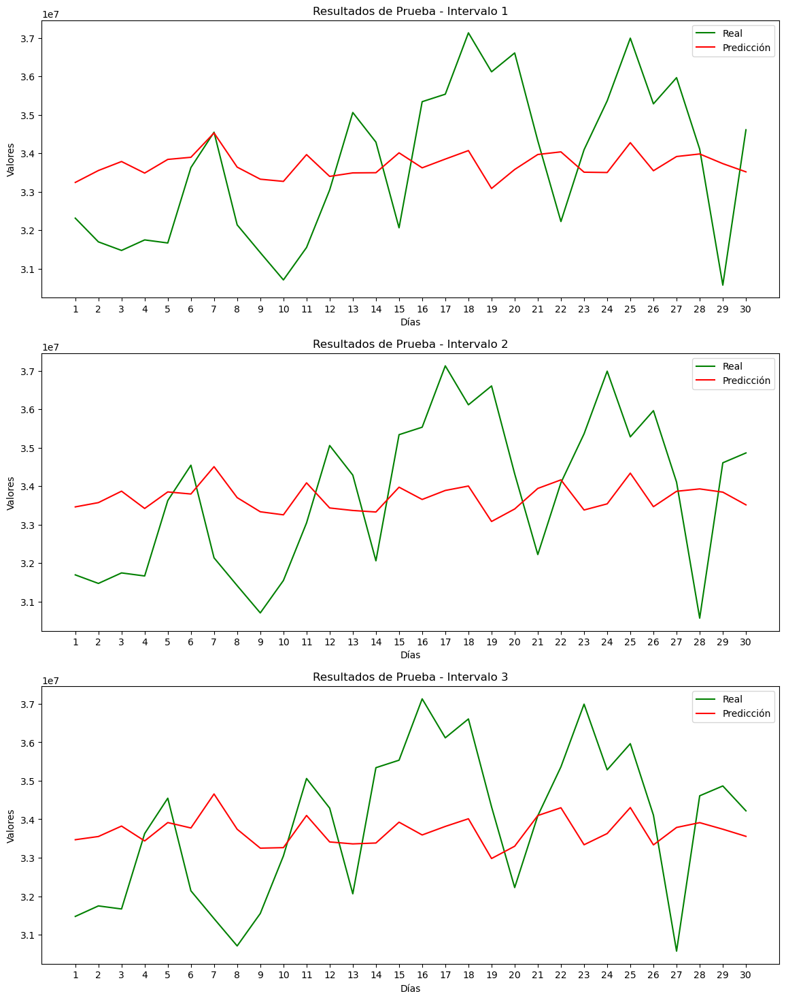

Reloading Tuner from my_dir\MLP_tunning_2\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1444060.5000
Test Loss: 1503337.5
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


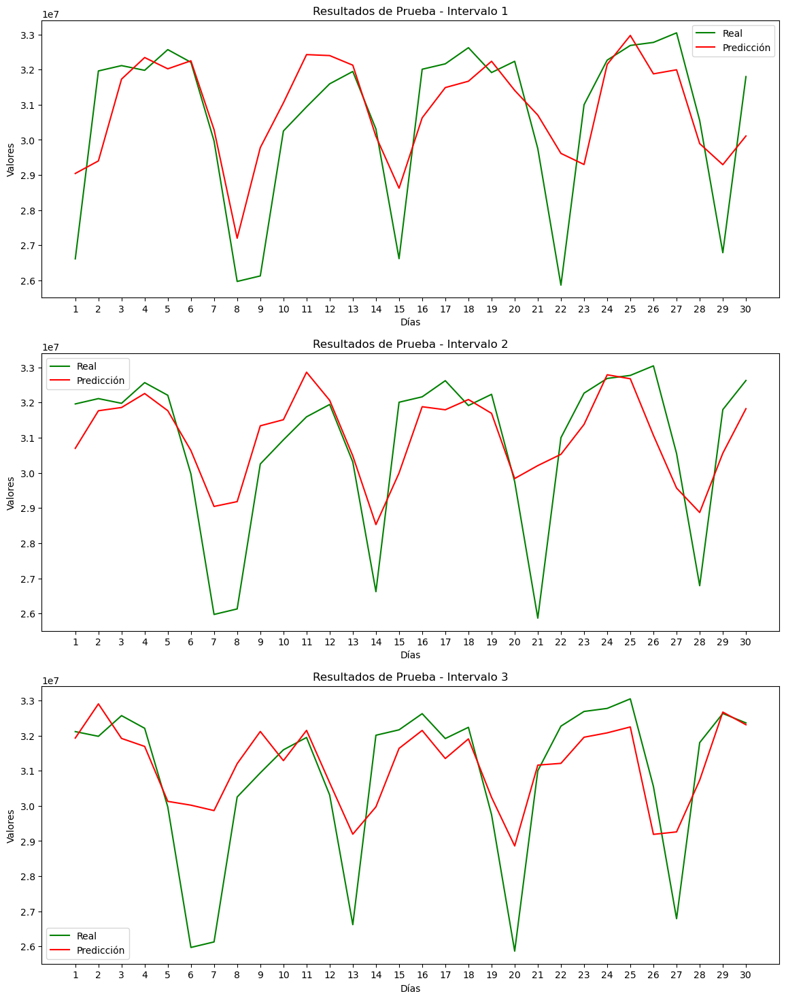

Reloading Tuner from my_dir\CNN_tunning_2\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 1372331.6250
Test Loss: 1426389.0
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


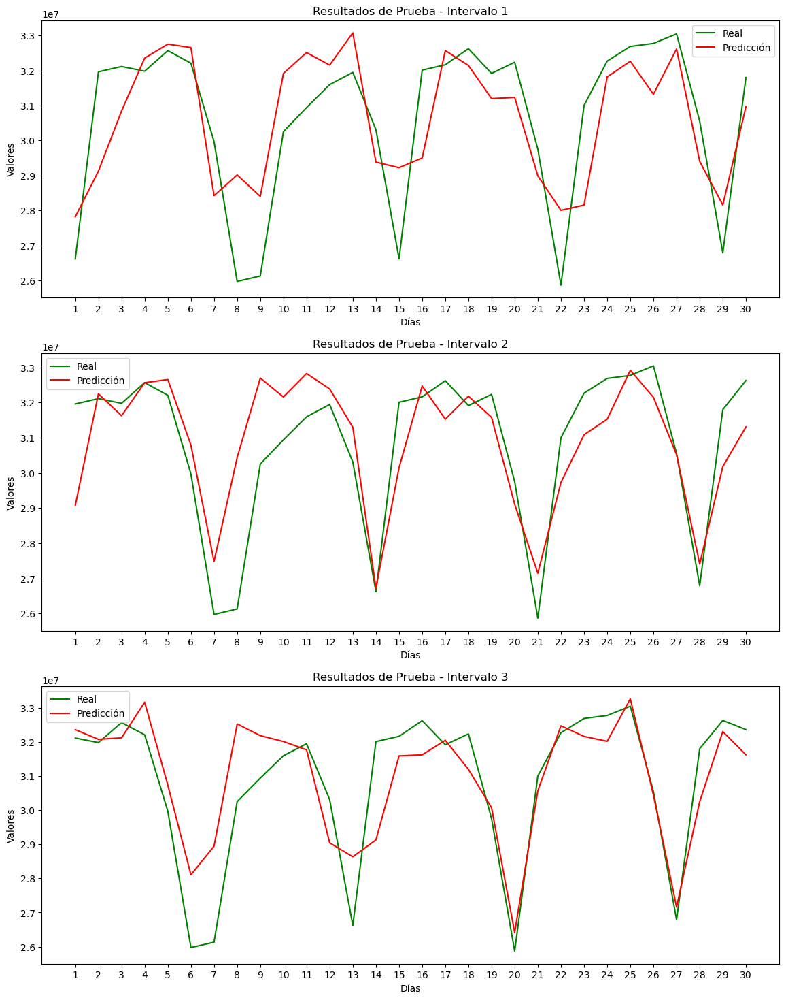

Reloading Tuner from my_dir\MLP_tunning_3\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1743619.5000
Test Loss: 1576560.875
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


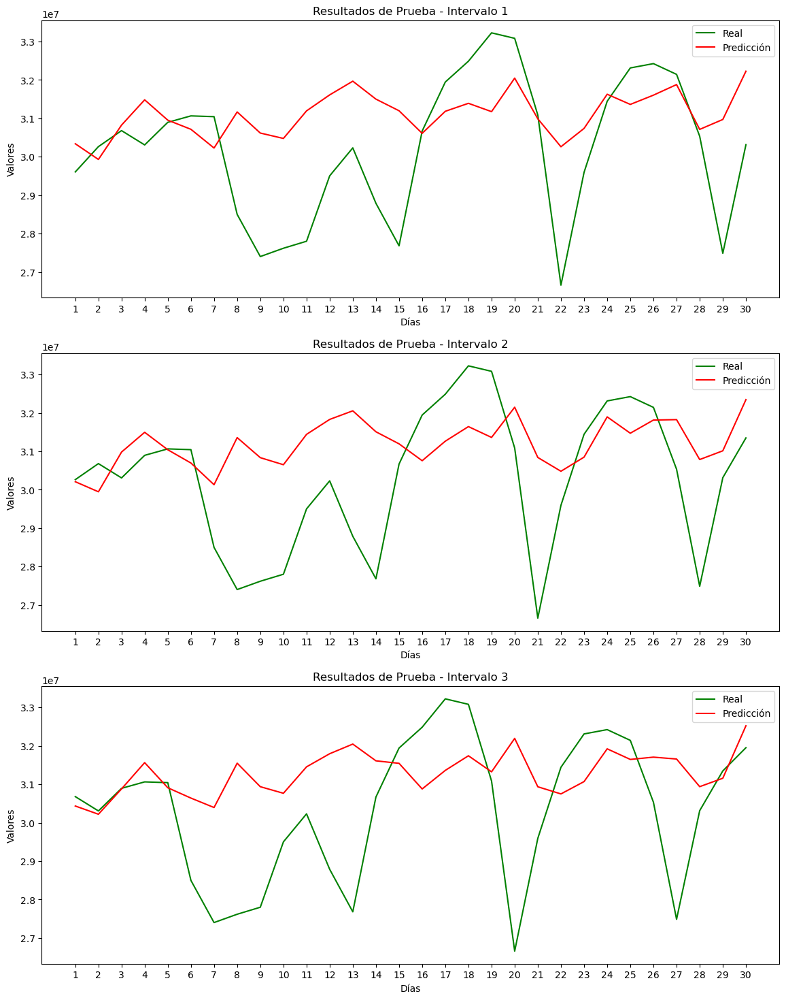

Reloading Tuner from my_dir\CNN_tunning_3\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 1863682.5000
Test Loss: 1673239.625
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


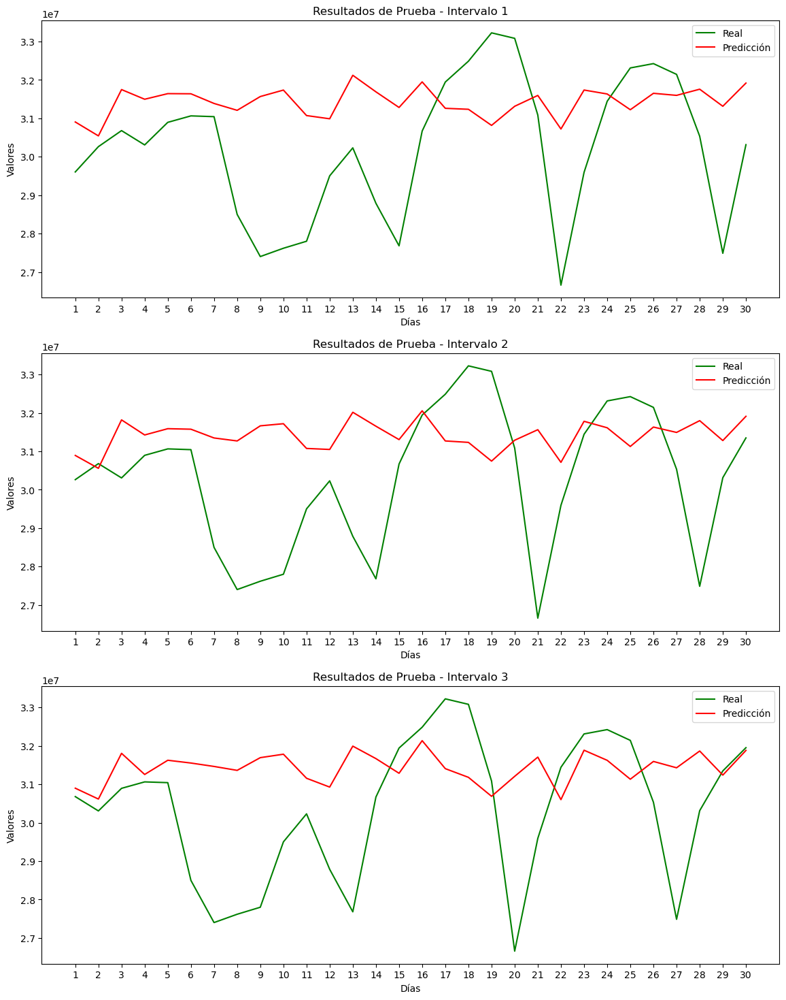

Reloading Tuner from my_dir\MLP_tunning_4\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 790947.5000  
Test Loss: 821719.6875
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step  


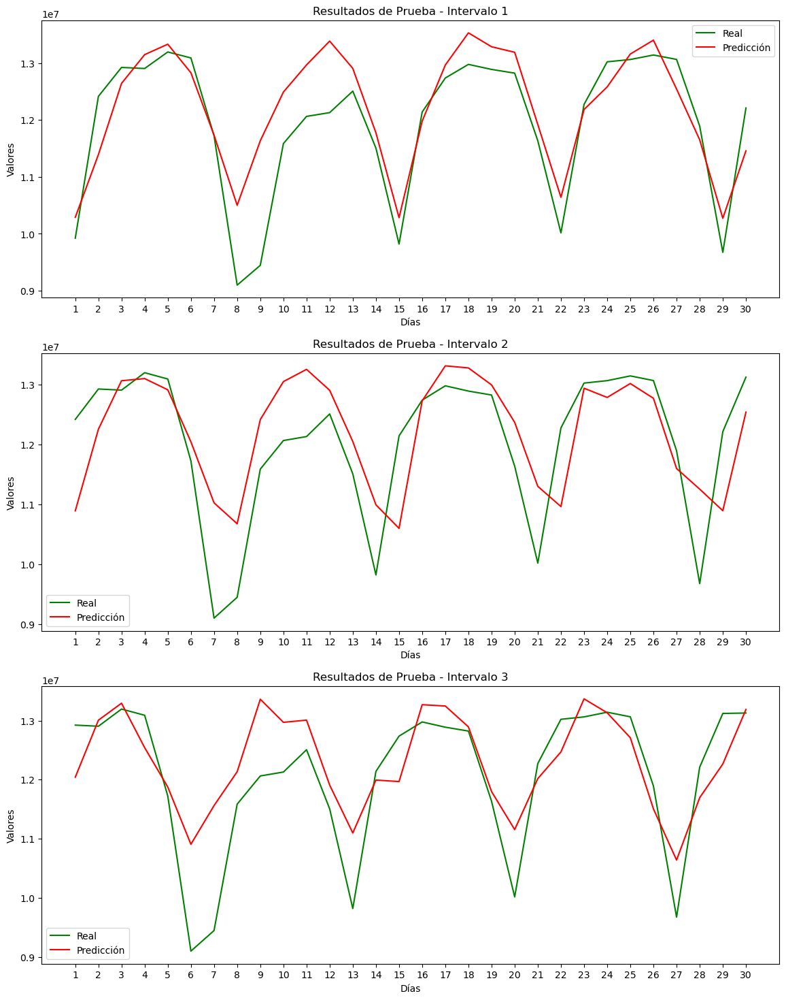

Reloading Tuner from my_dir\CNN_tunning_4\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 702787.6250
Test Loss: 738506.5625
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step


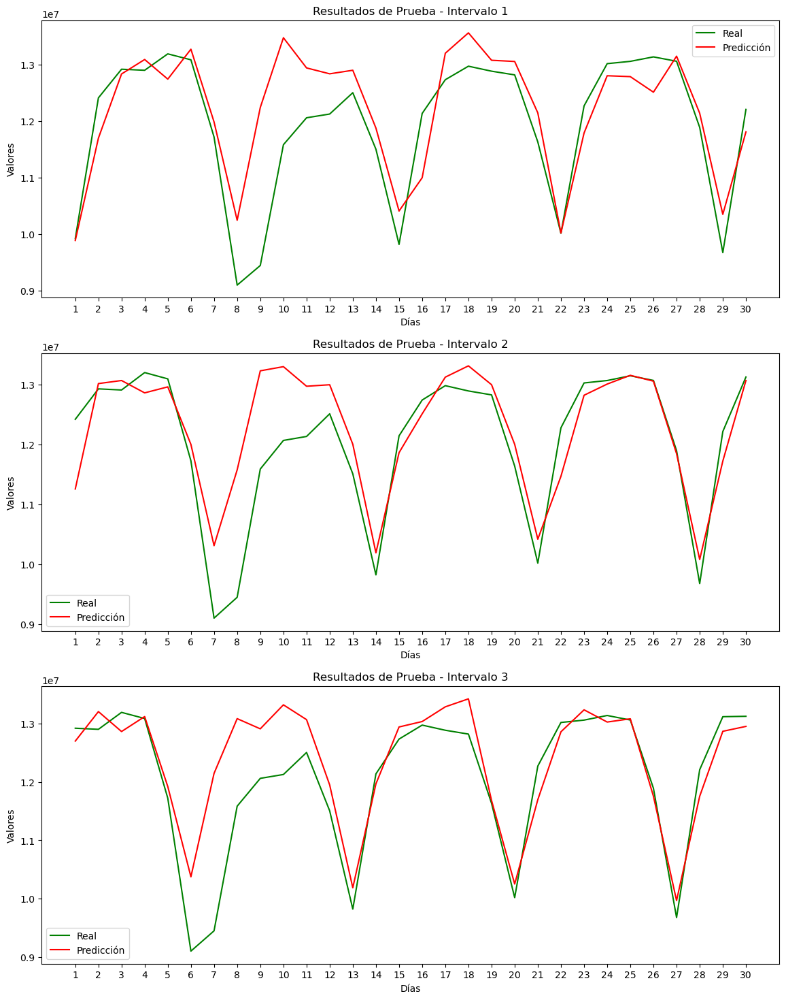

Reloading Tuner from my_dir\MLP_tunning_5\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 479881.0625
Test Loss: 500150.90625
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


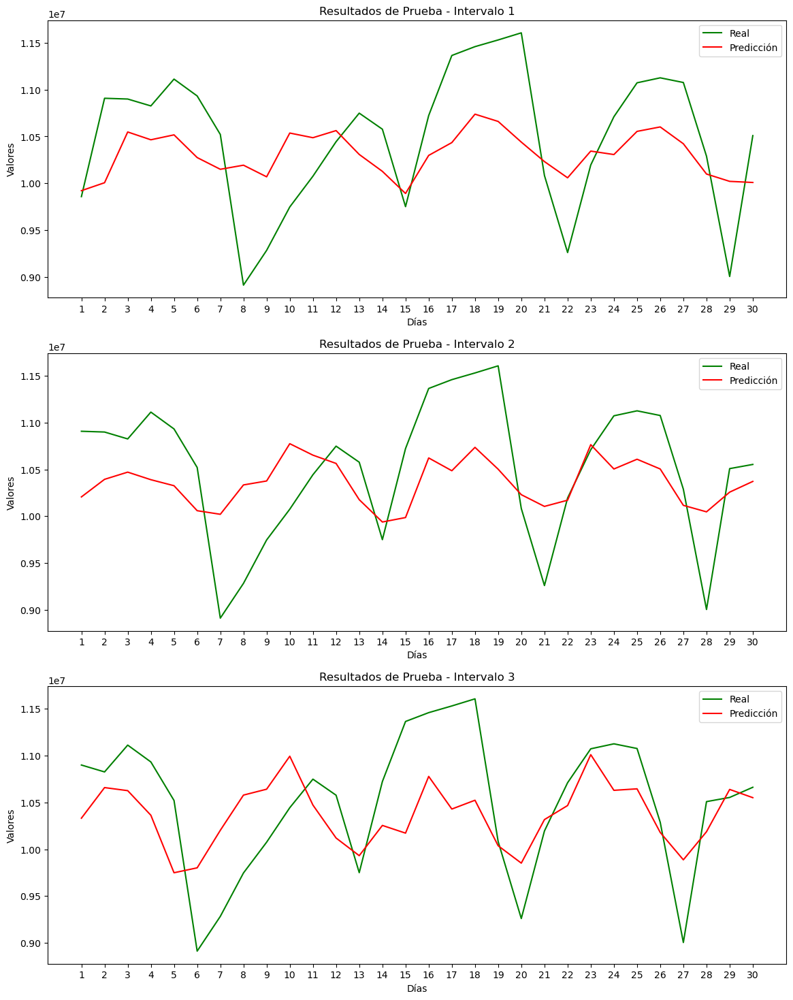

Reloading Tuner from my_dir\CNN_tunning_5\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 464816.7812
Test Loss: 487175.25
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step


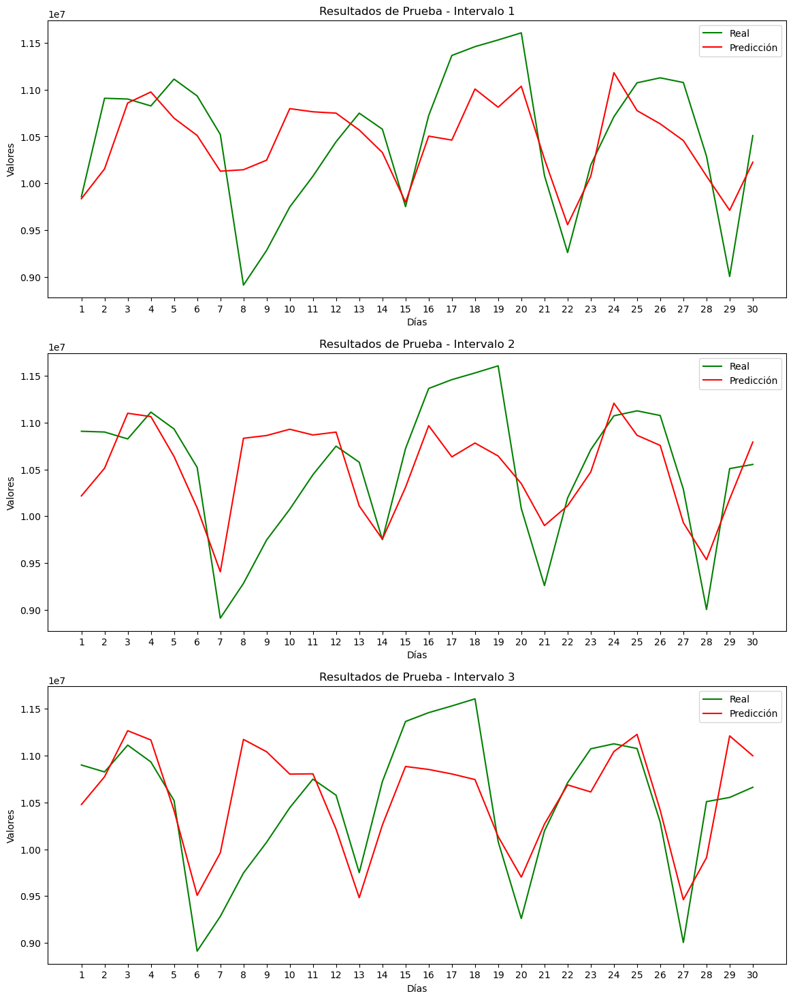

Reloading Tuner from my_dir\MLP_tunning_6\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 460393.6875
Test Loss: 460211.96875
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


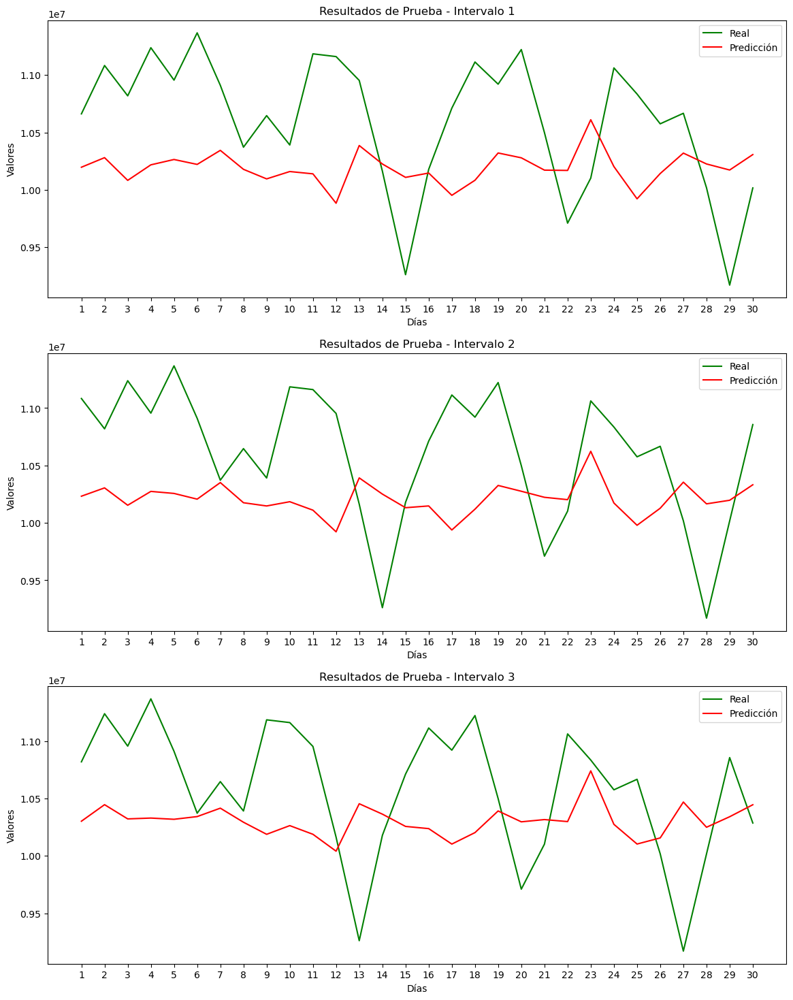

Reloading Tuner from my_dir\CNN_tunning_6\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 449636.6250
Test Loss: 449138.96875
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 


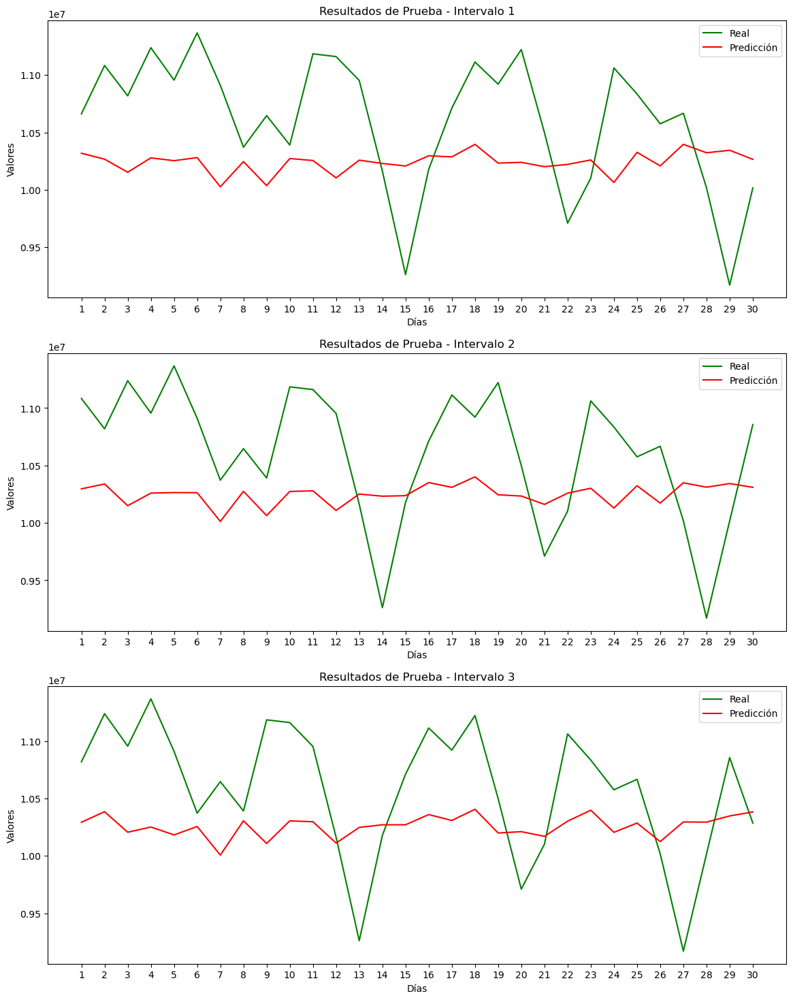

Reloading Tuner from my_dir\MLP_tunning_7\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 437065.3125 
Test Loss: 448528.125
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 


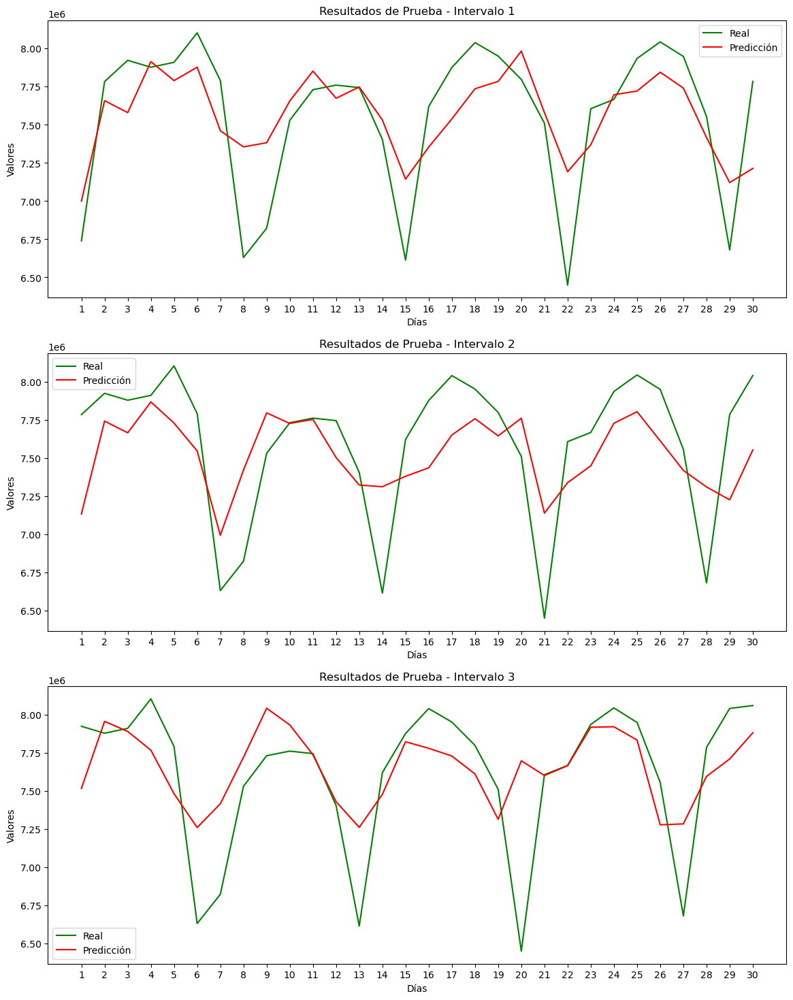

Reloading Tuner from my_dir\CNN_tunning_7\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 440977.0938
Test Loss: 446159.625
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


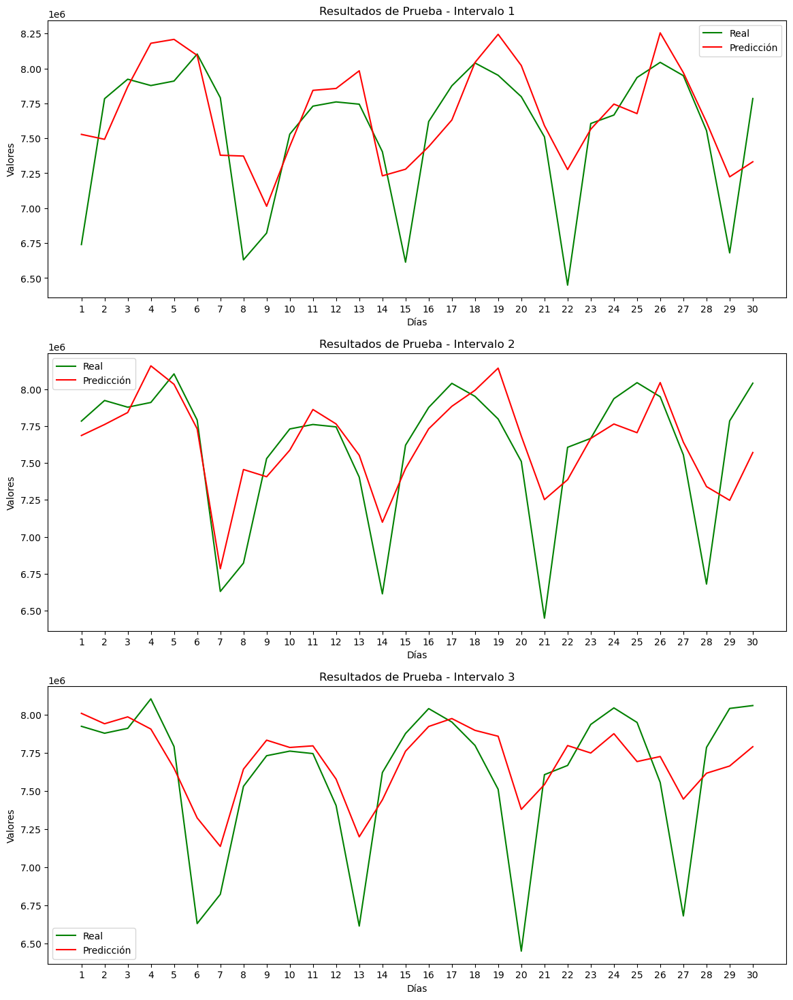

Reloading Tuner from my_dir\MLP_tunning_8\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - loss: 368897.8125
Test Loss: 404179.5
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


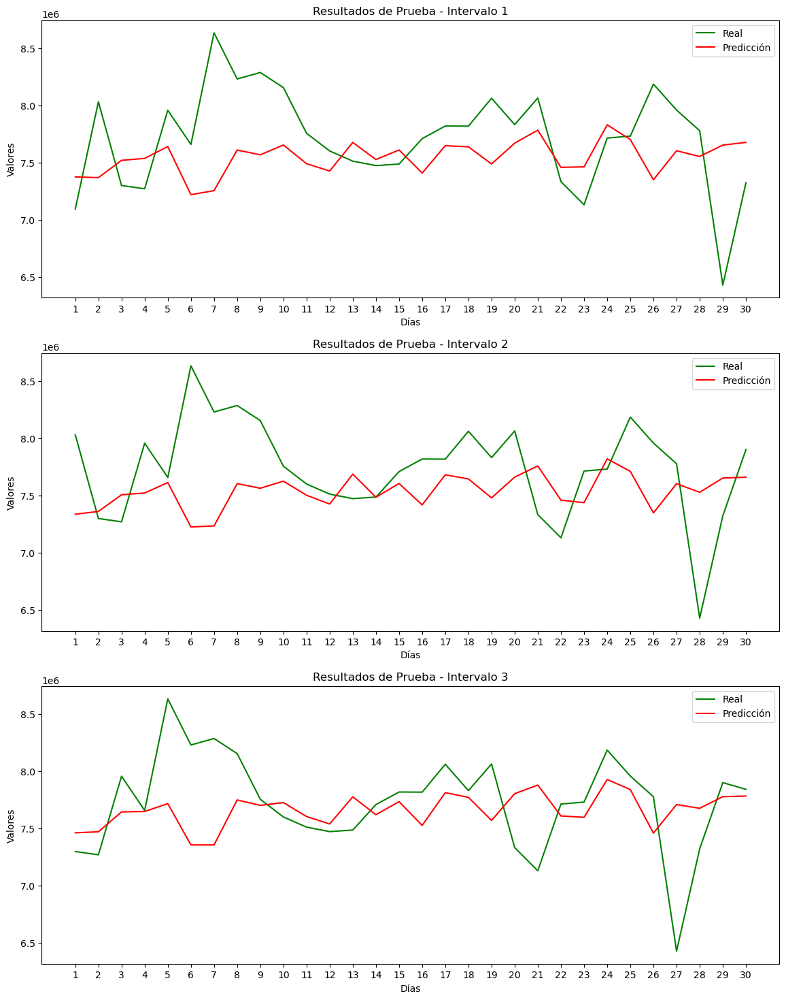

Reloading Tuner from my_dir\CNN_tunning_8\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 334974.5000
Test Loss: 369417.90625
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step


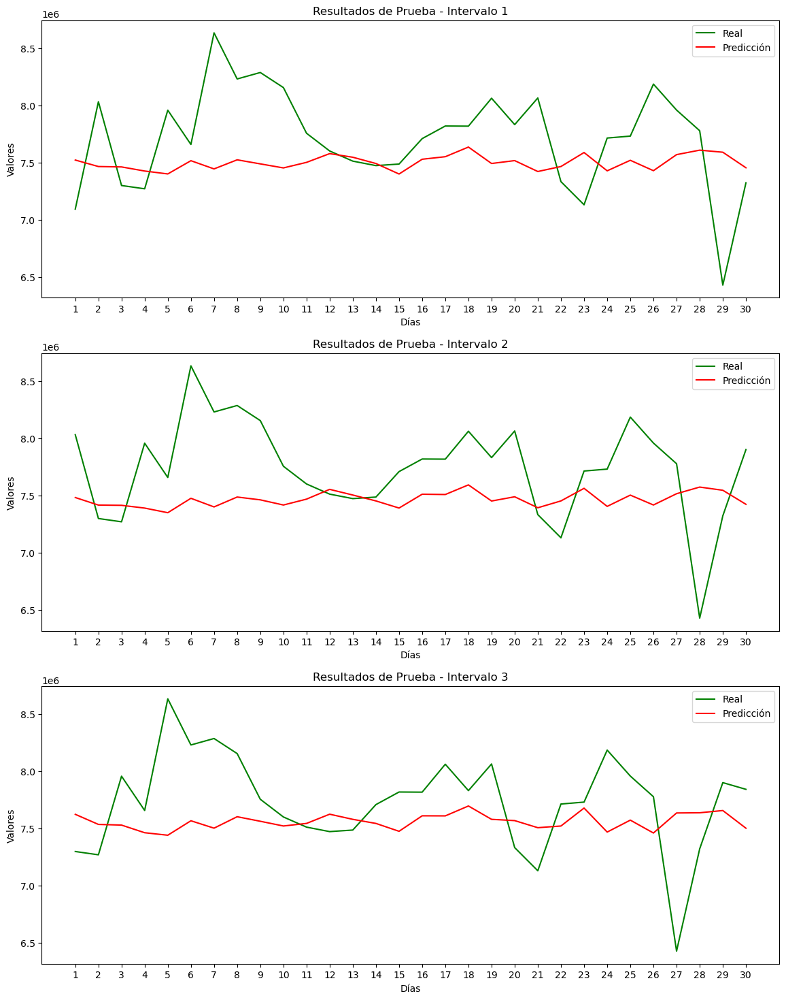

Reloading Tuner from my_dir\MLP_tunning_9\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - loss: 360206.1250
Test Loss: 344339.40625
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


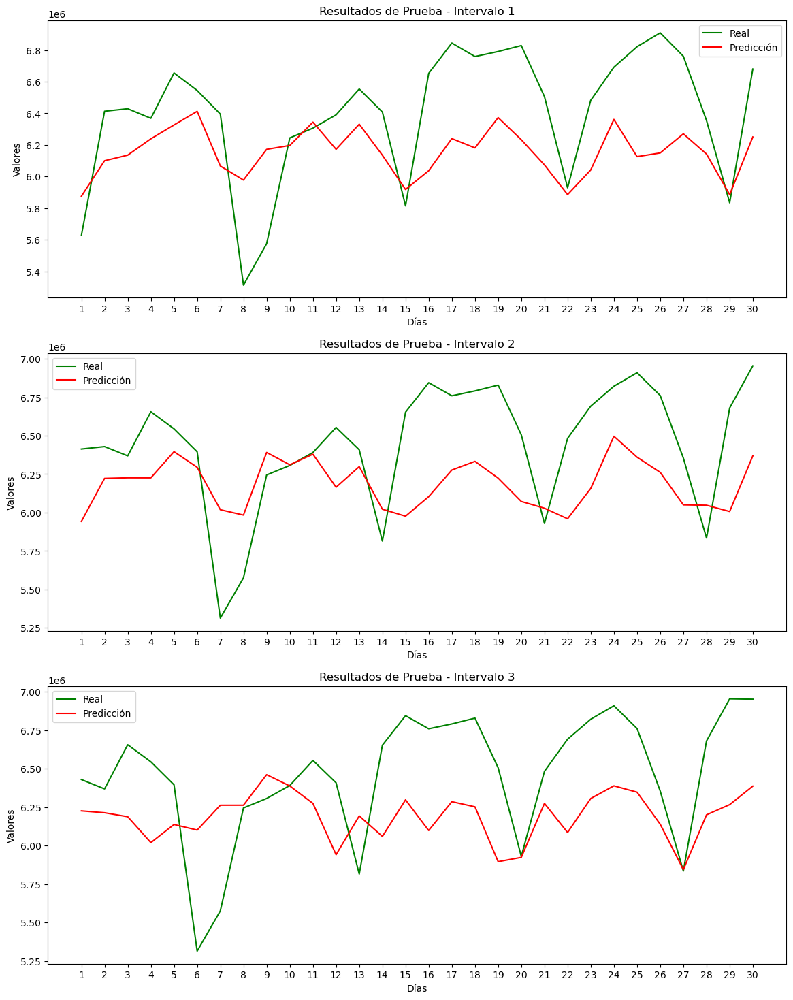

Reloading Tuner from my_dir\CNN_tunning_9\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 387283.5000
Test Loss: 372724.53125
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step


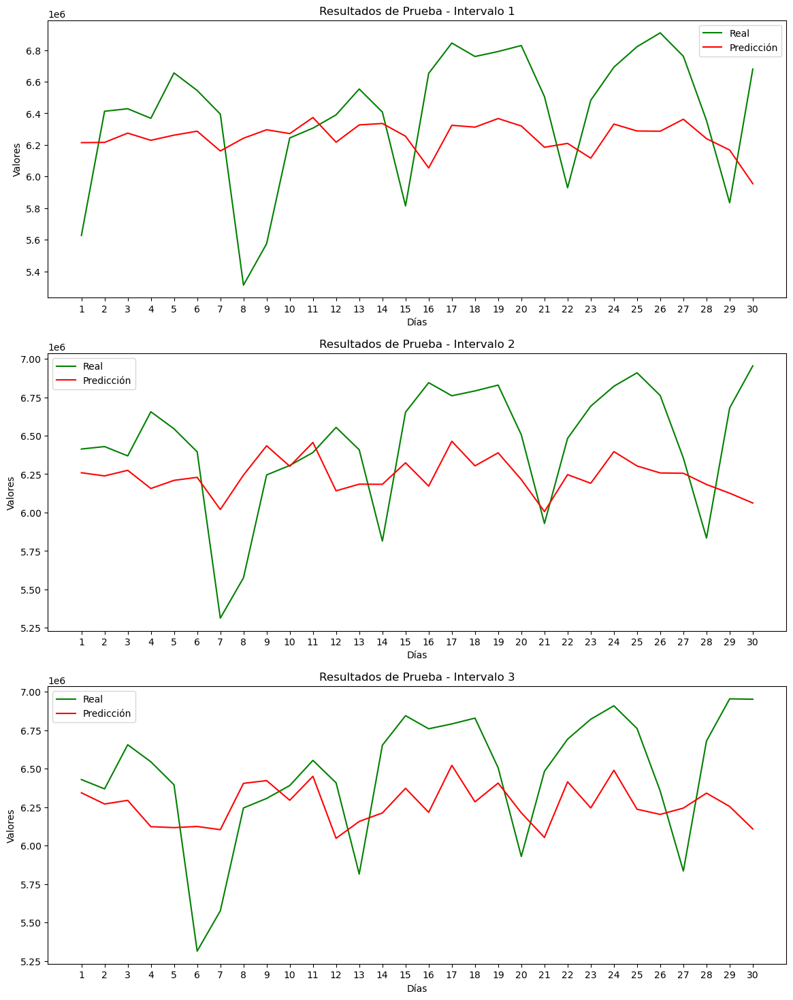

Reloading Tuner from my_dir\MLP_tunning_10\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 219229.3281 
Test Loss: 225677.25
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


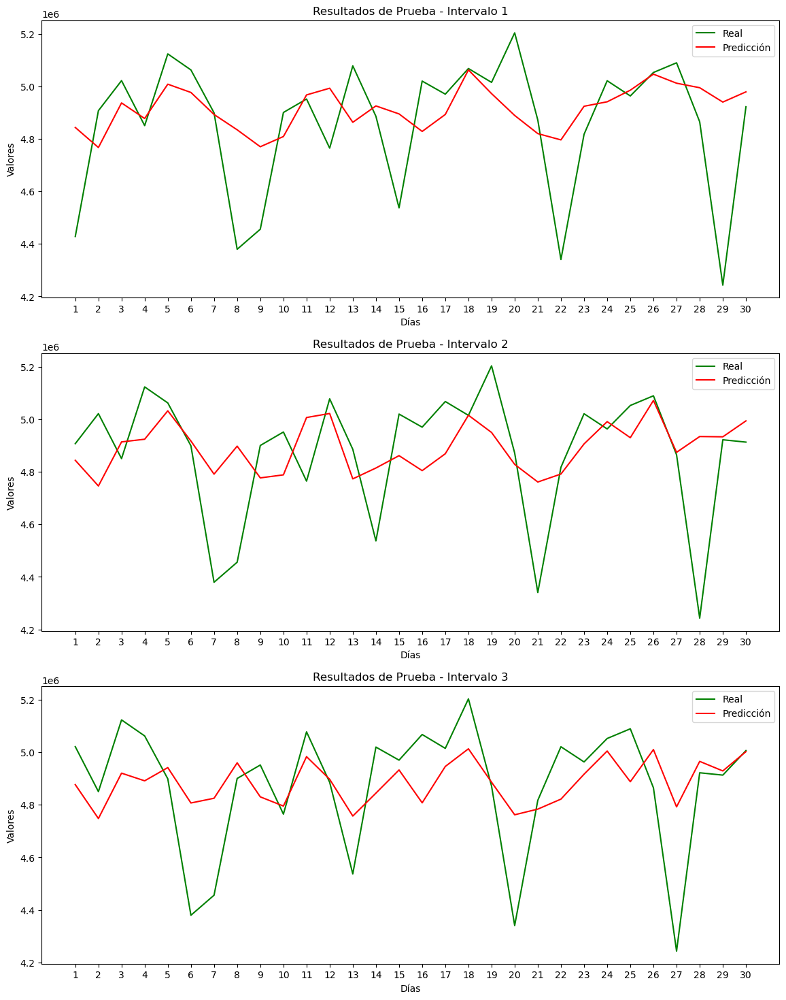

Reloading Tuner from my_dir\CNN_tunning_10\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - loss: 212318.7812
Test Loss: 219778.234375
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step


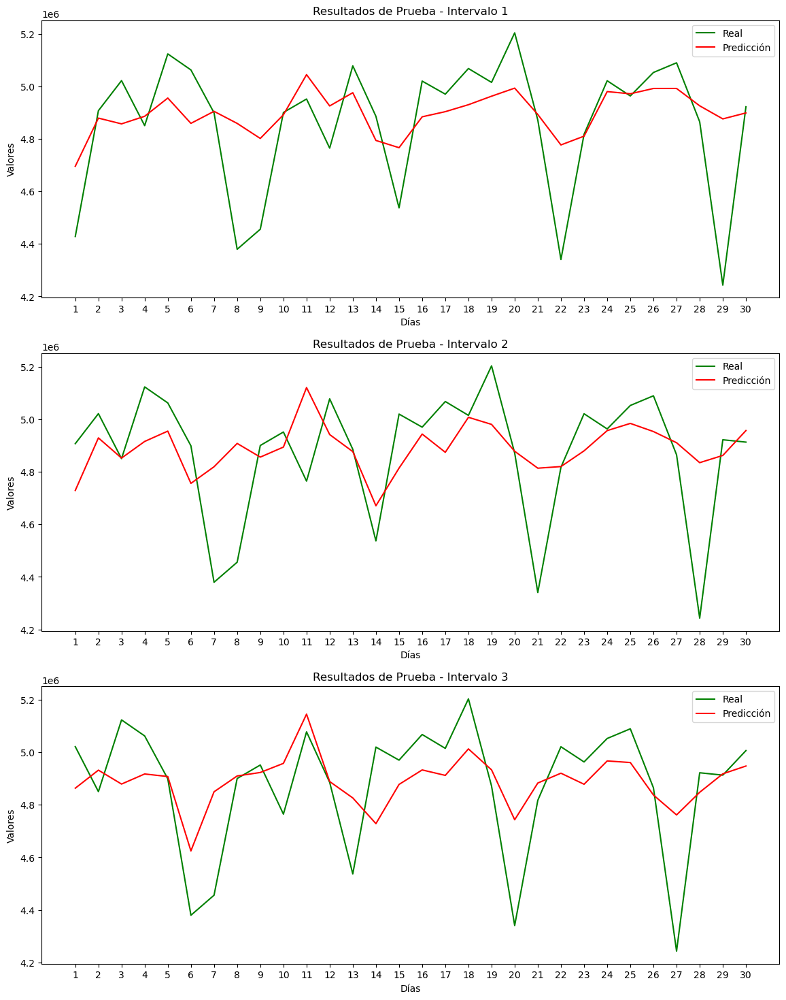

Reloading Tuner from my_dir\MLP_tunning_11\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 223182.4844
Test Loss: 225411.109375
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


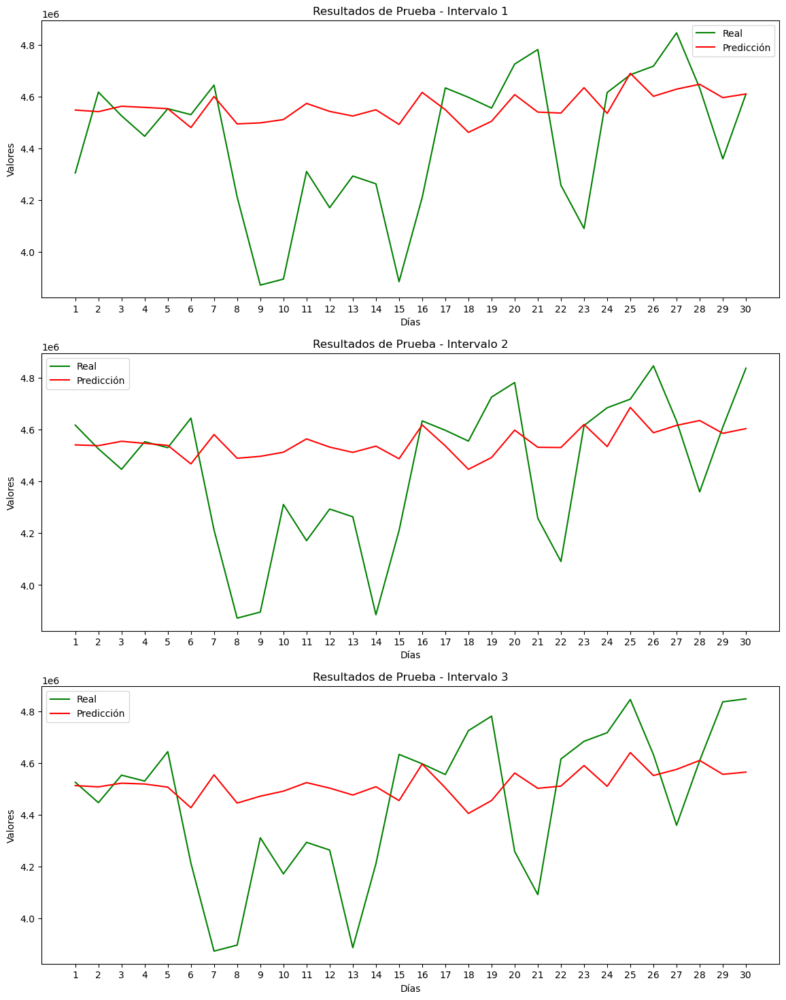

Reloading Tuner from my_dir\CNN_tunning_11\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 212535.6719
Test Loss: 216230.4375
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


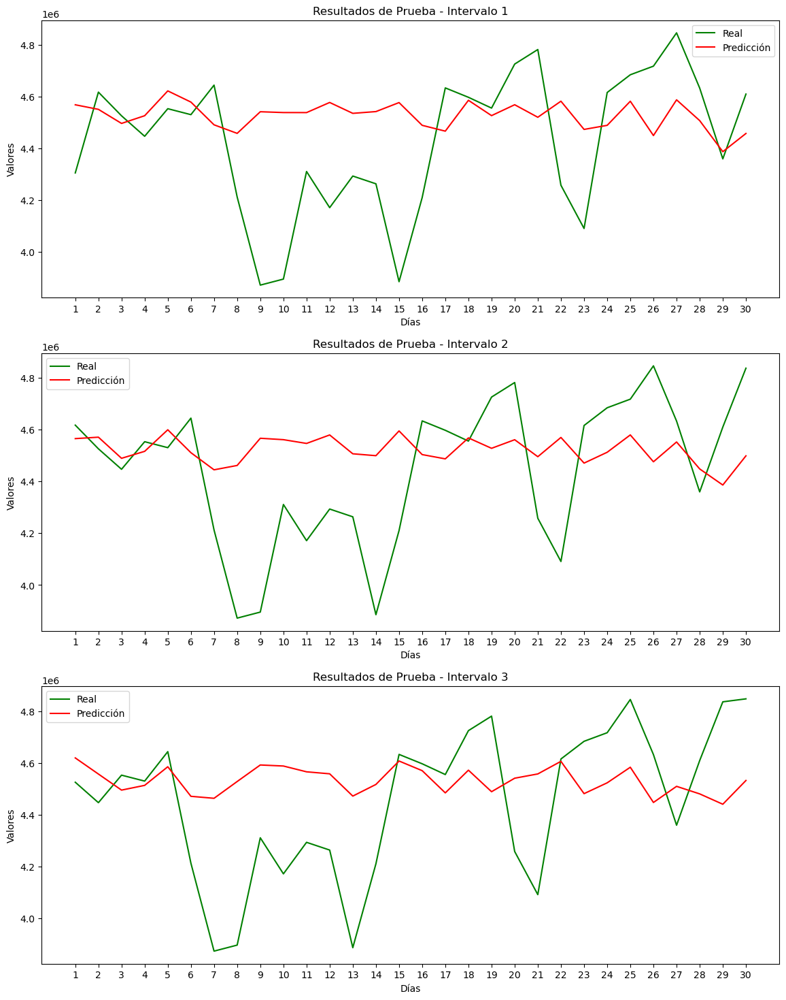

Reloading Tuner from my_dir\MLP_tunning_12\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 212592.8438
Test Loss: 209412.203125
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 


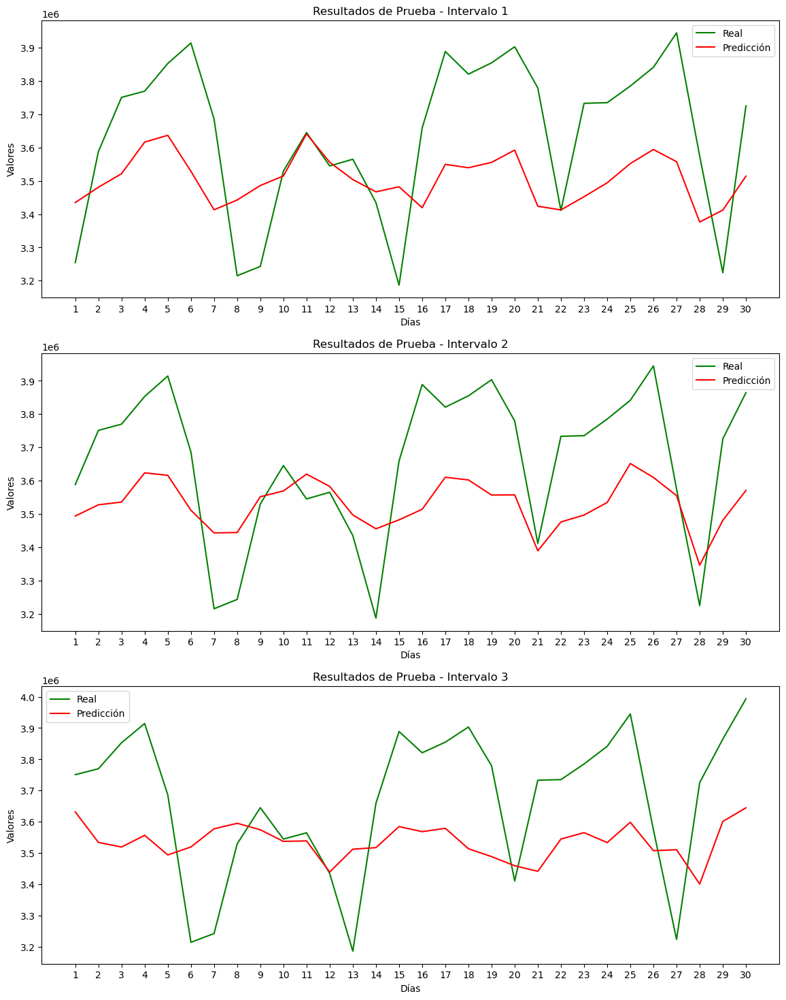

Reloading Tuner from my_dir\CNN_tunning_12\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 187286.0625
Test Loss: 188358.25
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step


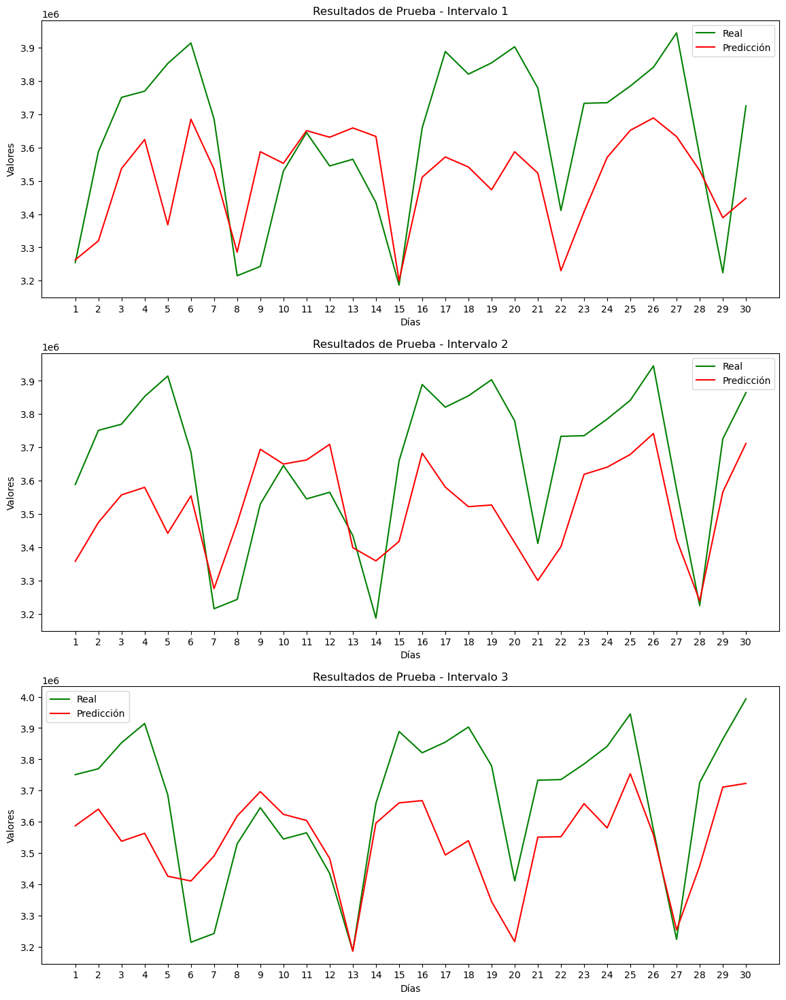

Reloading Tuner from my_dir\MLP_tunning_13\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 146624.2812
Test Loss: 158871.1875
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


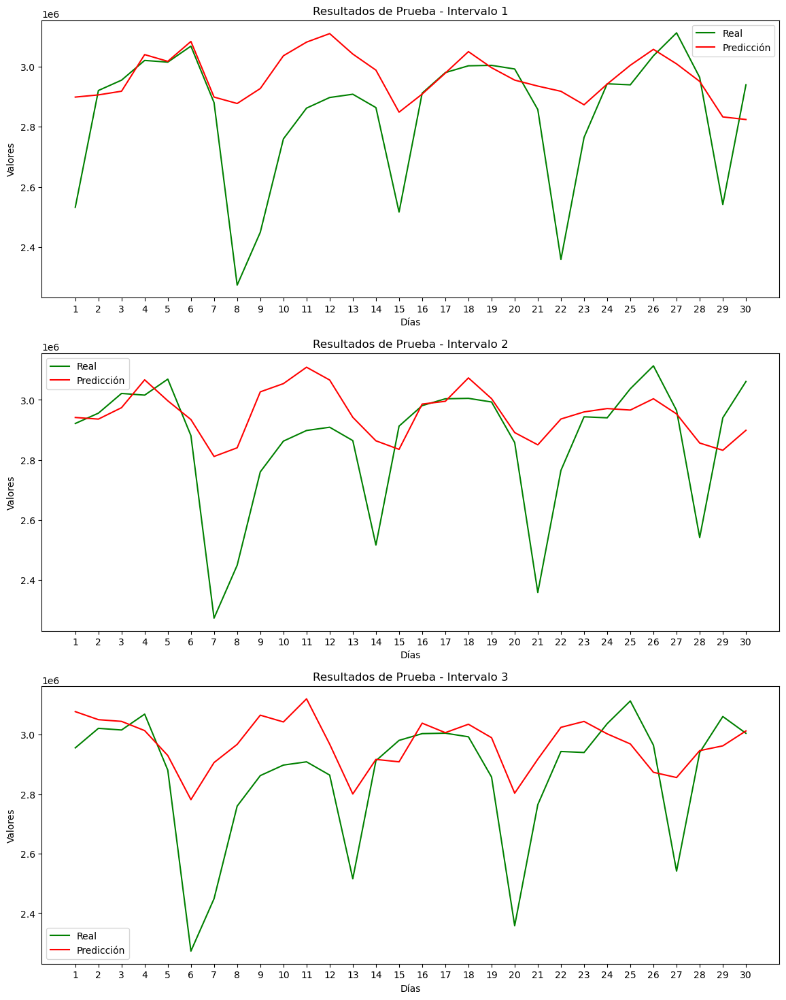

Reloading Tuner from my_dir\CNN_tunning_13\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 134420.7812
Test Loss: 147429.609375
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step


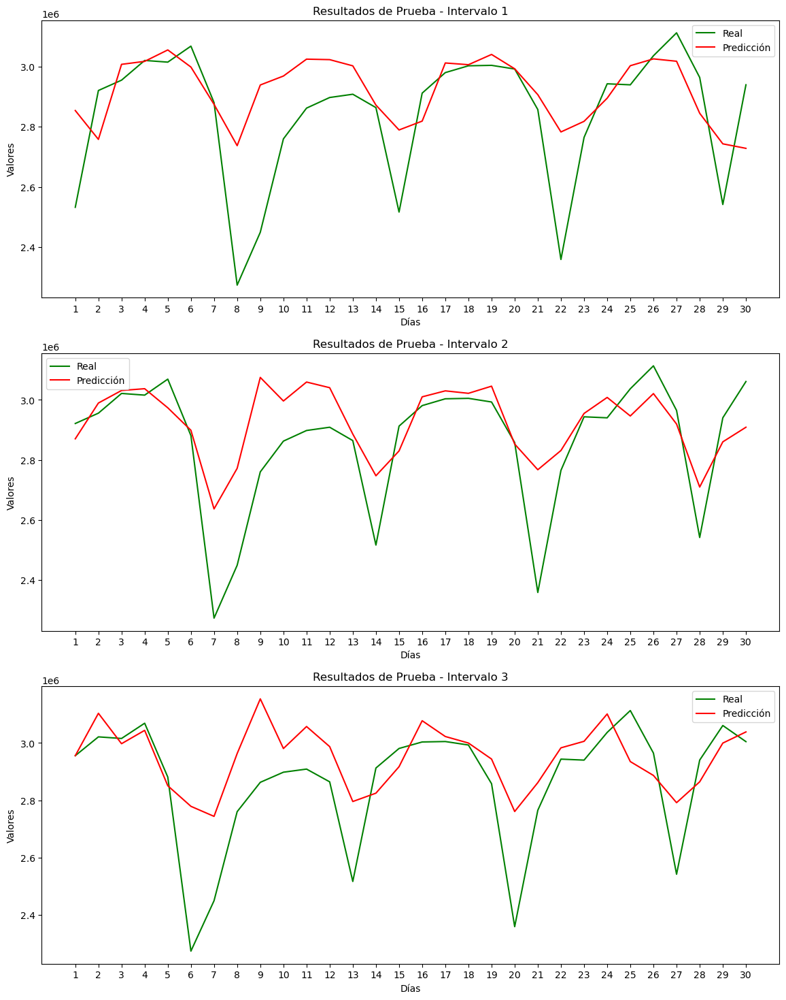

Reloading Tuner from my_dir\MLP_tunning_14\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 96427.9844  
Test Loss: 155084.765625
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


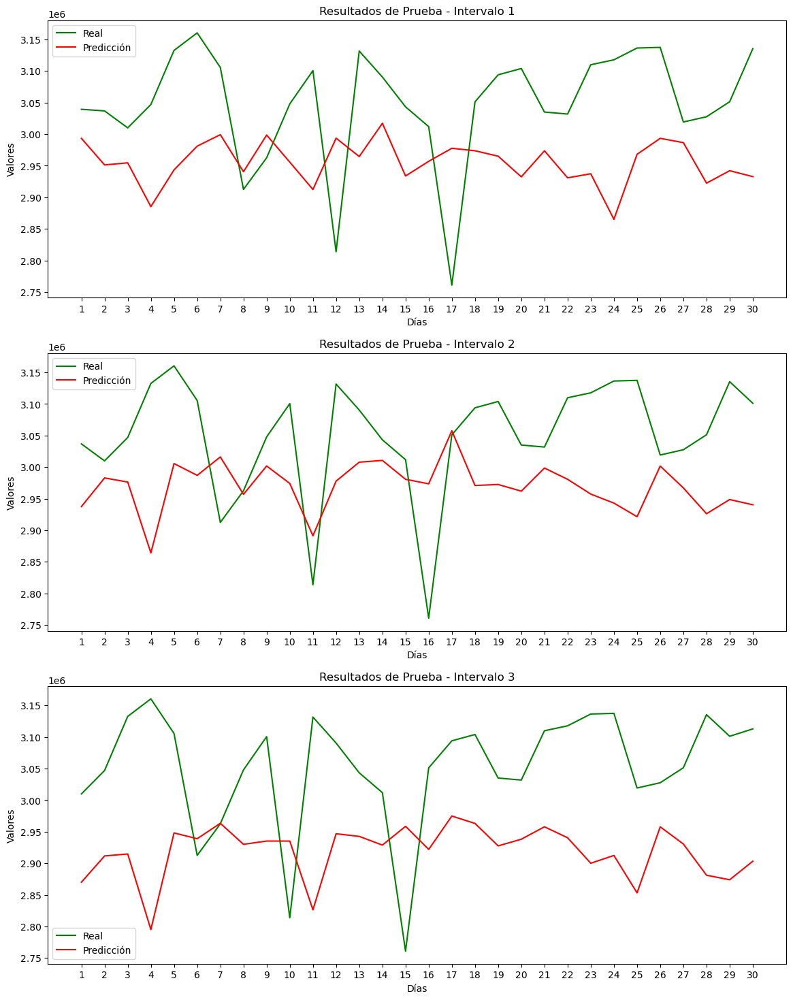

Reloading Tuner from my_dir\CNN_tunning_14\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 92522.1484
Test Loss: 152508.890625
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step


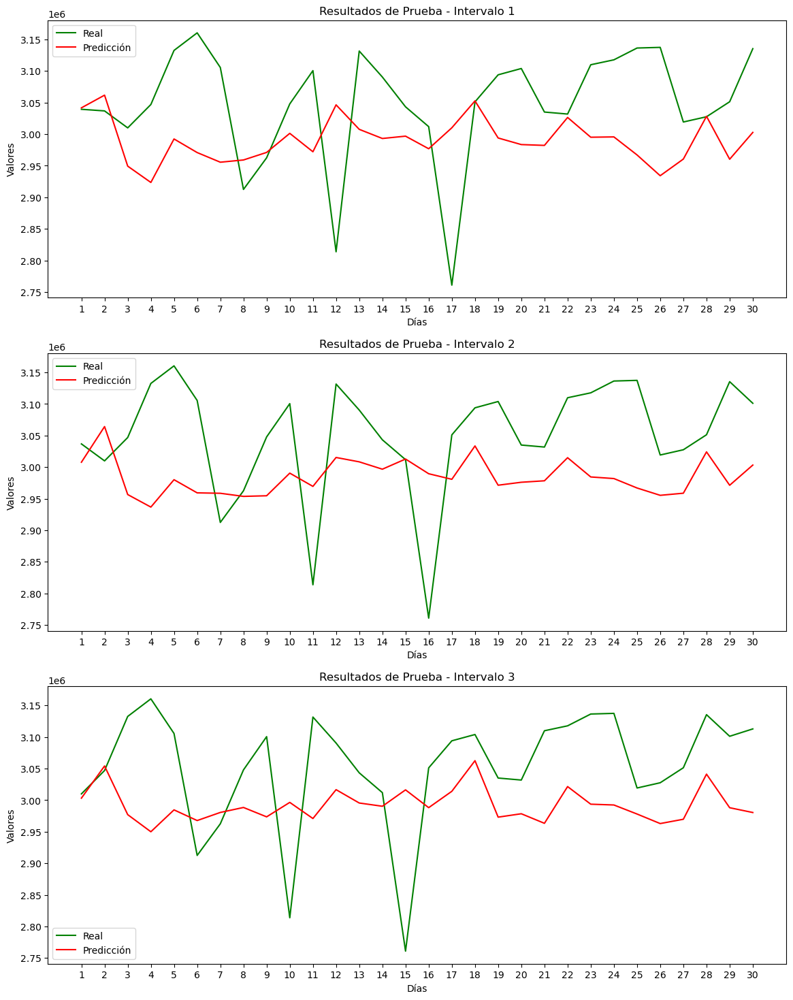

Reloading Tuner from my_dir\MLP_tunning_15\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 79880.7266 
Test Loss: 76098.7421875
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


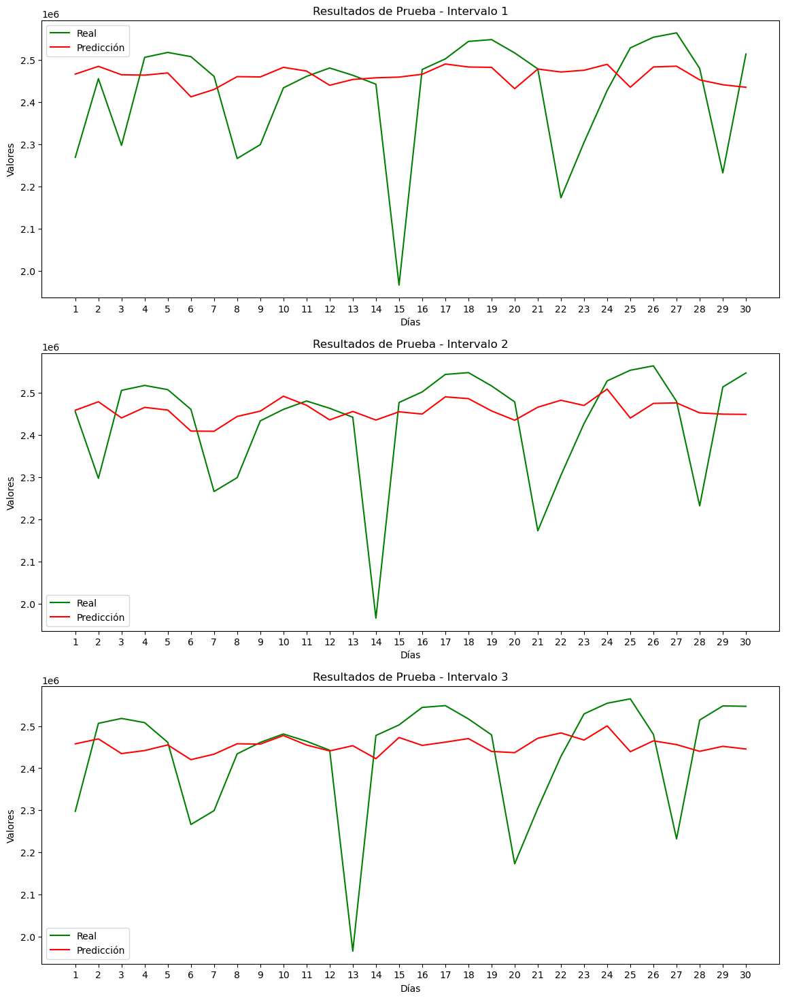

Reloading Tuner from my_dir\CNN_tunning_15\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 75708.9062
Test Loss: 72163.75
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


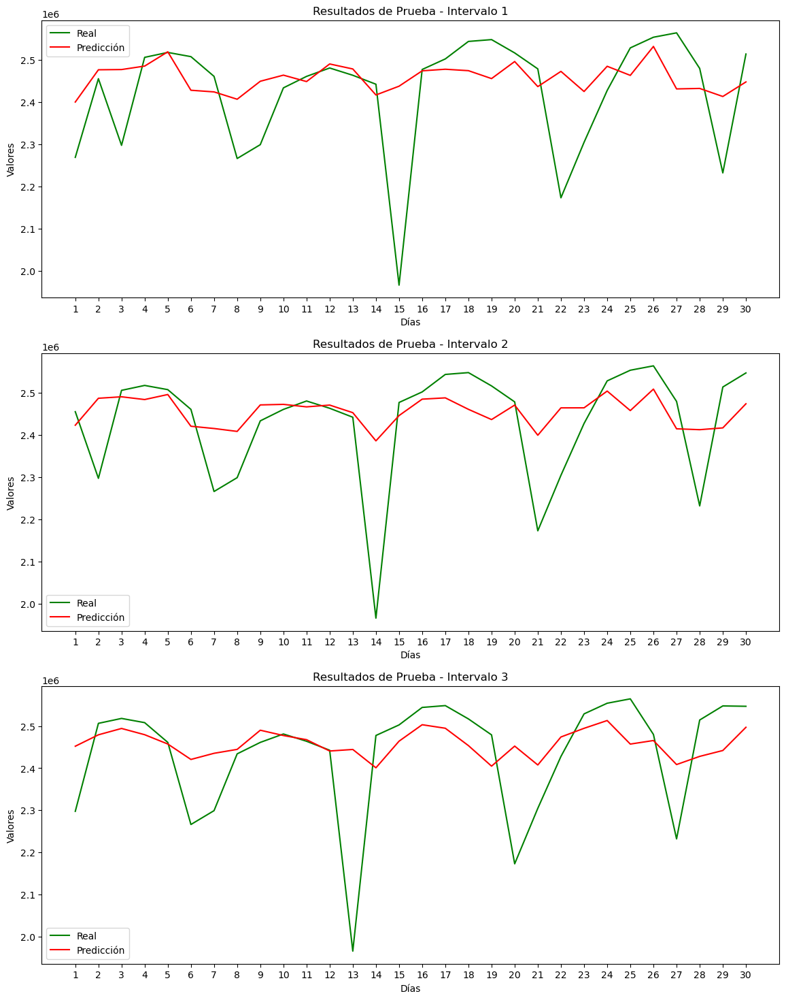

Reloading Tuner from my_dir\MLP_tunning_16\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 104232.0781
Test Loss: 108316.7734375
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


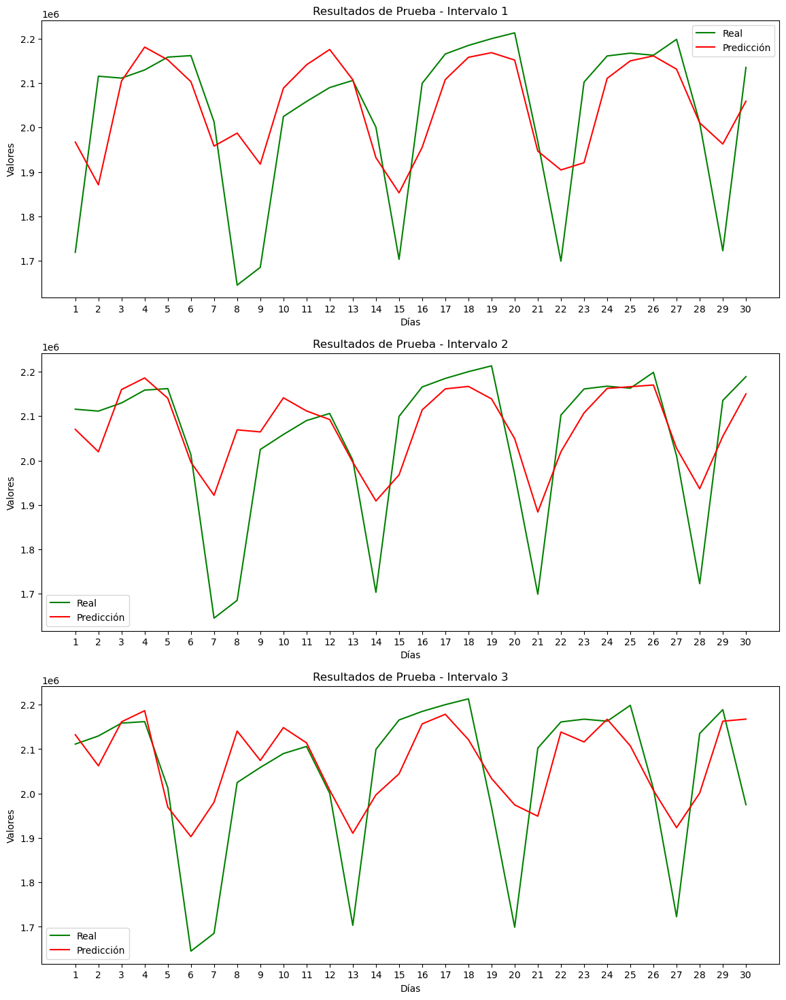

Reloading Tuner from my_dir\CNN_tunning_16\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 95515.4141
Test Loss: 99258.8203125
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


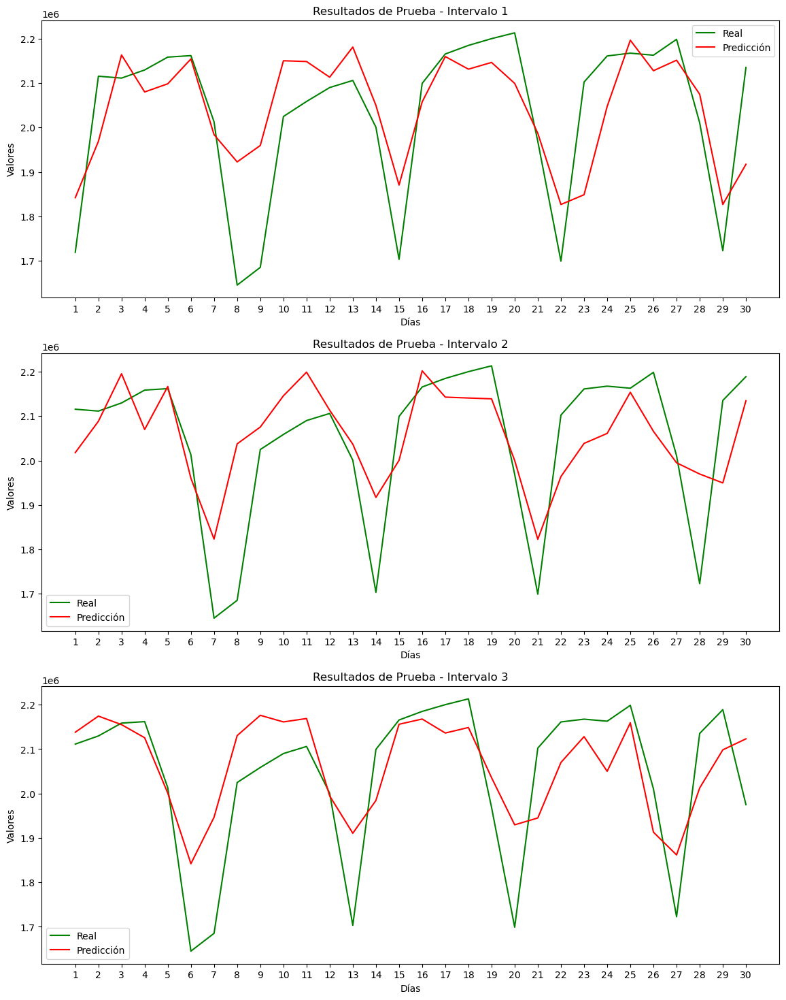

Reloading Tuner from my_dir\MLP_tunning_17\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 115095.4609
Test Loss: 121255.4375
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step  


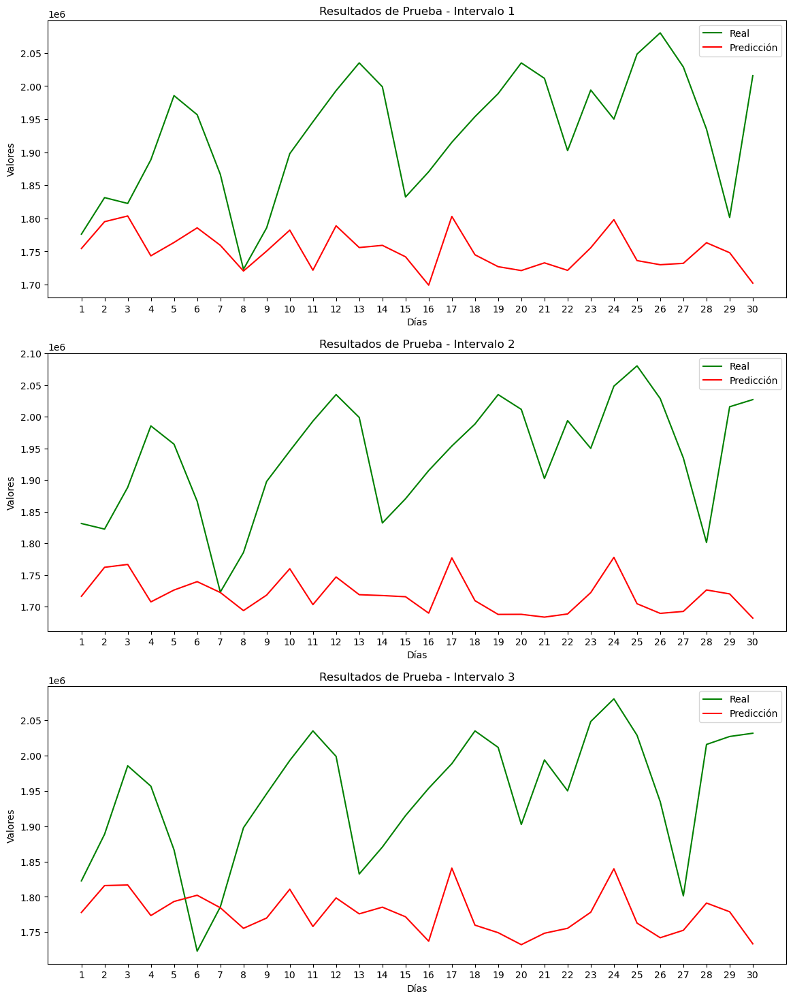

Reloading Tuner from my_dir\CNN_tunning_17\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 110499.9609
Test Loss: 117075.09375
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


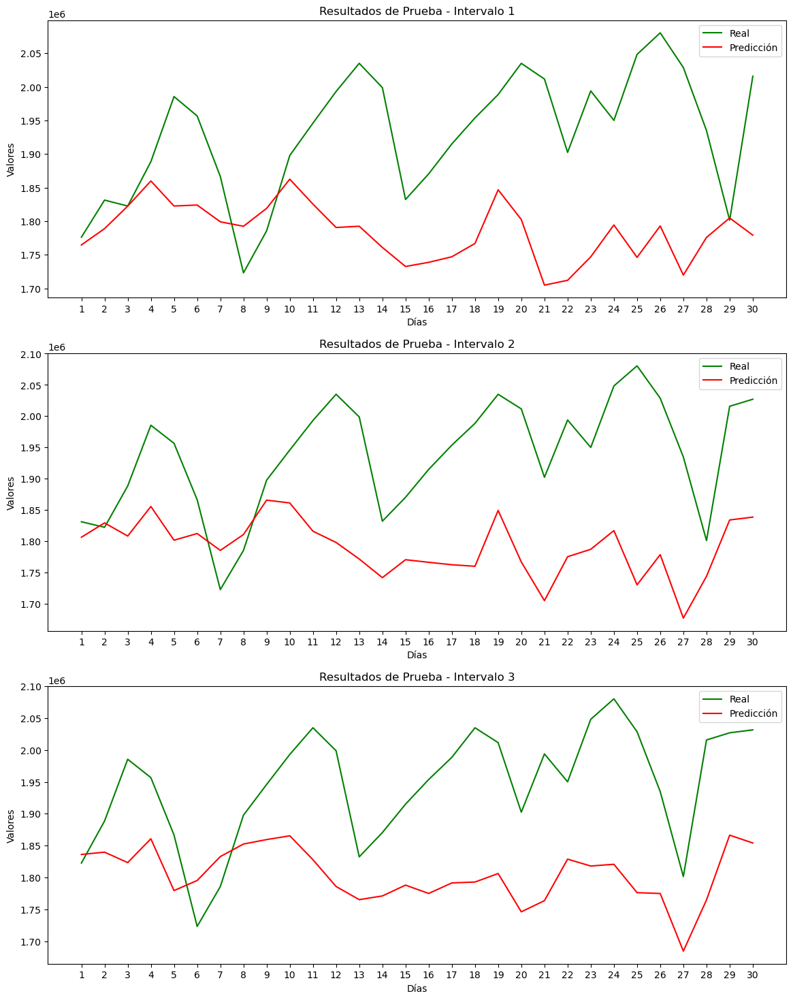

Reloading Tuner from my_dir\MLP_tunning_18\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 60908.33205
Test Loss: 62194.58203125
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


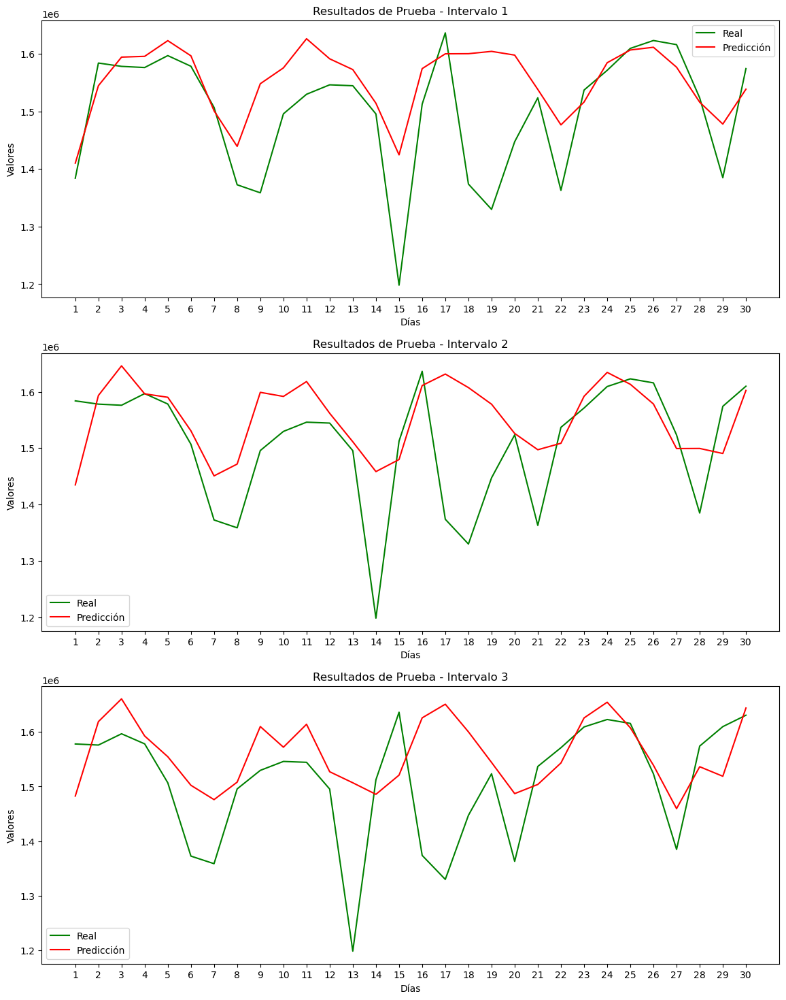

Reloading Tuner from my_dir\CNN_tunning_18\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 57442.0078
Test Loss: 58883.74609375
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


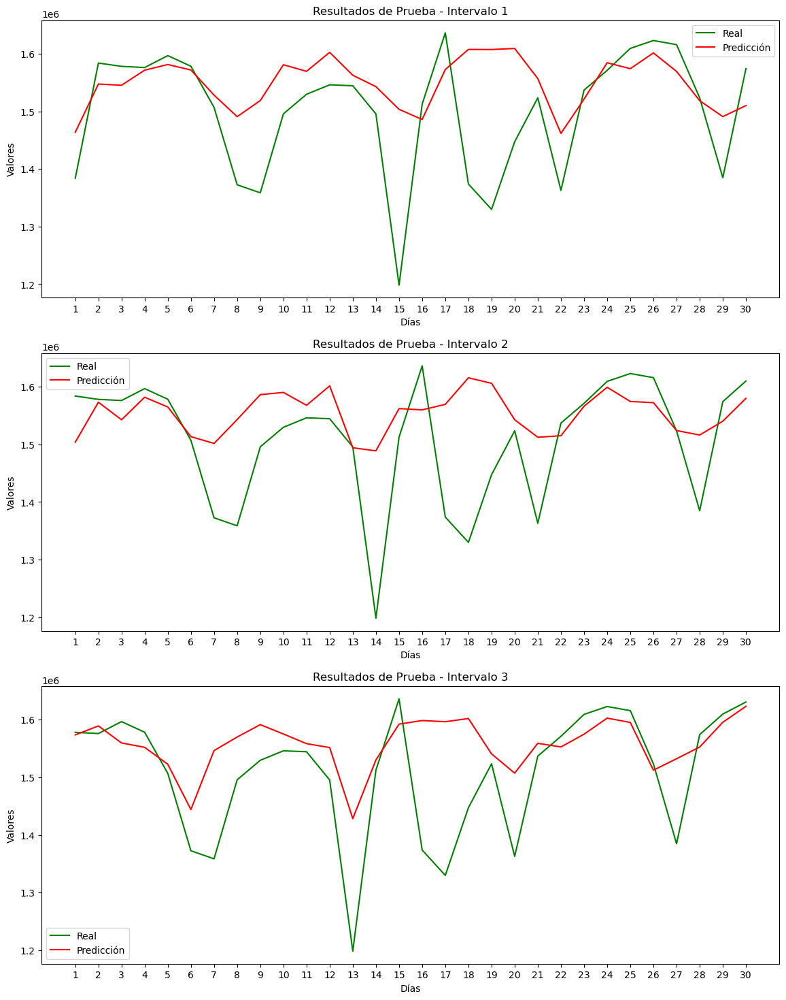

Reloading Tuner from my_dir\MLP_tunning_19\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 65063.1797 
Test Loss: 64945.83984375
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 


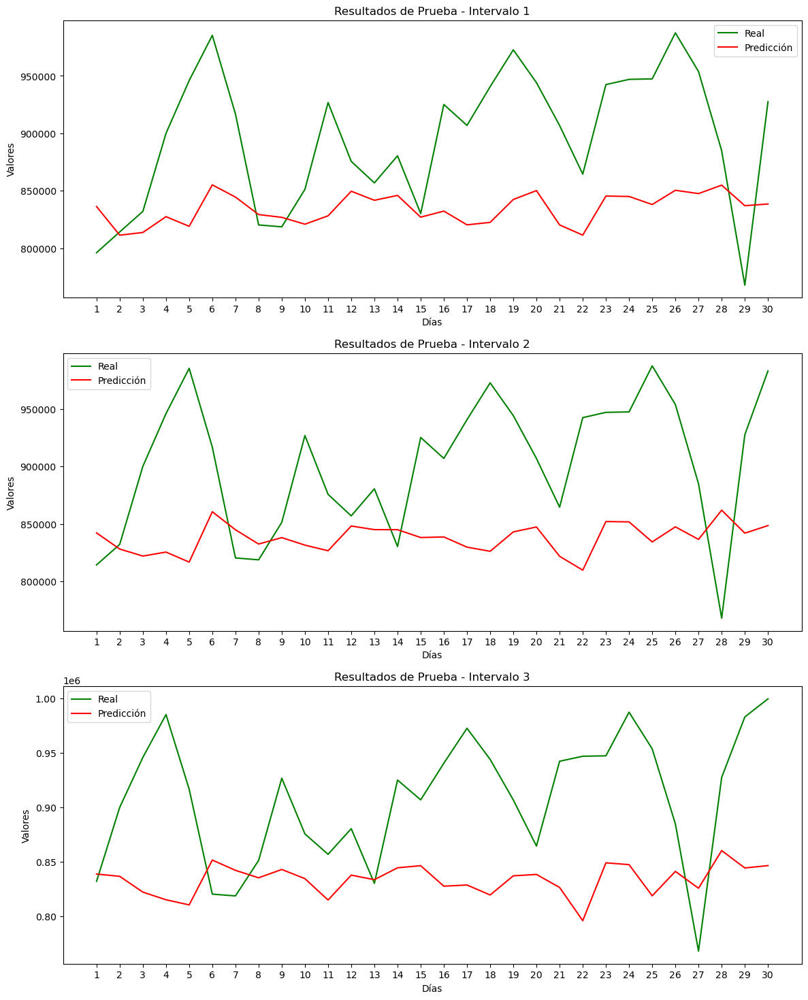

Reloading Tuner from my_dir\CNN_tunning_19\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 66286.4609
Test Loss: 64486.58203125
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


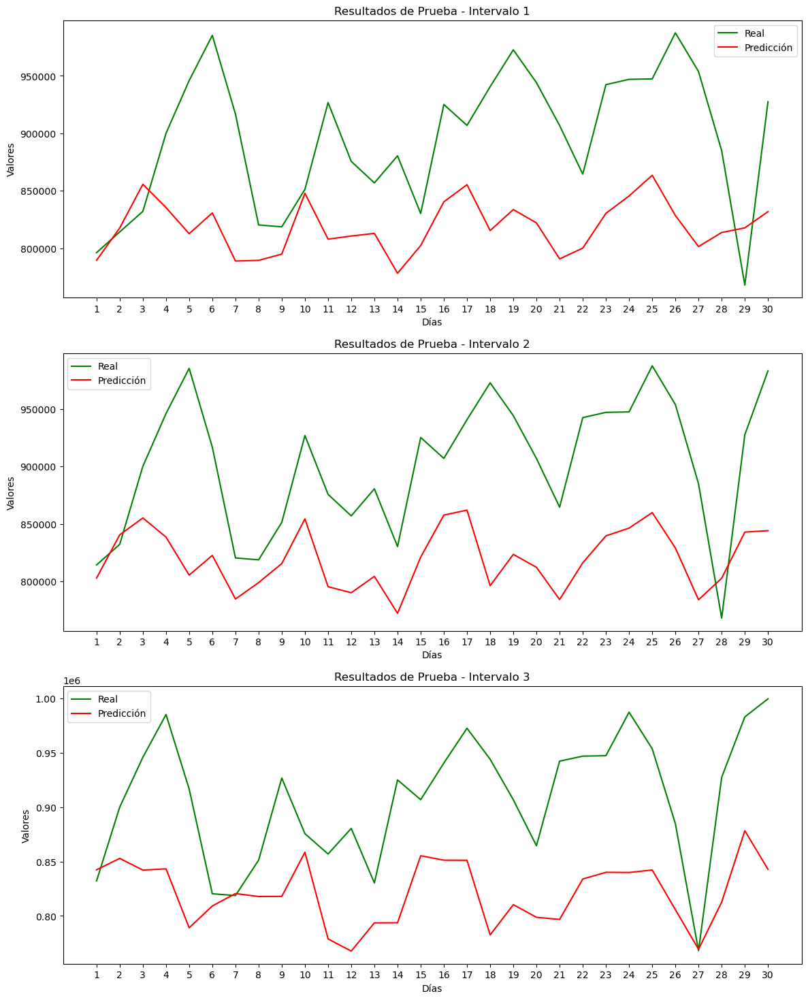

Reloading Tuner from my_dir\MLP_tunning_20\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 37154.66419
Test Loss: 34111.98828125
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step  


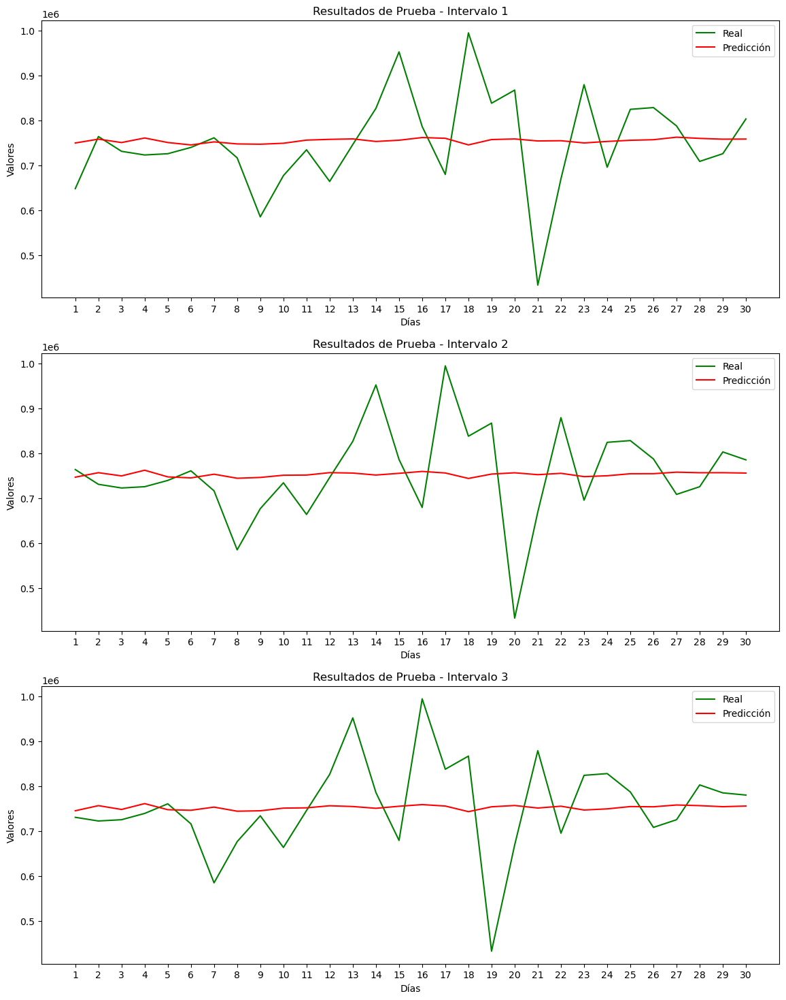

Reloading Tuner from my_dir\CNN_tunning_20\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 37240.9453
Test Loss: 34209.28125
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


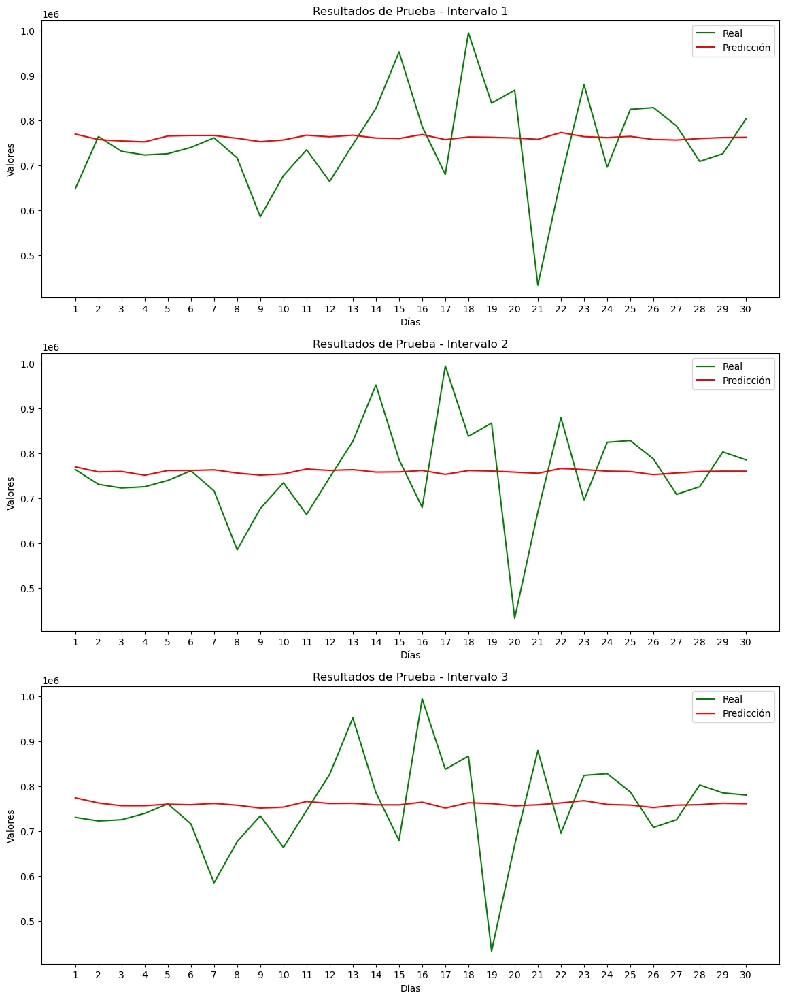

Reloading Tuner from my_dir\MLP_tunning_21\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 38759.2031 
Test Loss: 39835.70703125
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step  


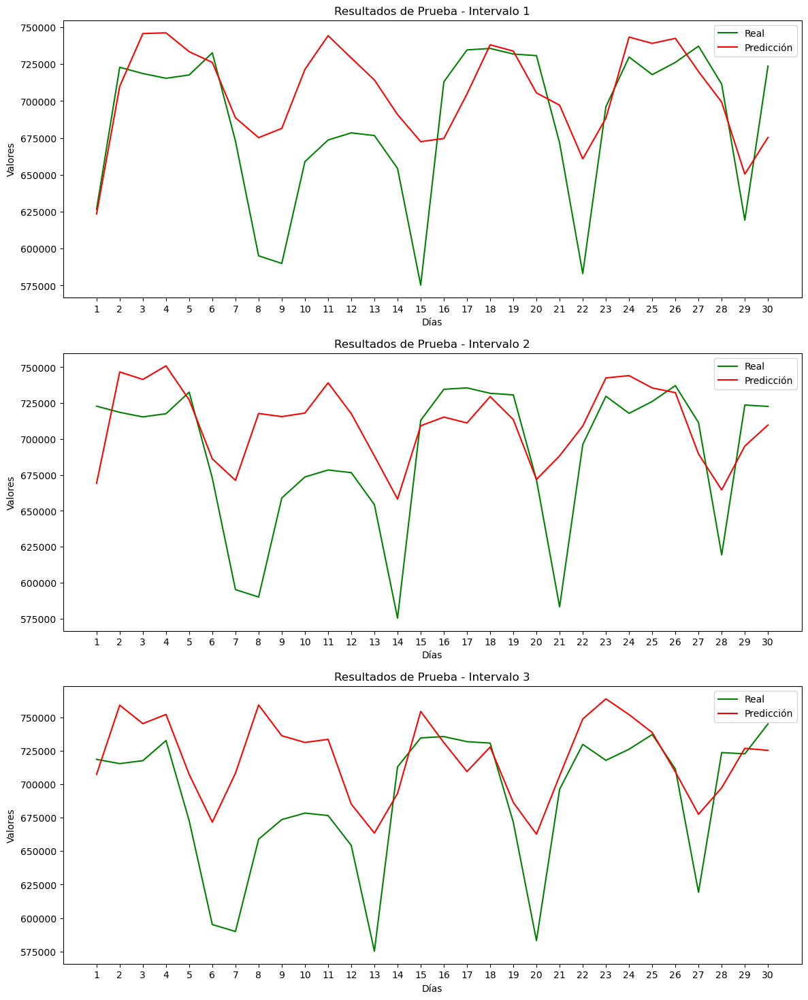

Reloading Tuner from my_dir\CNN_tunning_21\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 37455.1914
Test Loss: 38586.30859375
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step


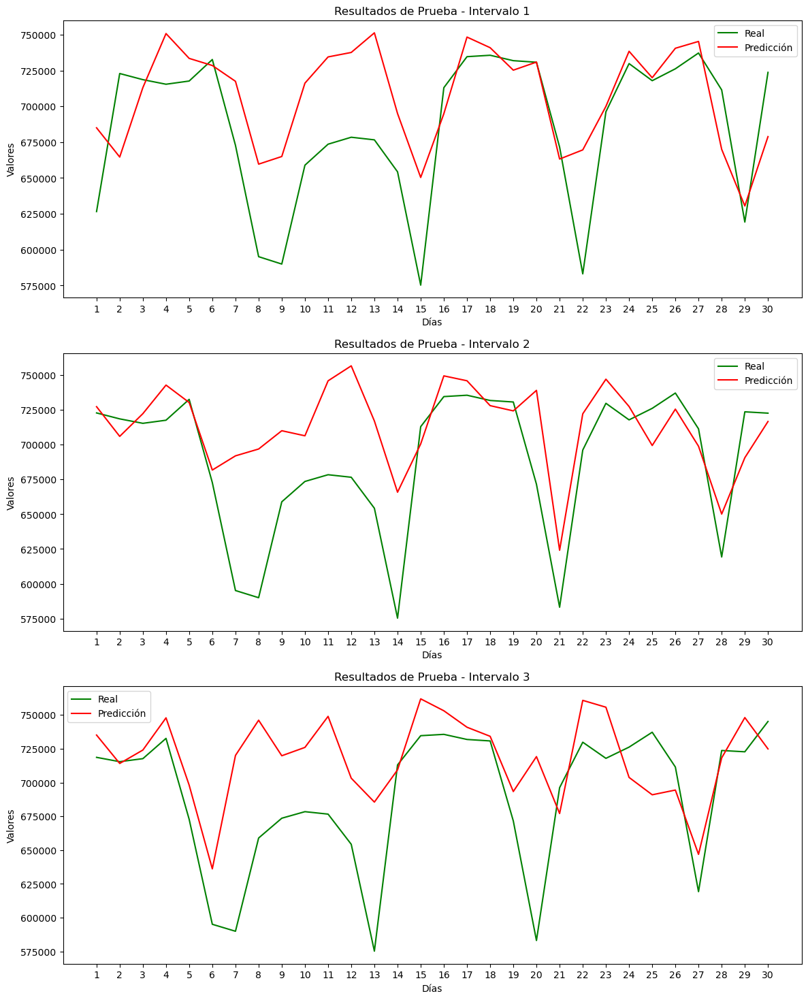

Reloading Tuner from my_dir\MLP_tunning_22\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 36028.7266
Test Loss: 37601.5703125
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step  


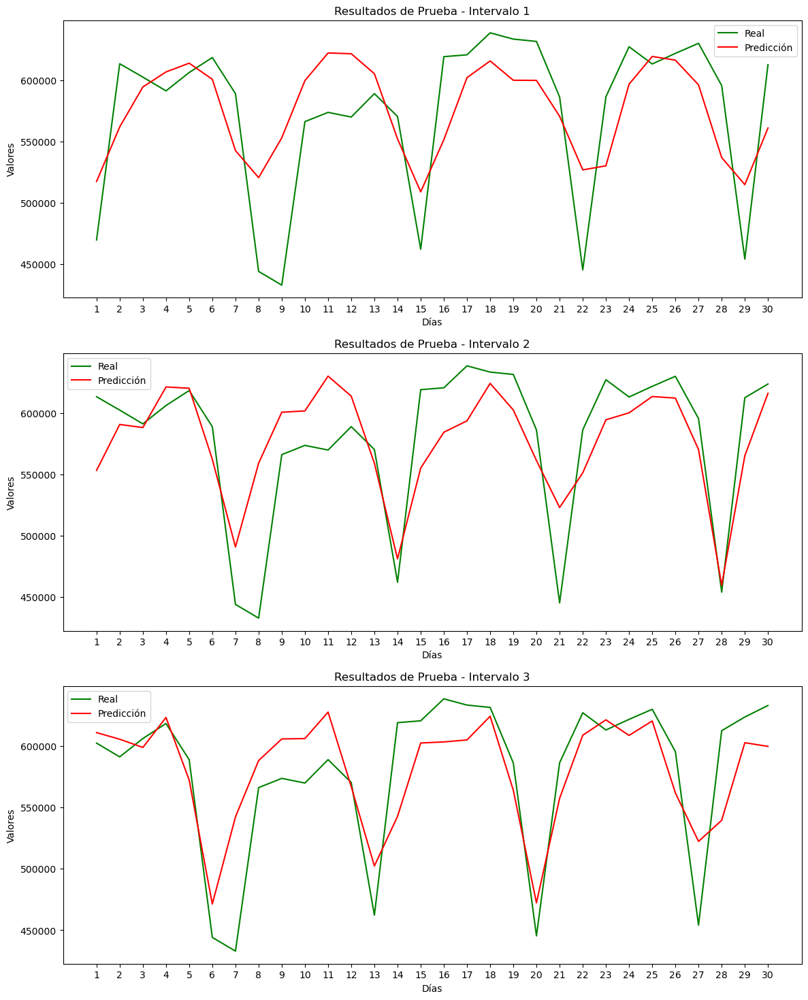

Reloading Tuner from my_dir\CNN_tunning_22\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 33096.4297
Test Loss: 35489.125
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


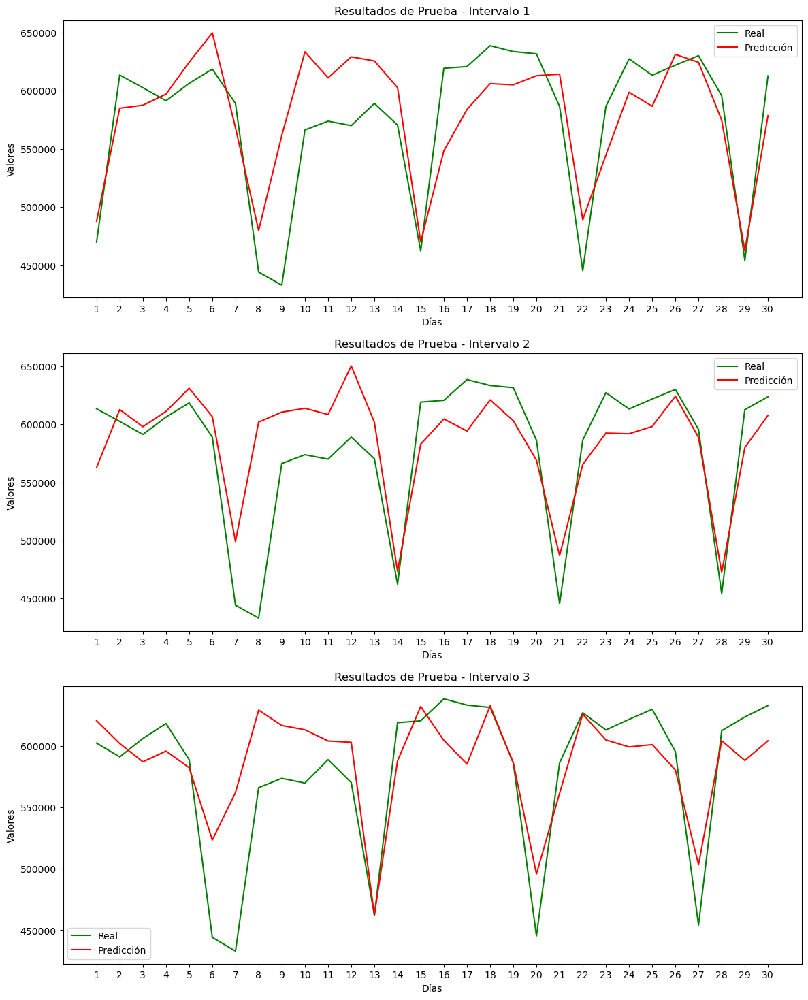

Reloading Tuner from my_dir\MLP_tunning_23\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 18318.9160 
Test Loss: 17806.806640625
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step  


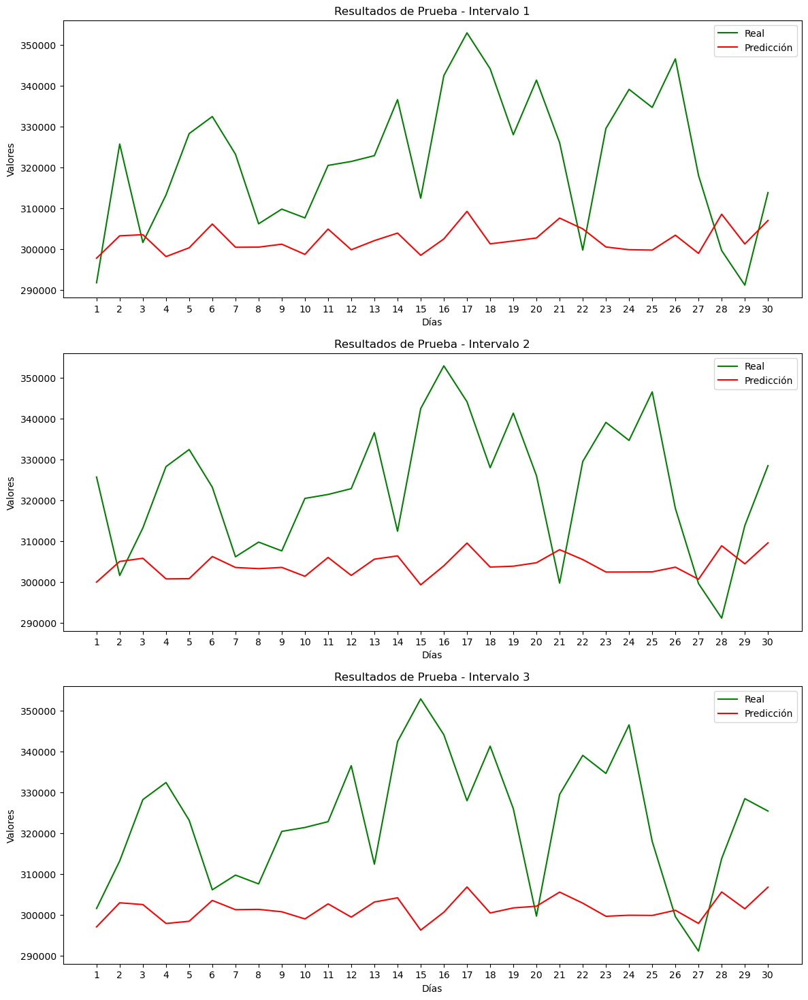

Reloading Tuner from my_dir\CNN_tunning_23\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 17548.1934
Test Loss: 17498.185546875
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


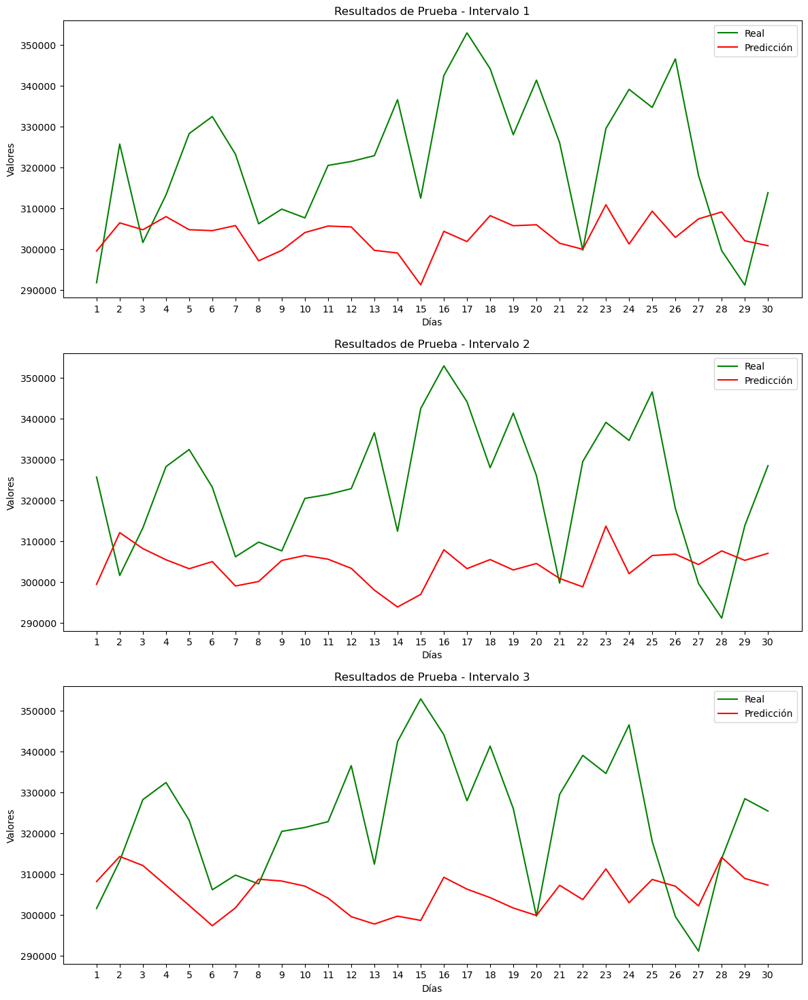

Reloading Tuner from my_dir\MLP_tunning_24\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 18650.4961 
Test Loss: 17969.5703125
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 


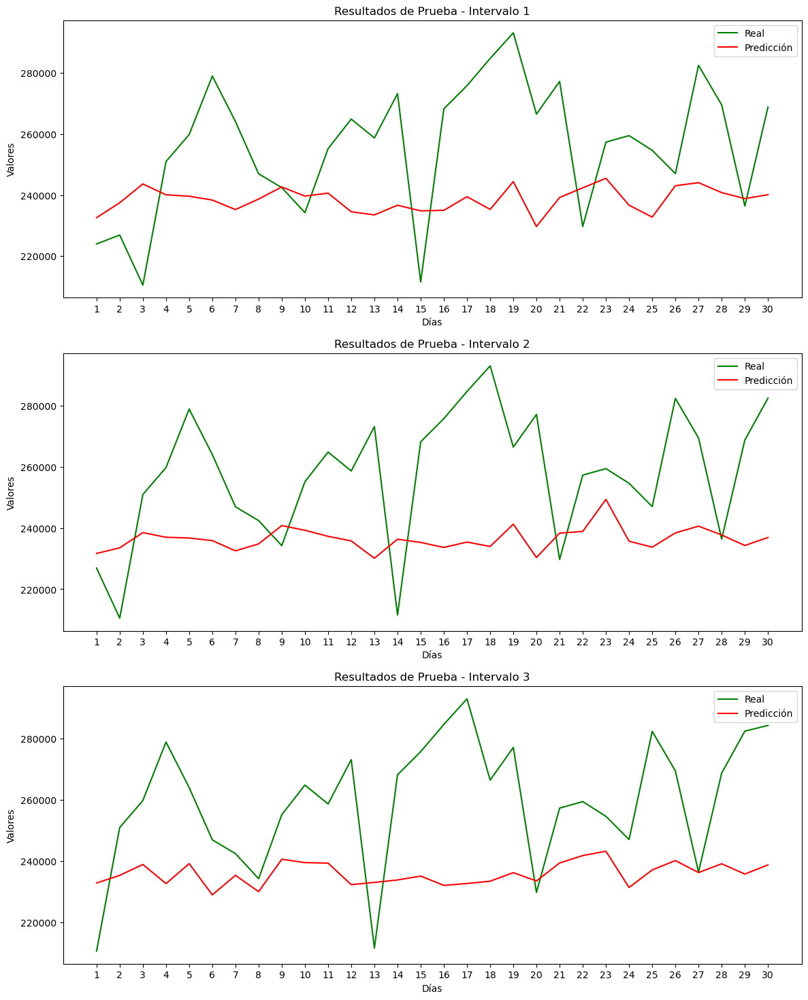

Reloading Tuner from my_dir\CNN_tunning_24\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 18258.7070
Test Loss: 17642.533203125
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


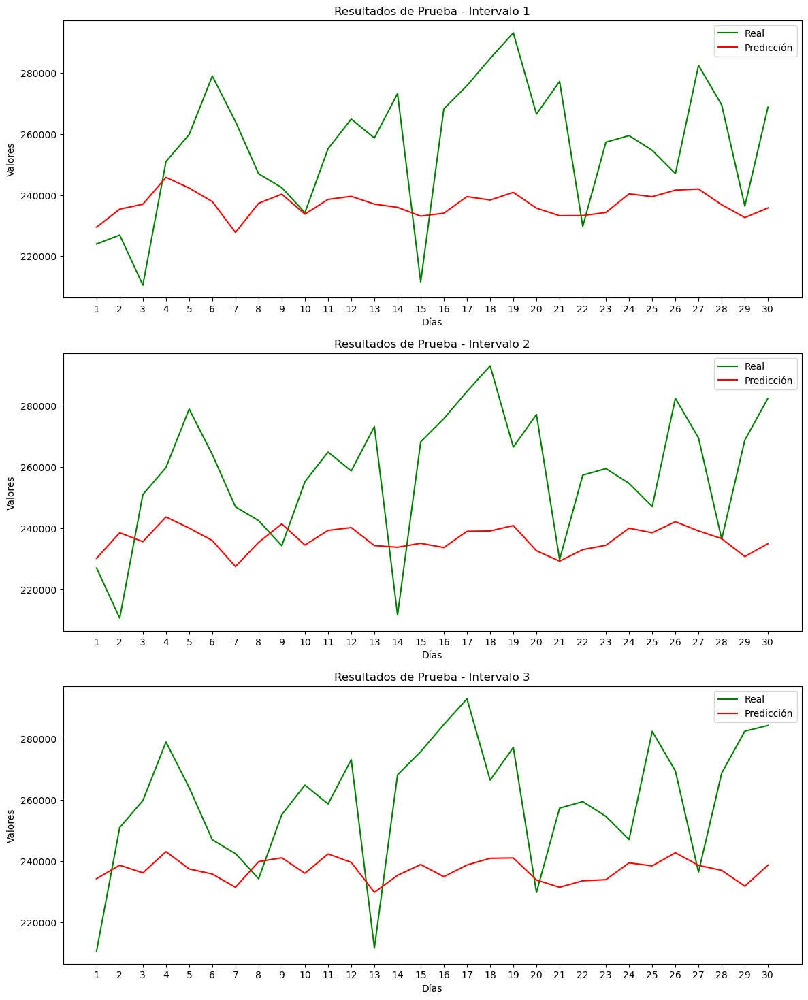

Reloading Tuner from my_dir\MLP_tunning_25\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 16174.04399
Test Loss: 15967.7900390625
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


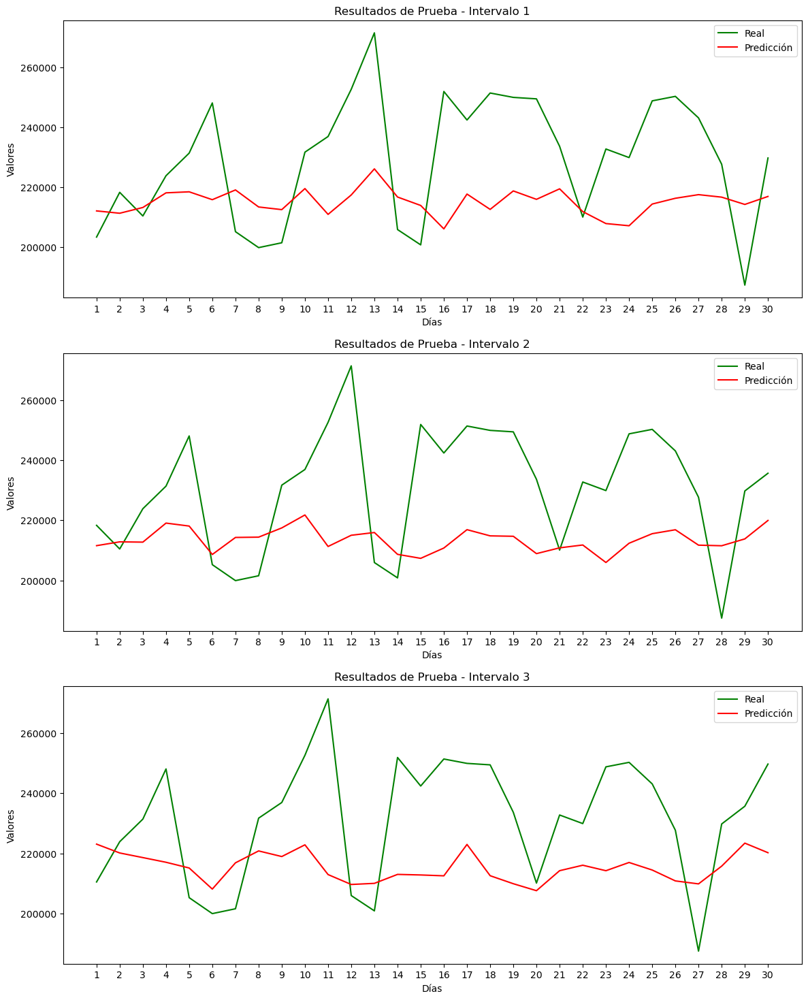

Reloading Tuner from my_dir\CNN_tunning_25\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 15052.5479
Test Loss: 15380.2080078125
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step


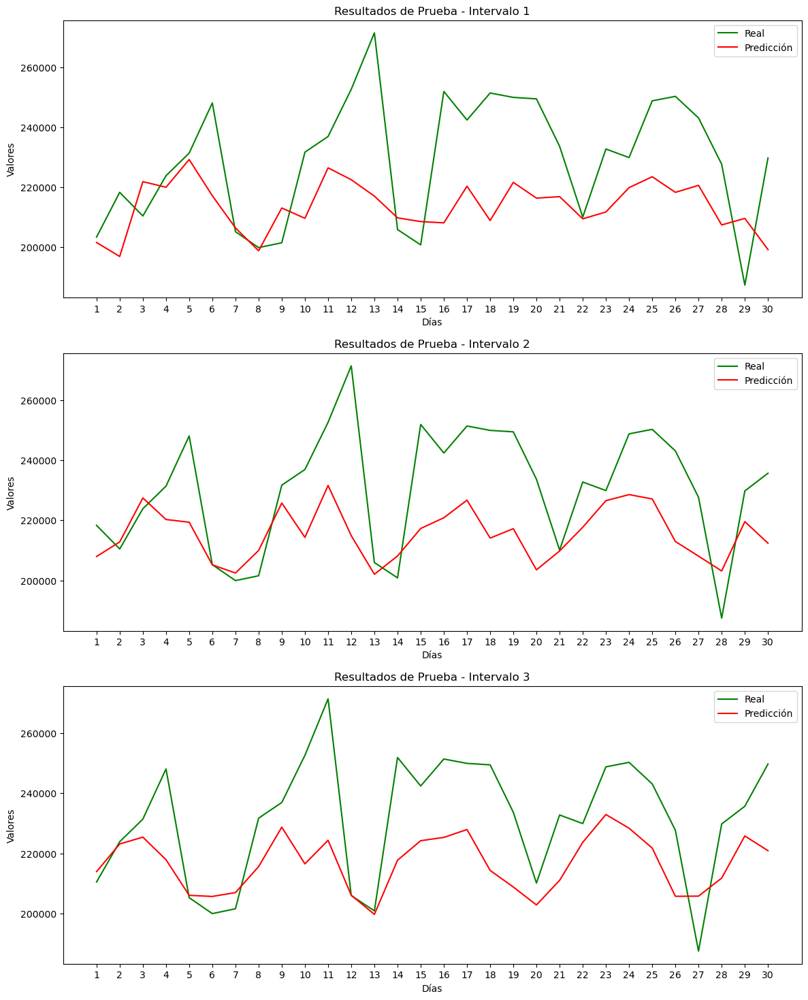

Reloading Tuner from my_dir\MLP_tunning_26\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2051.5103
Test Loss: 2146.740234375
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step  


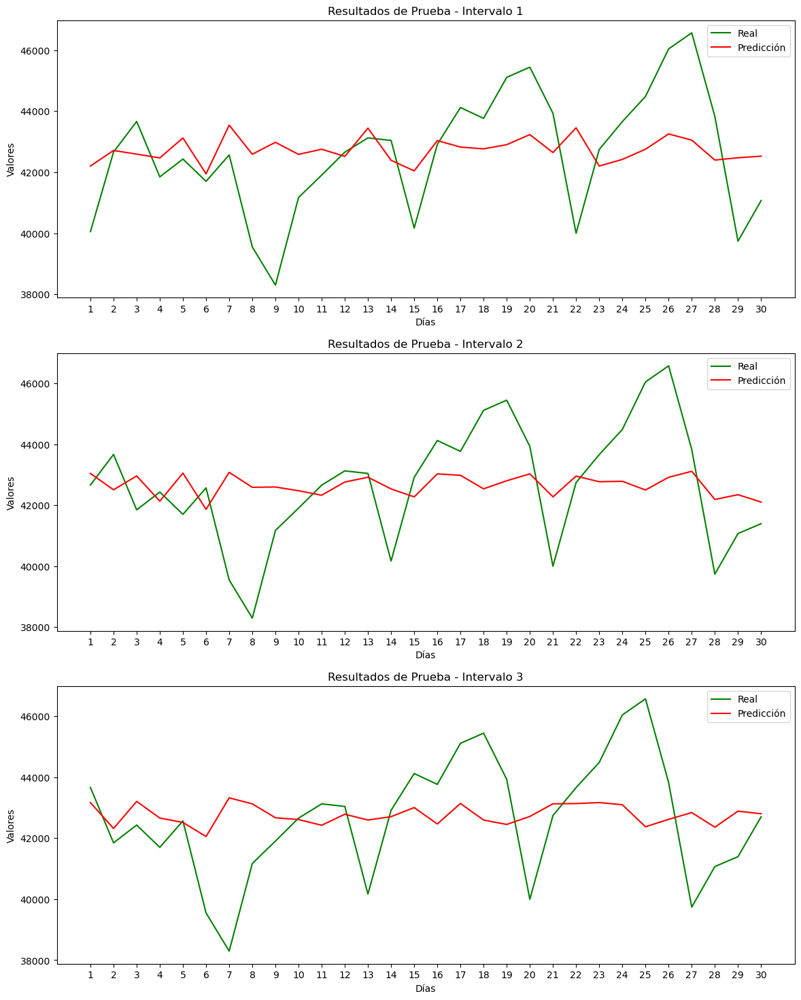

Reloading Tuner from my_dir\CNN_tunning_26\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1965.0900
Test Loss: 2043.1221923828125
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


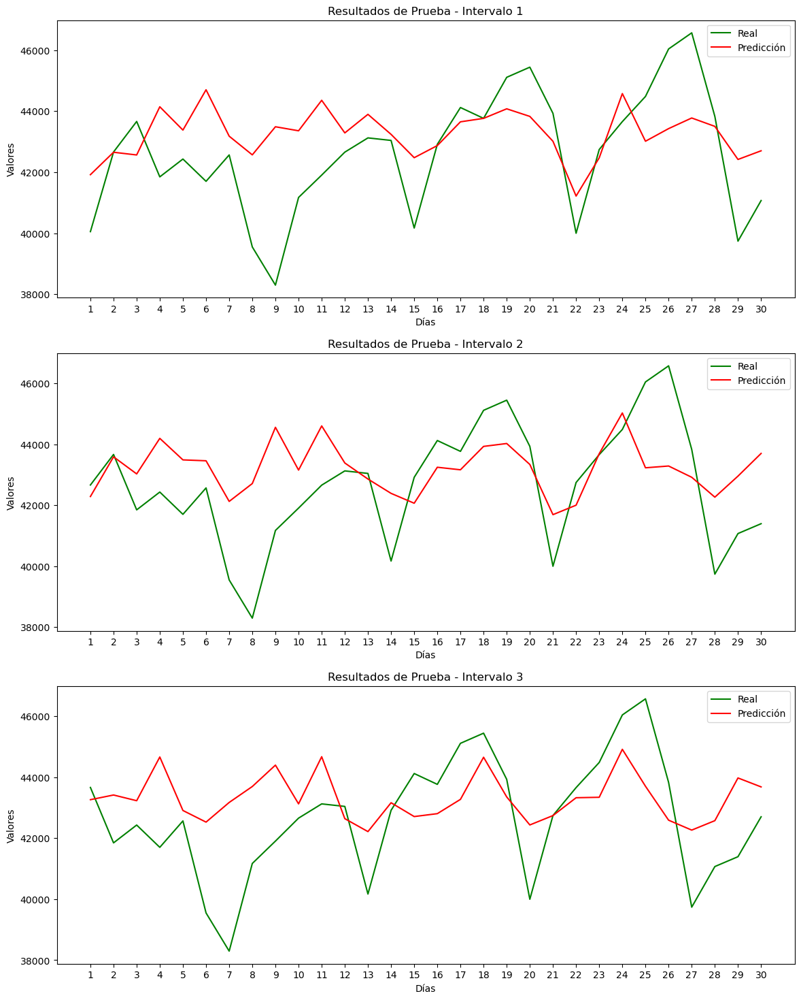

Reloading Tuner from my_dir\MLP_tunning_27\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1301.0907
Test Loss: 1189.4114990234375
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step  


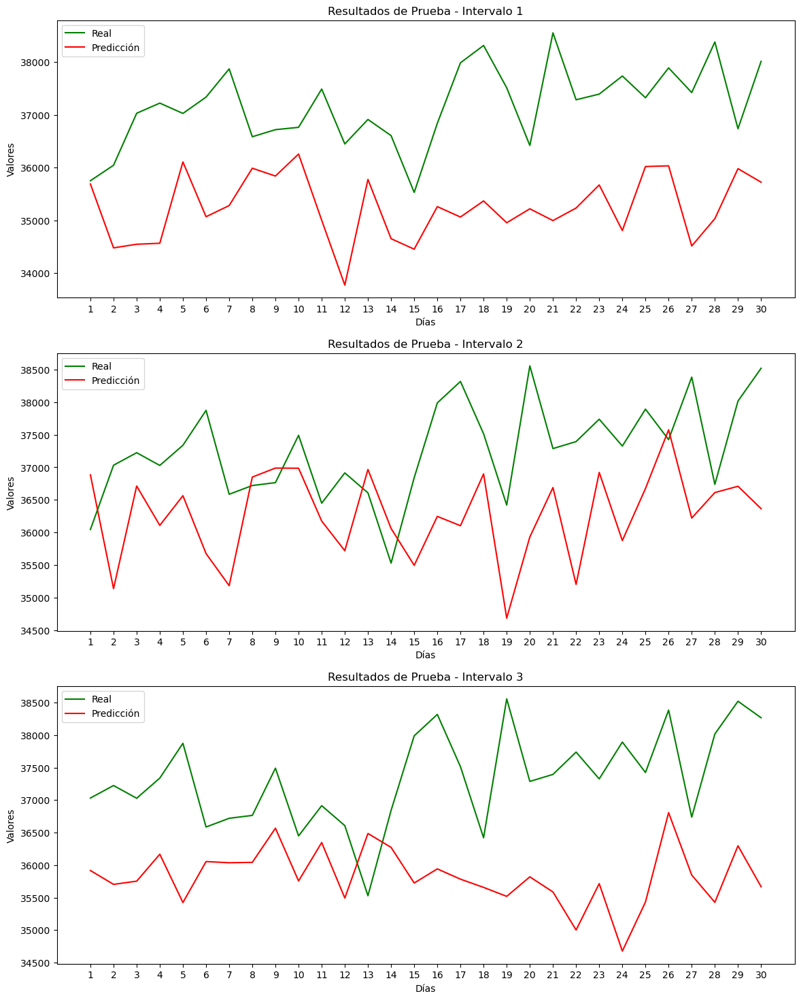

Reloading Tuner from my_dir\CNN_tunning_27\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 1262.7969
Test Loss: 1256.6195068359375
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step


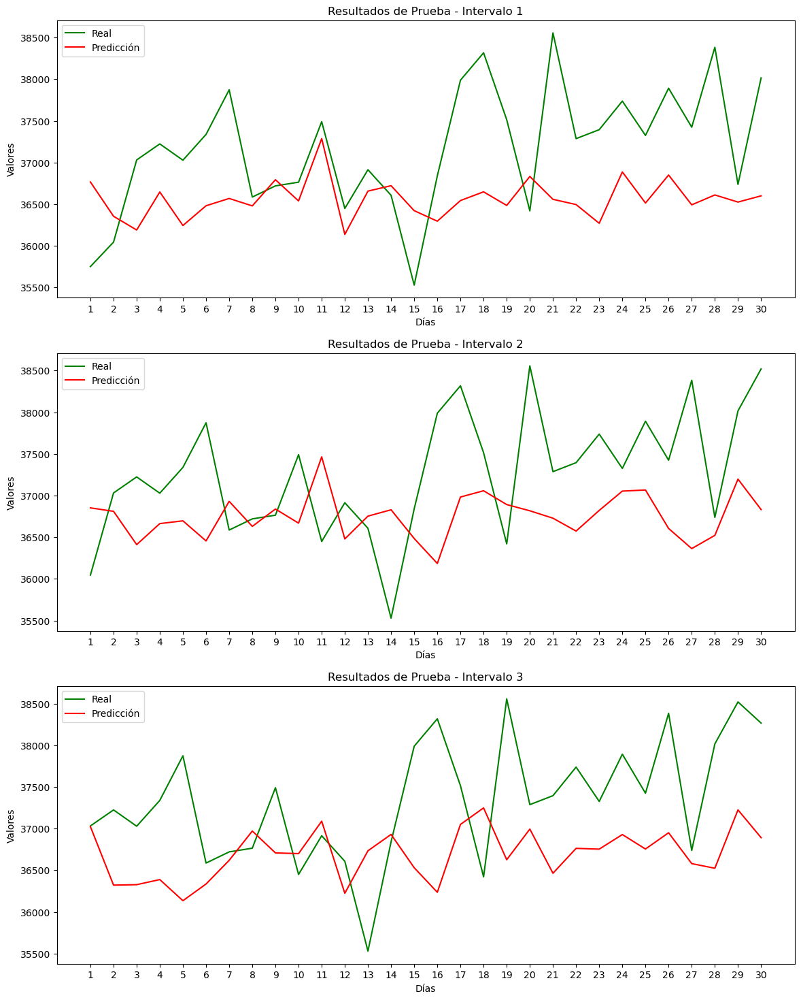

Reloading Tuner from my_dir\MLP_tunning_28\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1336.1951
Test Loss: 1378.2159423828125
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


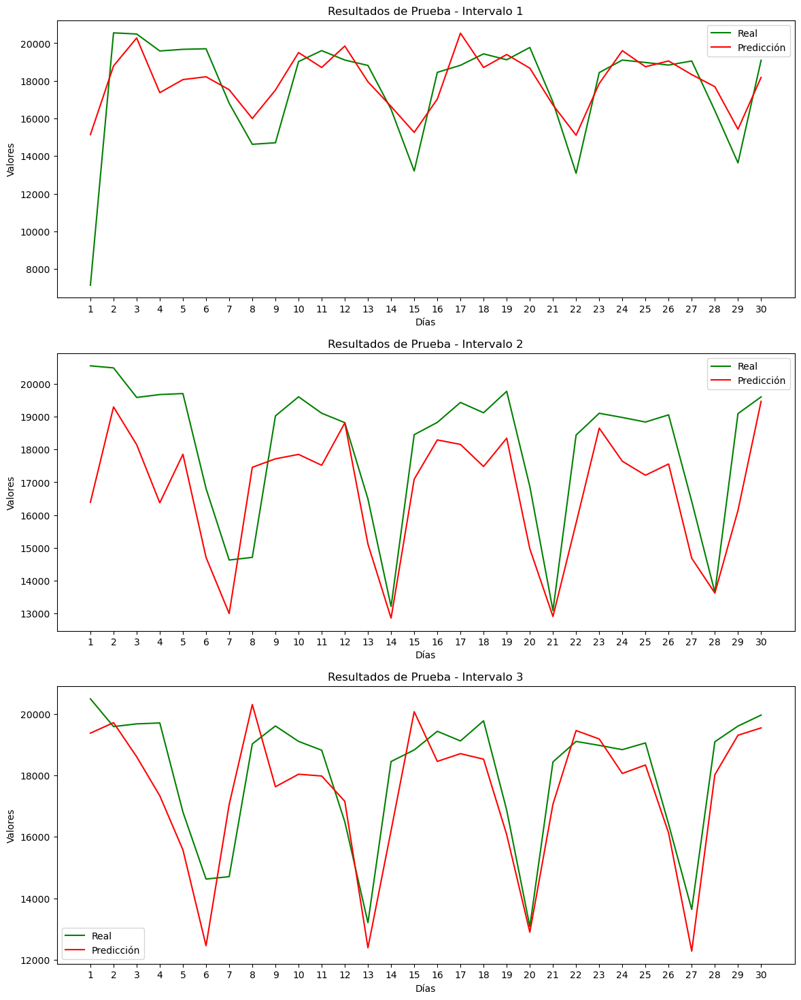

Reloading Tuner from my_dir\CNN_tunning_28\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 1190.5305
Test Loss: 1244.6104736328125
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


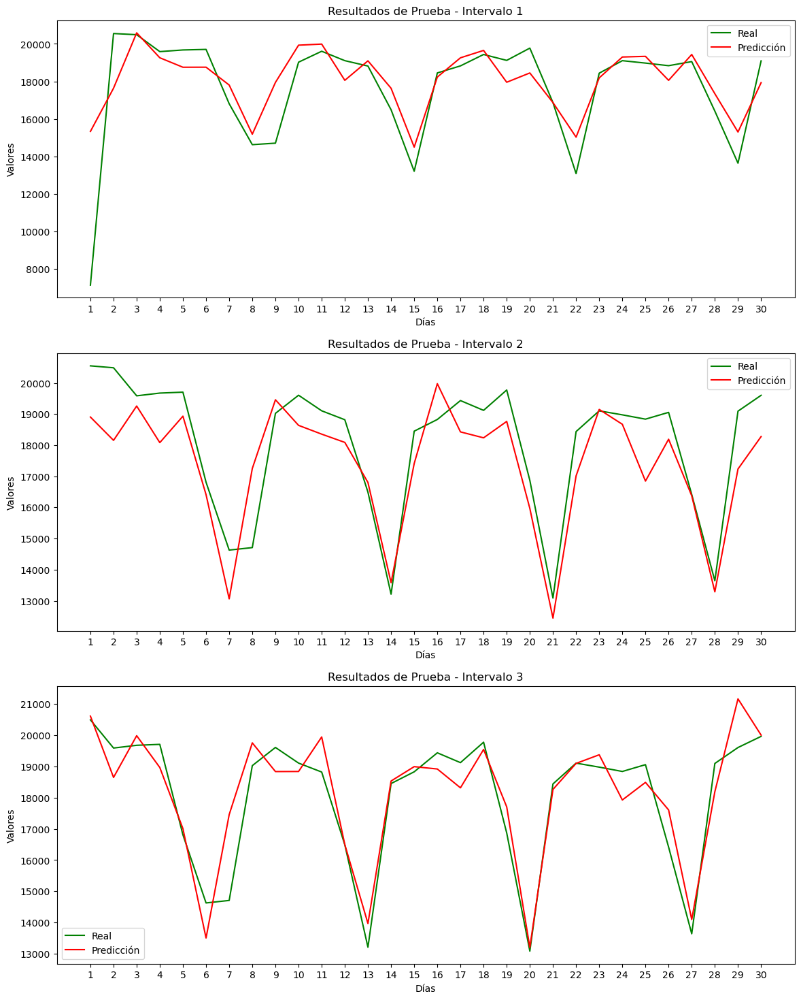

Reloading Tuner from my_dir\MLP_tunning_29\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 2183.3779
Test Loss: 3028.83837890625
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step  


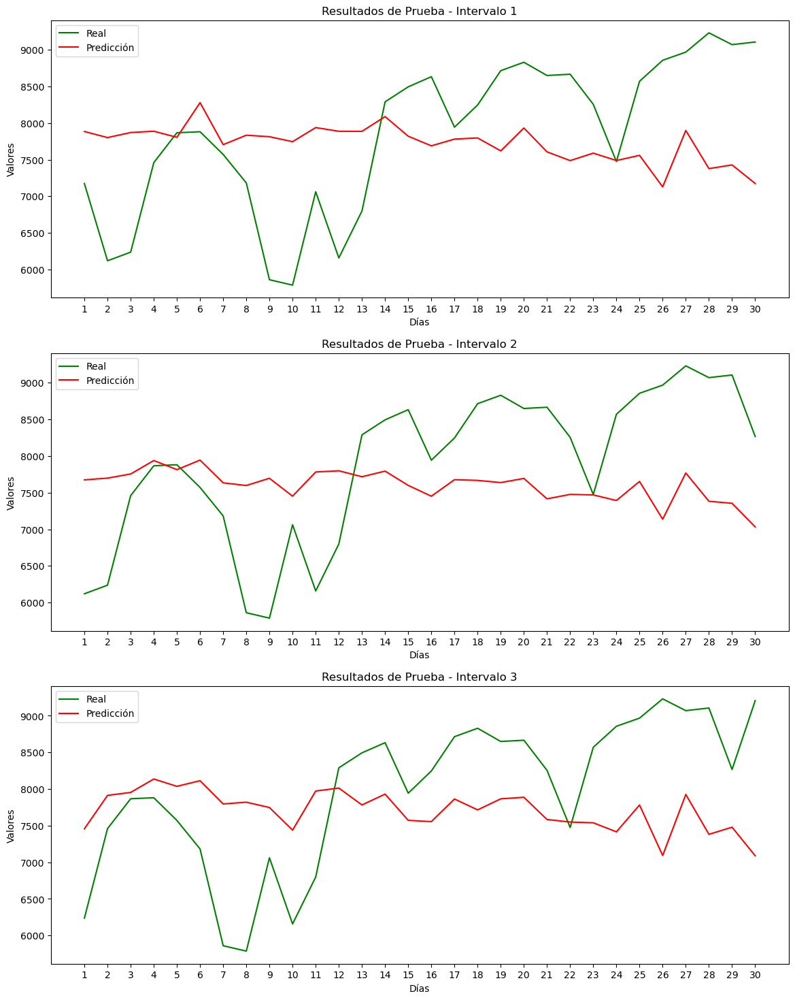

Reloading Tuner from my_dir\CNN_tunning_29\tuner0.json


c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
c:\Users\Nicolas Estepa\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:719: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 2280.8044
Test Loss: 3109.373046875
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step  


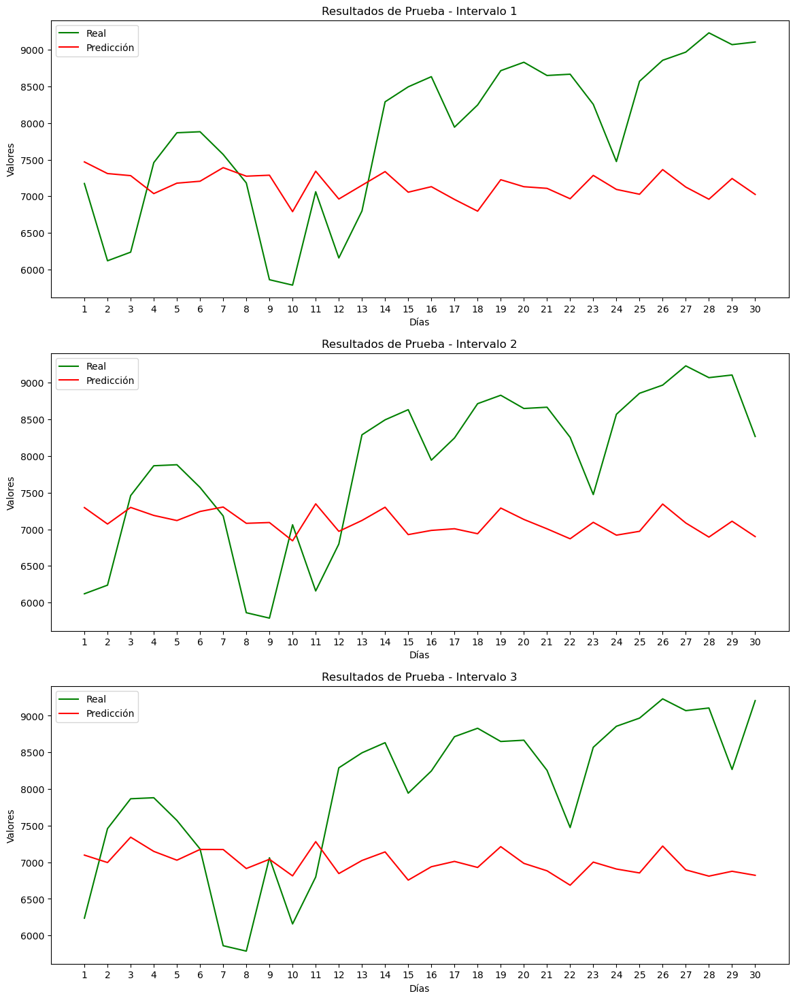

In [ ]:
best_model_MLP = {}                     # Arreglo vacío para guardar los resultados de los modelos de tipo MLP de cada región
best_hyperparameters_MLP = {}           # Arreglo vacío para guardar los resultados de los hiperparámetros de los modelos de tipo MLP de cada región
best_model_CNN = {}                     # Arreglo vacío para guardar los resultados de los modelos de tipo CNN de cada región
best_hyperparameters_CNN = {}           # Arreglo vacío para guardar los resultados de los hiperparámetros de los modelos de tipo CNN de cada región
best_model_LSTM = {}                     # Arreglo vacío para guardar los resultados de los modelos de tipo LSTM de cada región
best_hyperparameters_LSTM = {}           # Arreglo vacío para guardar los resultados de los hiperparámetros de los modelos de tipo LSTM de cada región

for i in top_ciudades:
    j = top_ciudades.index(i)
    best_model_MLP[i], best_hyperparameters_MLP[i] = generate_model_MLP(matriz_modelo[top_ciudades[j]], f"MLP_tunning_{j}")
    best_model_CNN[i], best_hyperparameters_CNN[i] = generate_model_CNN(matriz_modelo[top_ciudades[j]], f"CNN_tunning_{j}")
    best_model_LSTM[i], best_hyperparameters_LSTM[i] = generate_model_LSTM(matriz_modelo[top_ciudades[j]], f"LSTM_tunning_{j}")

# 4. Pruebas métricas para selección del modelo

## 4.1. Funciones necesarias para el cálculo

In [34]:
# Calculo de las métricas MSE y MAE para la comparación de resultados
def calcular_metricas(y_true, y_pred):
    mse = mean_squared_error(y_true, y_pred)
    mae = mean_absolute_error(y_true, y_pred)
    return {"MSE": mse, "MAE": mae}

In [ ]:
# Función necesaria para reconocer el modelo LSTM, debido a que es necesario modificar el formato para evaluar el modelo
def is_lstm_model(model):
    for layer in model.layers:
        if isinstance(layer, LSTM):
            return True
    return False

In [ ]:
from sklearn.model_selection import train_test_split

# Ejecución de pruebas A/B para comparar las metricas MSE y MAE para escoger el mejor modelo
def pruebas_ab(control, variant, matriz_modelo, ciudad):
    X = matriz_modelo.drop(columns=[f'r-{i+1}' for i in range(30)])
    y = matriz_modelo[[f'r-{i+1}' for i in range(30)]]

    xtestA, xtestB, ytestA, ytestB = train_test_split(X, y, test_size=0.5)

    if is_lstm_model(control):
        xtestA = np.reshape(xtestA, (xtestA.shape[0], 1, xtestA.shape[1]))      # Modificación del formato de la entrada para evualar el modelo LSTM

    if is_lstm_model(variant):
        xtestB = np.reshape(xtestB, (xtestB.shape[0], 1, xtestB.shape[1]))      # Modificación del formato de la entrada para evualar el modelo LSTM
    
    ypred_control=control.predict(xtestA)
    ypred_variant=variant.predict(xtestB)

    # Métricas para cada modelo
    metrics_control = calcular_metricas(ytestA, ypred_control)
    metrics_variant = calcular_metricas(ytestB, ypred_variant)

    print(f"Métricas Modelo A de {ciudad}:", metrics_control)
    print(f"Métricas Modelo B de {ciudad}:", metrics_variant)

    # Se escoge el mejor modelo a partir del que tenga menor error absoluto
    if metrics_control["MAE"] < metrics_variant["MAE"]:
        mejor_modelo = control
        mejores_metricas = metrics_control         
    else:
        mejor_modelo = variant
        mejores_metricas = metrics_variant

    return mejor_modelo, mejores_metricas       # Retorno de las metricas y mejor modelo para evaluar en un futuro el modelo

## 4.2. Obtención del mejor modelo a partir de pruebas A/B

In [ ]:
mejor_modelo = {}           # Arreglo vacío para almacenar el mejor modelo por región
metrics = {}                # Arreglo vacío para las metricas del mejor modelo
for i in top_ciudades:
    j = top_ciudades.index(i)
    mejor_modelo[i], metrics[i] = pruebas_ab(best_model_MLP[i], best_model_CNN[i], matriz_modelo[top_ciudades[j]], i)       # Almacenamiento del mejor modelo por región, el apuntador es el nombre de la región
    mejor_modelo[i], metrics[i] = pruebas_ab(mejor_modelo[i], best_model_LSTM[i], matriz_modelo[top_ciudades[j]], i)       # Almacenamiento del mejor modelo por región, el apuntador es el nombre de la región
    mejor_modelo[i].save(f"./modelos/{i}.h5")       # Almacenamiento del modelo en la ruta ./modelos con el nombre de la región

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


Métricas Modelo A de BOGOTA - CUNDINAMARCA: {'MSE': 7119351436590.615, 'MAE': 1893388.156658843}
Métricas Modelo B de BOGOTA - CUNDINAMARCA: {'MSE': 6879347067687.174, 'MAE': 1834659.4725018265}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step


Métricas Modelo A de CARIBE MAR: {'MSE': 2817133211659.448, 'MAE': 1311025.124417841}
Métricas Modelo B de CARIBE MAR: {'MSE': 2533748956061.8223, 'MAE': 1239366.4599040167}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step


Métricas Modelo A de ANTIOQUIA: {'MSE': 3630065606982.417, 'MAE': 1326169.0748508093}
Métricas Modelo B de ANTIOQUIA: {'MSE': 3240387346330.5425, 'MAE': 1274015.954301513}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


Métricas Modelo A de CARIBE SOL: {'MSE': 3419300213527.269, 'MAE': 1419917.7162608246}
Métricas Modelo B de CARIBE SOL: {'MSE': 3998604798478.8403, 'MAE': 1533206.0828095987}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


Métricas Modelo A de CALI - YUMBO - PUERTO TEJADA: {'MSE': 1040361852335.0287, 'MAE': 757403.8639227959}
Métricas Modelo B de CALI - YUMBO - PUERTO TEJADA: {'MSE': 922830245091.6177, 'MAE': 670949.0427245698}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


Métricas Modelo A de SANTANDER: {'MSE': 309431672683.906, 'MAE': 434286.8656781429}
Métricas Modelo B de SANTANDER: {'MSE': 310655896350.3455, 'MAE': 423141.612342723}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step


Métricas Modelo A de BOYACA: {'MSE': 334475888462.58215, 'MAE': 470609.52066458}
Métricas Modelo B de BOYACA: {'MSE': 329188218753.15375, 'MAE': 465038.78935524245}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


Métricas Modelo A de VALLE DEL CAUCA: {'MSE': 294617382204.85333, 'MAE': 414384.1945216483}
Métricas Modelo B de VALLE DEL CAUCA: {'MSE': 302654947806.2284, 'MAE': 410351.6218231612}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


Métricas Modelo A de META: {'MSE': 305610914846.8353, 'MAE': 421520.44217736047}
Métricas Modelo B de META: {'MSE': 318387974714.9754, 'MAE': 419019.2206134586}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step


Métricas Modelo A de NORTE DE SANTANDER: {'MSE': 149367625714.06223, 'MAE': 299827.5292842984}
Métricas Modelo B de NORTE DE SANTANDER: {'MSE': 174157561852.03195, 'MAE': 319575.84973813273}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


Métricas Modelo A de CALDAS: {'MSE': 92543107465.55113, 'MAE': 225562.16779081902}
Métricas Modelo B de CALDAS: {'MSE': 87622821073.60814, 'MAE': 216367.88202973394}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step


Métricas Modelo A de TOLIMA: {'MSE': 69138453885.5836, 'MAE': 208605.17301356286}
Métricas Modelo B de TOLIMA: {'MSE': 62883713840.25952, 'MAE': 198852.22432290038}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step


Métricas Modelo A de HUILA: {'MSE': 46881025704.483955, 'MAE': 172555.90840010435}
Métricas Modelo B de HUILA: {'MSE': 38628122698.165726, 'MAE': 155089.9458753261}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


Métricas Modelo A de CAUCA: {'MSE': 58379492766.25164, 'MAE': 165289.5090975483}
Métricas Modelo B de CAUCA: {'MSE': 51932686157.68666, 'MAE': 155988.78756338035}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step


Métricas Modelo A de ARAUCA: {'MSE': 121933235631.82935, 'MAE': 162545.29607955136}
Métricas Modelo B de ARAUCA: {'MSE': 124880296862.84367, 'MAE': 172720.7103090767}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step


Métricas Modelo A de NARIÑO: {'MSE': 13940468552.94098, 'MAE': 76967.42441627545}
Métricas Modelo B de NARIÑO: {'MSE': 12804478315.075733, 'MAE': 73436.95561450183}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step


Métricas Modelo A de PEREIRA: {'MSE': 18586573352.202686, 'MAE': 96012.78313302036}
Métricas Modelo B de PEREIRA: {'MSE': 14960643345.323336, 'MAE': 87311.33543166405}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step


Métricas Modelo A de CASANARE: {'MSE': 19437605318.07936, 'MAE': 109849.35479603549}
Métricas Modelo B de CASANARE: {'MSE': 17850247170.48762, 'MAE': 104847.61286619719}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step


Métricas Modelo A de QUINDIO: {'MSE': 5064668941.304733, 'MAE': 53800.72994887847}
Métricas Modelo B de QUINDIO: {'MSE': 4488320620.084088, 'MAE': 49961.39036306728}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step


Métricas Modelo A de CAQUETA: {'MSE': 5665944009.399148, 'MAE': 57180.510141888364}
Métricas Modelo B de CAQUETA: {'MSE': 5442148048.705532, 'MAE': 55418.46257811684}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


Métricas Modelo A de CHOCO: {'MSE': 2216802339.0640707, 'MAE': 32310.198099504436}
Métricas Modelo B de CHOCO: {'MSE': 2332746956.7509894, 'MAE': 32698.639839071468}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step


Métricas Modelo A de TULUA: {'MSE': 2666904366.7463074, 'MAE': 39807.27358568074}
Métricas Modelo B de TULUA: {'MSE': 2603871889.241106, 'MAE': 39300.107242044855}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step


Métricas Modelo A de CARTAGO: {'MSE': 1769456975.6465232, 'MAE': 32570.13917038342}
Métricas Modelo B de CARTAGO: {'MSE': 1720265700.4289732, 'MAE': 31053.591706637977}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step


Métricas Modelo A de PUTUMAYO: {'MSE': 598458973.2744297, 'MAE': 16036.473924458787}
Métricas Modelo B de PUTUMAYO: {'MSE': 577370749.5696566, 'MAE': 15392.727624445752}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


Métricas Modelo A de BAJO PUTUMAYO: {'MSE': 546123308.4699305, 'MAE': 16370.302888986704}
Métricas Modelo B de BAJO PUTUMAYO: {'MSE': 524942058.50631833, 'MAE': 15904.703351949665}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step


Métricas Modelo A de GUAVIARE: {'MSE': 342741900.3269524, 'MAE': 13675.078892703443}
Métricas Modelo B de GUAVIARE: {'MSE': 310450220.1209611, 'MAE': 12883.986217364372}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Métricas Modelo A de RUITOQUE: {'MSE': 16731544.795568107, 'MAE': 2585.127542400233}
Métricas Modelo B de RUITOQUE: {'MSE': 17736759.165666595, 'MAE': 2550.844432707354}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


Métricas Modelo A de VALLE DEL SIBUNDOY: {'MSE': 7454326.078522687, 'MAE': 1411.6824304169927}
Métricas Modelo B de VALLE DEL SIBUNDOY: {'MSE': 7563234.535398219, 'MAE': 1509.7495387527715}
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


Métricas Modelo A de POPAYAN - PURACE: {'MSE': 7887463.1374787185, 'MAE': 1970.4284009927626}
Métricas Modelo B de POPAYAN - PURACE: {'MSE': 6889170.744793883, 'MAE': 1824.7127249669904}
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


Métricas Modelo A de SIN CLASIFICAR: {'MSE': 5140194.762413368, 'MAE': 1492.7548440110309}
Métricas Modelo B de SIN CLASIFICAR: {'MSE': 6777773.619771613, 'MAE': 1642.1285629645931}


# 5. Almacenamiento de resultados para la API

## 5.1. Funciones

In [37]:
# Función para almacenamiento de las métricas en un formato tipo json
def calculo_metricas(matriz_modelo, modelo, ruta):
    X = matriz_modelo.drop(columns=[f'r-{i+1}' for i in range(30)])
    y = matriz_modelo[[f'r-{i+1}' for i in range(30)]]
    corte = int(0.7 * len(X))
    X_train = X.iloc[:corte]
    X_test = X.iloc[corte:]
    Y_train = y.iloc[:corte]
    Y_test = y.iloc[corte:]
    trainPredict = modelo.predict(X_train)
    testPredict = modelo.predict(X_test)

    resultados = pd.DataFrame(index=['MSE','RMSE','MAE','R2'],columns=['Train','Test'])

    # calculate mean squared error
    trainScore = mean_squared_error(Y_train, trainPredict)
    resultados.at['MSE','Train'] = '{:.2f}'.format(trainScore)
    testScore = mean_squared_error(Y_test, testPredict)
    resultados.at['MSE','Test'] = '{:.2f}'.format(testScore)
    # calculate root mean squared error
    trainScore = math.sqrt(mean_squared_error(Y_train, trainPredict))
    resultados.at['RMSE','Train'] = '{:.2f}'.format(trainScore)
    testScore = math.sqrt(mean_squared_error(Y_test, testPredict))
    resultados.at['RMSE','Test'] = '{:.2f}'.format(testScore)
    #calculate r2
    trainScore = r2_score(Y_train, trainPredict)
    resultados.at['R2','Train'] = '{:.2f}'.format(trainScore)
    testScore = r2_score(Y_test, testPredict)
    resultados.at['R2','Test'] = '{:.2f}'.format(testScore)
    #calculate MAE
    trainScore = mean_absolute_error(Y_train, trainPredict)
    resultados.at['MAE','Train'] = '{:.2f}'.format(trainScore)
    testScore = mean_absolute_error(Y_test, testPredict)
    resultados.at['MAE','Test'] = '{:.2f}'.format(testScore)

    resultados.to_json(ruta, orient="columns", indent=4)

In [38]:
# Generación de imágenes de los resultados de los modelos para agregar en la página
def guardar_imagenes(matriz_modelo, modelo, title, ciudad, color_real, color_pred, max_plots, ruta, format):
    X = matriz_modelo.drop(columns=[f'r-{i+1}' for i in range(30)])
    y = matriz_modelo[[f'r-{i+1}' for i in range(30)]]
    corte = int(0.7 * len(X))
    X_test = X.iloc[corte:]
    Y_test = y.iloc[corte:]
    testPredict = modelo.predict(X_test)

    days_interval = 30

    num_plots = min(len(Y_test) // days_interval + 1, max_plots)

    fig, axes = plt.subplots(num_plots, 1, figsize=(14, 6 * num_plots))

    if num_plots == 1:
        axes = [axes]

    Y_test = Y_test.values

    for i in range(num_plots):
        x_values = list(range(1, days_interval + 1))
        x_values_strings = [str(x) for x in x_values]
        axes[i].plot(x_values_strings, Y_test[i], color=color_real, label='Real')
        axes[i].plot(x_values_strings, testPredict[i], color=color_pred, label='Predicción')

        # Configuración de cada subgráfico
        axes[i].set_title(f'{title} de {ciudad} - Intervalo {i + 1}')
        axes[i].set_xlabel('Días')
        axes[i].set_ylabel('Valores')
        axes[i].legend()
    
    plt.savefig(ruta, format=format, dpi=300, bbox_inches="tight")

28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
28/28 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
12/12

C:\Users\Nicolas Estepa\AppData\Local\Temp\ipykernel_10832\998910753.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(num_plots, 1, figsize=(14, 6 * num_plots))


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
4/4 ━━

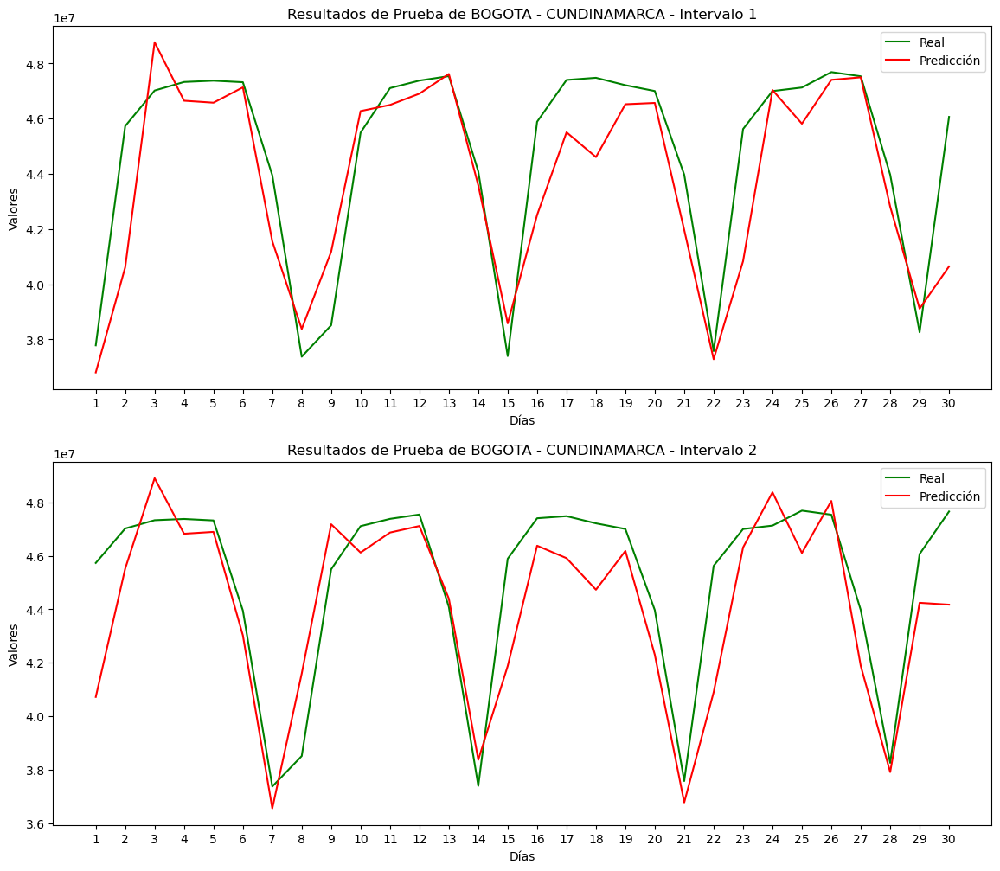

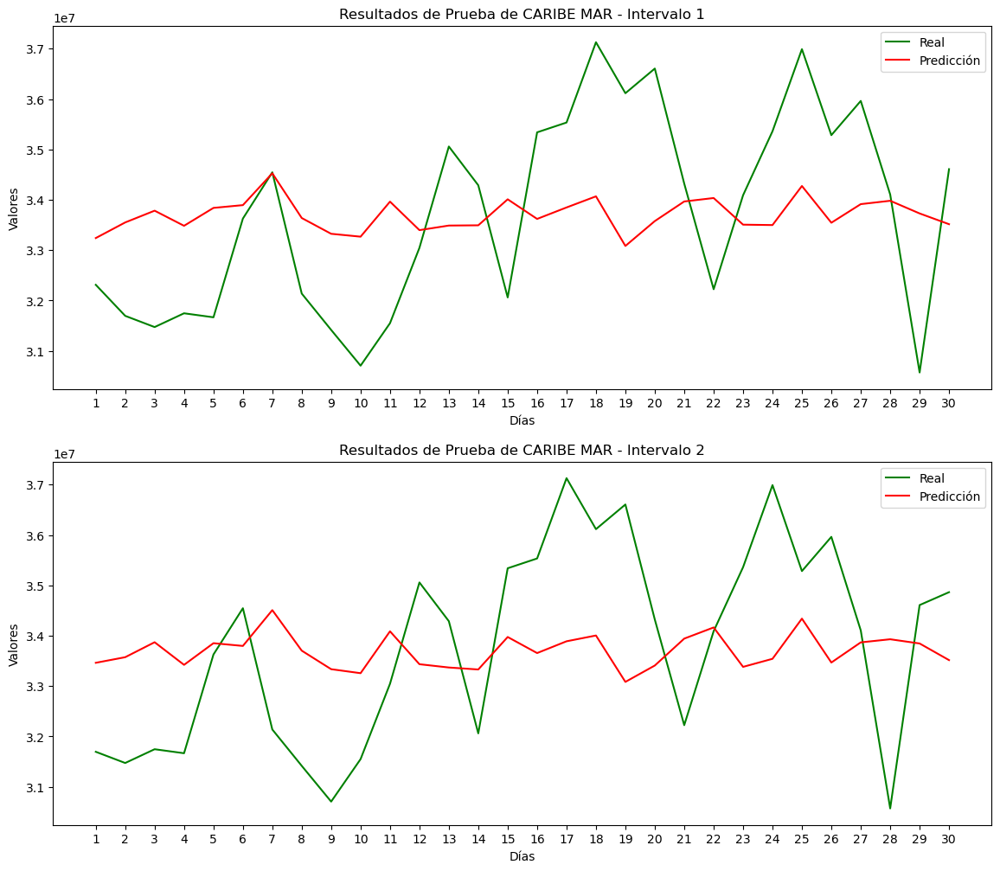

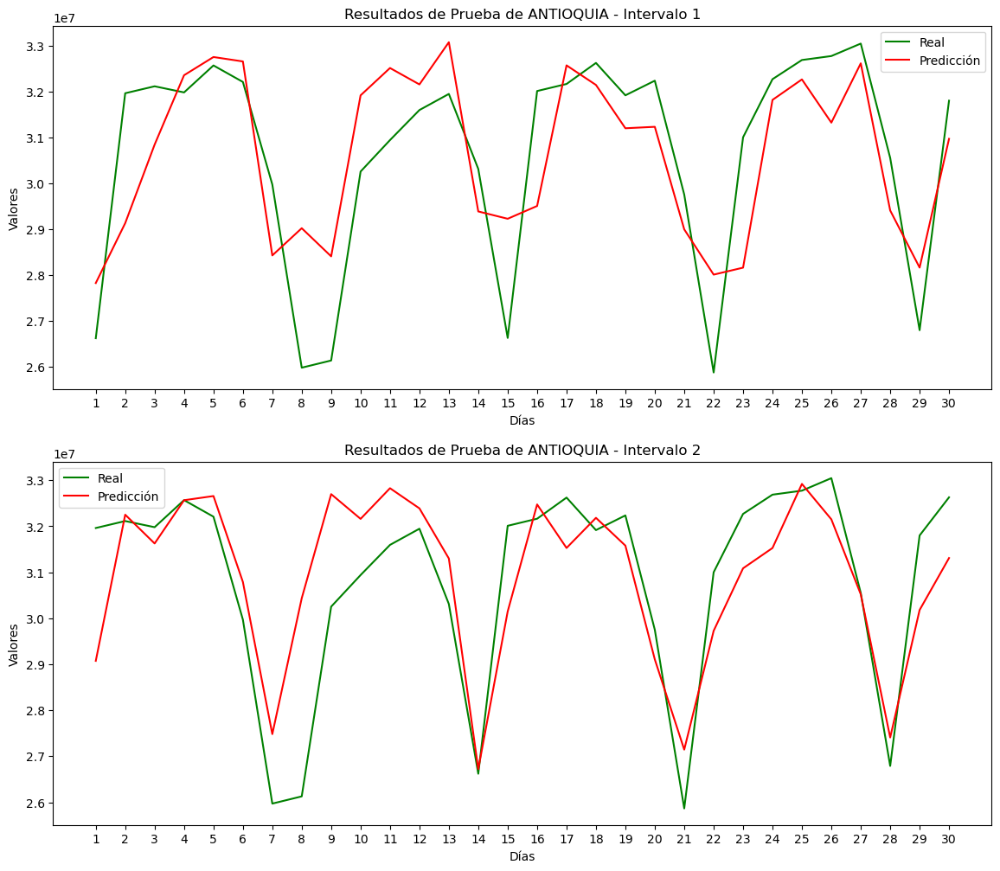

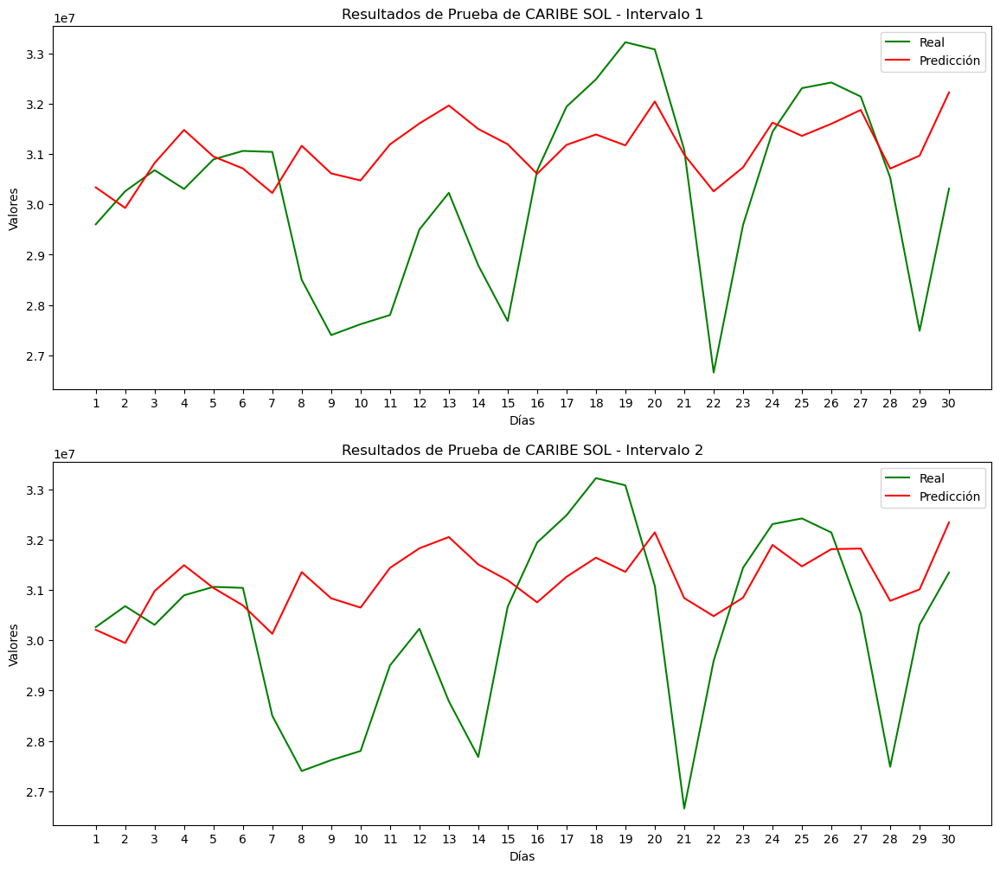

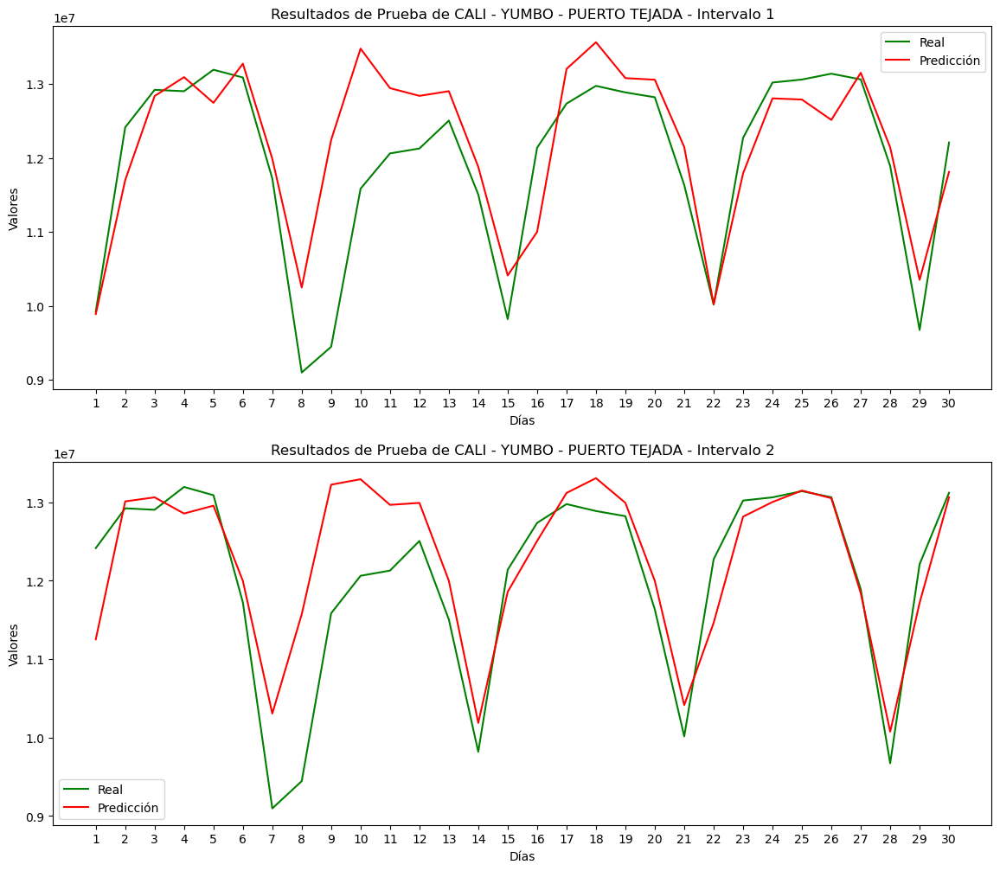

...

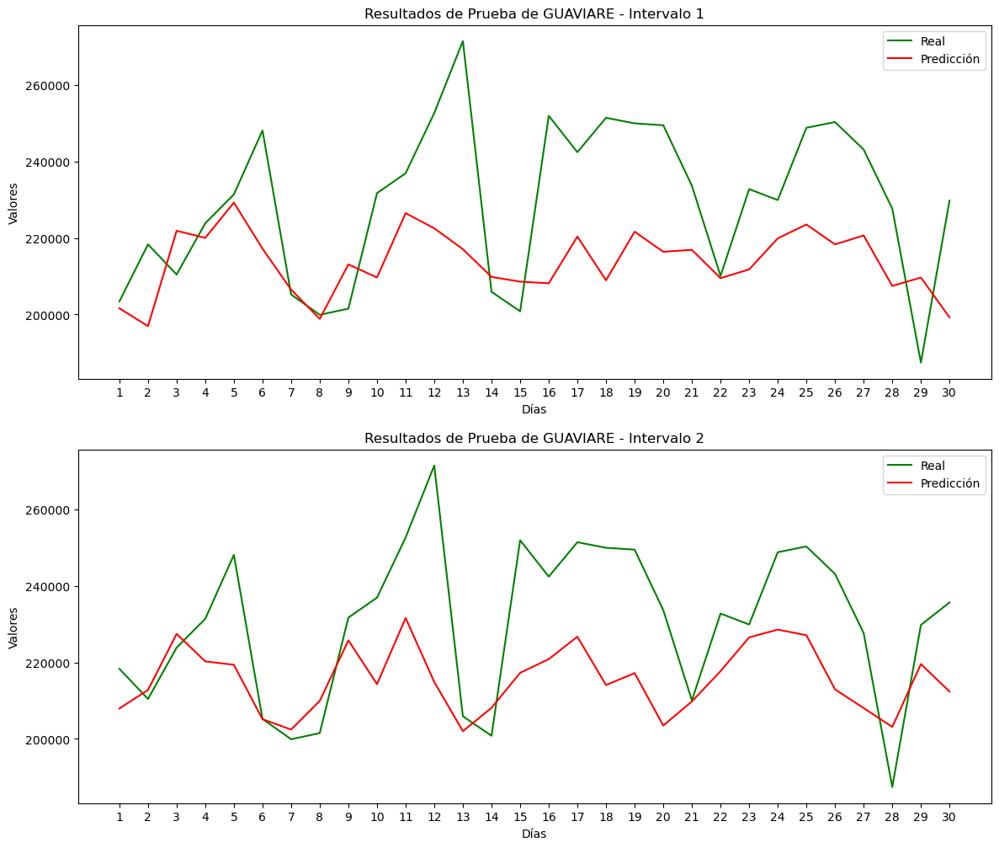

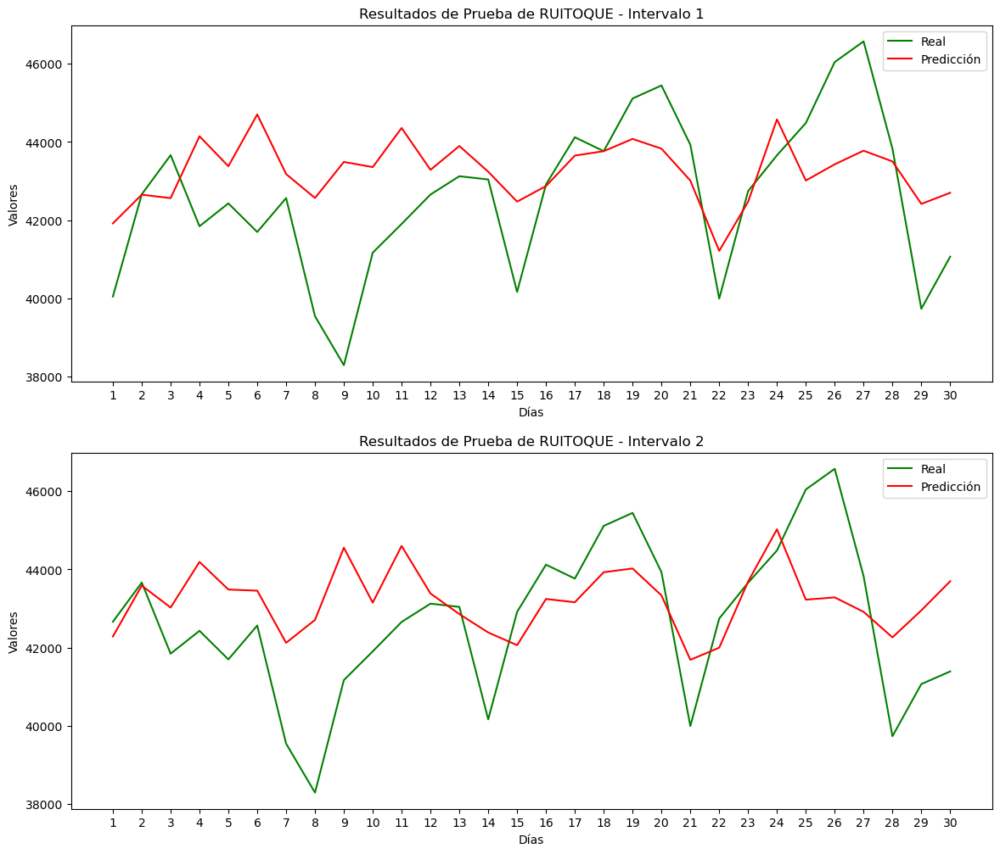

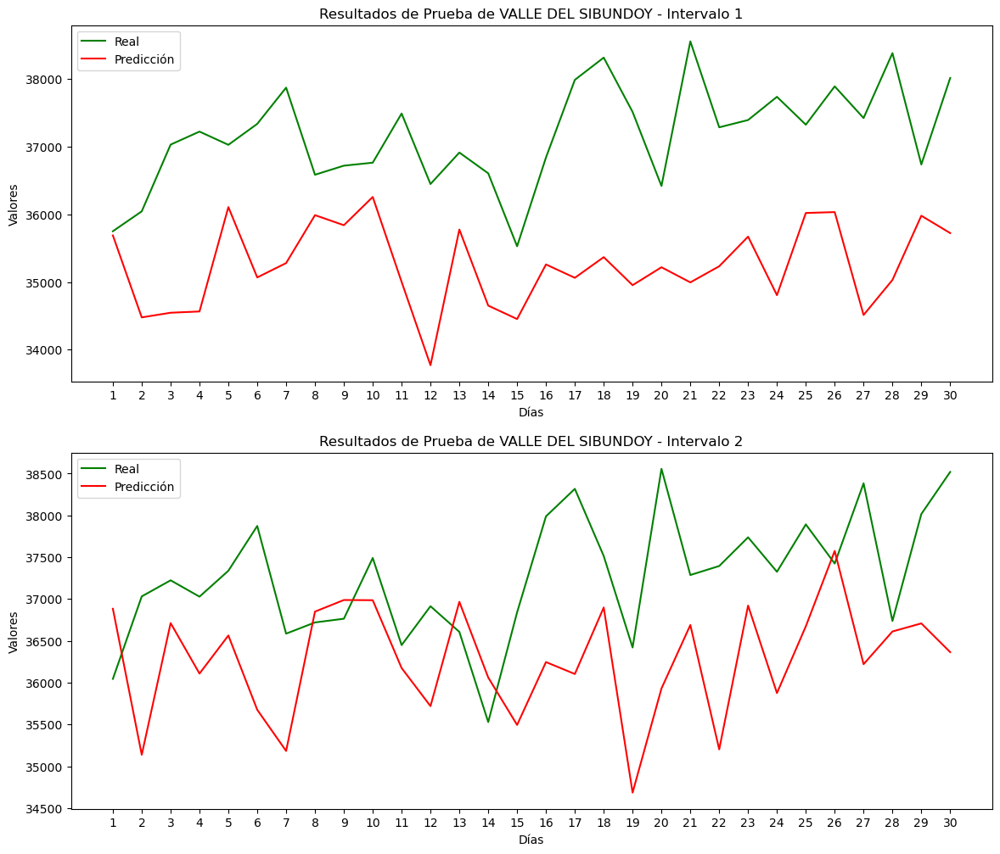

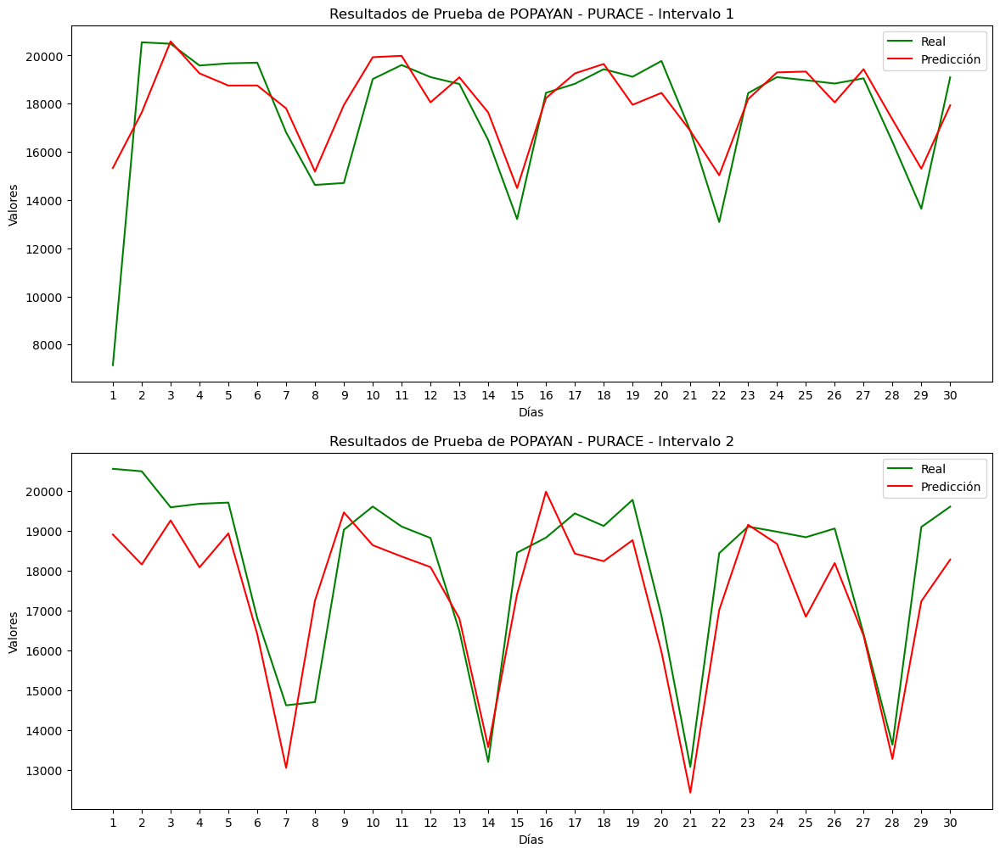

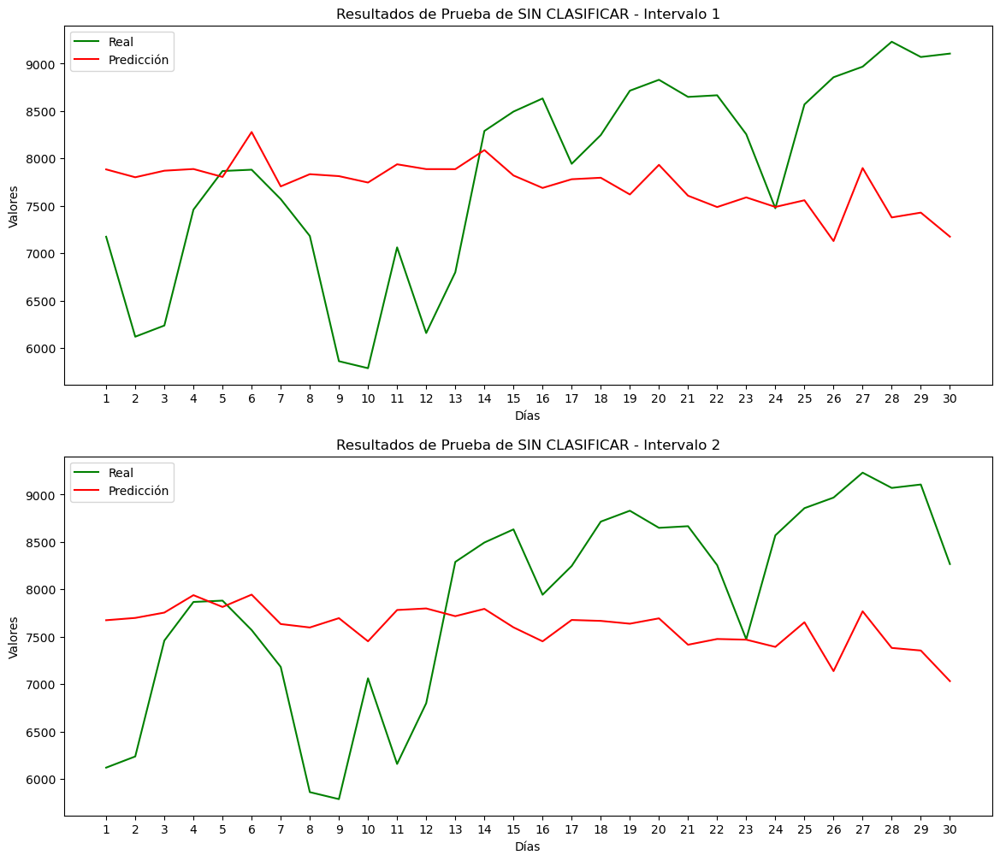

In [ ]:
for i in top_ciudades:
    j = top_ciudades.index(i)
    calculo_metricas(matriz_modelo[top_ciudades[j]], mejor_modelo[i], ruta=f"./static/metrics/{i}.json")
    guardar_imagenes(matriz_modelo[top_ciudades[j]], mejor_modelo[i], 'Resultados de Prueba', i, 'green', 'red', max_plots=2, ruta=f"./static/imagenes/{i}.png", format="png")

In [40]:
df_demanda

,Id,Values_code,Values_MarketType,Values_Hour01,Values_Hour02,Values_Hour03,Values_Hour04,Values_Hour05,Values_Hour06,Values_Hour07,...,Values_Hour17,Values_Hour18,Values_Hour19,Values_Hour20,Values_Hour21,Values_Hour22,Values_Hour23,Values_Hour24,Date,Total
0,MercadoComercializacion,ANTIOQUIA,NO REGULADO,349886.48,349905.59,346123.47,343345.25,348379.97,354034.69,344095.67,...,334811.35,317993.31,337670.89,324738.84,310200.22,294013.40,284725.85,281685.94,2024-10-12,8066362.72
1,MercadoComercializacion,ANTIOQUIA,REGULADO,707721.11,660481.20,637402.95,629450.09,654538.81,692805.27,774391.54,...,1018159.74,1017339.24,1081872.32,1065654.79,1011911.91,941329.93,859420.89,781332.85,2024-10-12,21674553.45
2,MercadoComercializacion,ARAUCA,NO REGULADO,91036.91,91590.62,91659.21,91489.46,91490.58,91216.39,90950.01,...,92528.85,92751.55,92631.76,93495.21,94211.71,94155.10,93672.21,93592.85,2024-10-12,2216950.49
3,MercadoComercializacion,ARAUCA,REGULADO,38565.24,35412.12,34168.77,32972.37,32446.60,30796.52,30920.05,...,38780.21,39839.09,43575.74,43956.48,43686.89,40872.81,37321.19,35699.89,2024-10-12,907668.67
4,MercadoComercializacion,BAJO PUTUMAYO,NO REGULADO,177.33,190.67,223.32,145.79,193.25,176.79,169.23,...,233.24,209.82,205.00,199.57,200.19,161.84,150.07,148.43,2024-10-12,5009.33
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78361,MercadoComercializacion,TULUA,NO REGULADO,6724.49,6768.58,7155.24,7191.53,7188.43,7088.42,7457.83,...,8772.95,8986.19,8707.40,8063.86,8054.62,7513.59,7124.25,7129.52,2021-01-30,185050.97
78362,MercadoComercializacion,TULUA,REGULADO,18390.38,17151.86,16335.97,15906.30,15975.03,16326.97,14961.11,...,23980.63,23290.82,25425.79,27203.33,26087.47,25008.88,22982.94,20528.09,2021-01-30,511240.84
78363,MercadoComercializacion,VALLE DEL CAUCA,NO REGULADO,140214.79,139195.75,135068.54,135036.53,133085.87,131396.81,123297.54,...,128185.13,126952.77,133716.06,132256.19,129859.09,123826.92,119728.54,115191.51,2021-01-30,3112450.67
78364,MercadoComercializacion,VALLE DEL CAUCA,REGULADO,137699.15,128748.65,123197.02,121009.42,120629.68,124766.35,133469.98,...,193627.53,188065.57,196328.77,214746.40,207405.54,196495.13,179530.27,157734.66,2021-01-30,4104754.50


In [41]:
matriz_modelo['ANTIOQUIA']

,fe-1,d-1,t-1,fe-2,d-2,t-2,fe-3,d-3,t-3,fe-4,...,r-27,fe-88,d-88,r-28,fe-89,d-89,r-29,fe-90,d-90,r-30
0,1,4,19727162.18,0,5,21347232.04,0,6,22341657.39,0,...,24327810.66,0,0,28631930.20,0,1,29254290.77,0,2,28365072.68
1,0,5,21347232.04,0,6,22341657.39,0,0,26743404.23,0,...,28631930.20,0,1,29254290.77,0,2,28365072.68,1,3,23777623.01
2,0,6,22341657.39,0,0,26743404.23,0,1,27449375.65,0,...,29254290.77,0,2,28365072.68,1,3,23777623.01,1,4,21672313.28
3,0,0,26743404.23,0,1,27449375.65,0,2,27704951.26,0,...,28365072.68,1,3,23777623.01,1,4,21672313.28,0,5,23196616.81
4,0,1,27449375.65,0,2,27704951.26,0,3,27687397.70,0,...,23777623.01,1,4,21672313.28,0,5,23196616.81,0,6,23173731.79
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1273,0,3,30626218.53,0,4,30307634.51,0,5,28767680.05,0,...,30855631.61,0,6,26663537.61,0,0,31895413.71,0,1,32893159.84
1274,0,4,30307634.51,0,5,28767680.05,0,6,25238821.82,1,...,26663537.61,0,0,31895413.71,0,1,32893159.84,0,2,32734016.50
1275,0,5,28767680.05,0,6,25238821.82,1,0,25421770.50,0,...,31895413.71,0,1,32893159.84,0,2,32734016.50,0,3,32185419.82
1276,0,6,25238821.82,1,0,25421770.50,0,1,30347331.50,0,...,32893159.84,0,2,32734016.50,0,3,32185419.82,0,4,31752295.56
